In [1]:
%matplotlib inline
import mne
import os
import pyedflib
import pandas as pd
import numpy as np
import seaborn as sns
from mne.io import read_raw_edf, RawArray, concatenate_raws
from mne.stats import permutation_cluster_1samp_test as pcluster_test
import warnings
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm
import autoreject
from autoreject import get_rejection_threshold
from mne.decoding import CSP
from sklearn.model_selection import train_test_split, cross_val_score
import pywt
from scipy.stats import pointbiserialr
from math import sqrt

from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC 
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.naive_bayes import GaussianNB

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D,MaxPooling2D, Flatten
from tensorflow.keras import datasets, layers, models

import mrmr
from mrmr import mrmr_classif

from torch.utils.data import DataLoader, TensorDataset
import torch
from torch import nn

In [2]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

In [3]:
def load_data(subject_id:list, task_id:list, montage_name:str):
    dataset_path = "Online Dataset/eeg-motor-movementimagery-dataset-1.0.0/files"

    # --- Full Path ---
    filenames = []
    for i in range(len(subject_id)):
        for j in range(len(task_id)):
            filenames.append("S"+subject_id[i]+"/S"+subject_id[i]+"R"+task_id[j]+".edf")
            
    path = [os.path.join(dataset_path, filename).replace("\\", "/") for filename in filenames]

    # --- Read EDF Files ---
    subject_raws = []
    for file_path in path:
        with warnings.catch_warnings():
            warnings.filterwarnings("ignore", category=RuntimeWarning)
            data = mne.io.read_raw_edf(file_path, preload=True, verbose=False)
        subject_raws.append(data)

    # print("Path:",path)
    raws_data = concatenate_raws(subject_raws)
    # print("RawEDF data:", raws_data)

    # --- Check Signal Channels ---
    with pyedflib.EdfReader(path[-1]) as edf_file:
        signal_labels = edf_file.getSignalLabels()
        # print("signal_channels:", signal_labels)
    
    with open("Online Dataset/eeg-motor-movementimagery-dataset-1.0.0/files/wfdbcal", "r") as file:
        content = file.readlines()
    
    chan_name = []
    chan_order = []
    chan_mapping = {}
    order = 1
    for line in content:
        parts = line.split('\t')
        channel_name = parts[0].strip()
        channel_name = channel_name.replace(".", "")
        chan_name.append(channel_name)
        order_name = "# " + str(order)
        chan_order.append(order_name)
        chan_mapping[order_name] = channel_name
        order += 1 

    channel_names = [chan_mapping[f'# {i+1}'] for i in range(64)]
    old_ch_names = raws_data.info['ch_names']

    raws_data.rename_channels({old: new for old, new in zip(old_ch_names, channel_names)})

    # Set montage
    # montage = mne.channels.make_standard_montage('standard_1020')
    raws_data.set_montage(montage = mne.channels.make_standard_montage(montage_name))

    # Plot channel locations
    # raws_data.plot_sensors(show_names=True);
    
    # raws_data.compute_psd().plot_topomap();
    # raws_data.compute_psd().plot();
    
    return raws_data

In [4]:
def preprocessing(raws_data, event, chans_selected:list):
    # --- Apply Re-reference by Common Average Reference (CAR) ---
    streams = raws_data.copy().set_eeg_reference('average', projection=True)
    streams.apply_proj()
    
    # --- Filter Data ---
    stream_filter = streams.copy().filter(l_freq=8.0, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'})
    
    # --- Apply ICA ---
    ica = mne.preprocessing.ICA(n_components=63, random_state=97, max_iter=800)
    ica.fit(stream_filter.copy())
    
    # --- Find Bad Components ---
    bad_idx, scores = ica.find_bads_eog(stream_filter.copy(), ch_name='T9', threshold=1.5)
    
    # --- Remove Bad Components ---
    ica.exclude = bad_idx
    
    # --- Apply ICA to Filtered Data ---
    stream_ica = ica.apply(stream_filter.copy(),exclude=ica.exclude)
    
    # --- Events ---
    events, event_dict = mne.events_from_annotations(stream_filter)
    
    # --- Epoch ---
    epochs = mne.Epochs(stream_ica.copy().filter(l_freq=8, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'}), events, tmin = -0.5, tmax = 4, 
                    event_id = event, preload= True, verbose=False, event_repeated='drop')
    
    # --- Selected channels are interested ---
    epochs = epochs.pick_channels(chans_selected)
    
    # --- Baseline Correction ---
    Baseline = epochs.copy().filter(l_freq=8.0, h_freq=15.0, method = 'iir', iir_params= {"order": 6, "ftype":'butter'})
    stream_mi = Baseline.copy().apply_baseline((-0.5, 0))
    
    # --- reject bad channels ---
    def autoreject_epochs(epochs):
        reject = get_rejection_threshold(epochs)  
        reject.update(reject)
        epochs.drop_bad(reject = reject)
        return epochs
    stream_mi = autoreject_epochs(stream_mi.copy())
    
    return stream_mi

In [5]:
def extract_CSP(epochs, n_component = 7):
    X = epochs.get_data()
    y = epochs.events[:, -1]
    
    # Initilize CSP
    csp = CSP(n_components = n_component, norm_trace=False)
    csp_wt = CSP(n_components = n_component, reg=None, log=None, norm_trace=False, transform_into='csp_space')
    
    # Fit CSP to data 
    csp.fit(X, y)
    csp_wt.fit(X, y)
    
    new_data = csp_wt.transform(X)
    
    # Visualize CSP patterns
    csp.plot_patterns(epochs.info);
    print(csp)
    return X, y, csp, csp_wt, new_data

In [6]:
def extract_WT(epochs, target , n_component = 7):
    epochs_data = epochs.get_data()
    labels = epochs.events[:,-1]
    
    train_size = len(labels)
    train_data_cwt = np.ndarray(shape=(train_size ,epochs_data.shape[1] , 8, epochs_data.shape[2],))
    
    scales = range(8,16)

    X_mi, y_mi, csp, csp_wt, data_csp = extract_CSP(epochs.copy(), n_component)
    
    for ii in range(train_size):
        for jj in range(7):
            signal = data_csp[ii, jj, :]
            coeff, _ = pywt.cwt(signal, scales, 'morl', 1)
            coeff_ = coeff[:, :epochs_data.shape[2]]  # (8,epochs_data.shape[2])
            train_data_cwt[ii, jj, :, :] = np.abs(coeff_)  

    for j in range(4):
        sample = train_data_cwt[j]
        # Create subplots for each channel with a larger figure size
        fig, axs = plt.subplots(1, 7, figsize=(40, 5))  # Increase the width (20) to make the figure larger
        for i in range(7):
            axs[i].imshow(sample[i], aspect='auto', cmap='viridis')
            axs[i].set_title(f'Channel {i+1}')
        fig.suptitle(f'Class {labels[j]}', fontsize=16)
        plt.show()

    wt_shape = train_data_cwt.shape
    data_WT = np.reshape(train_data_cwt,(wt_shape[0],wt_shape[1]*wt_shape[2]*wt_shape[3]))
    
    return train_data_cwt, data_WT, labels, y_mi

In [7]:
def getMerit(subset, label):
    print(subset)
    # average feature-class correlation
    rcf_all = []
    for feature in subset:
        coeff = pointbiserialr( df[label], df[feature] )
        rcf_all.append( abs( coeff.correlation ) )
    rcf = np.mean( rcf_all )

    # average feature-feature correlation
    corr = df[subset].corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    corr = abs(corr)
    rff = corr.unstack().mean()
    
    return (k * rcf) / sqrt(k + k * (k-1) * rff)
    

In [8]:
class PriorityQueue:
    def  __init__(self):
        self.queue = []

    def isEmpty(self):
        return len(self.queue) == 0
    
    def push(self, item, priority):
        for index, (i, p) in enumerate(self.queue):
            if (set(i) == set(item)):
                if (p >= priority):
                    break
                del self.queue[index]
                self.queue.append( (item, priority) )
                break
        else:
            self.queue.append( (item, priority) )
        
    def pop(self):
        # return item with highest priority and remove it from queue
        max_idx = 0
        for index, (i, p) in enumerate(self.queue):
            if (self.queue[max_idx][1] < p):
                max_idx = index
        (item, priority) = self.queue[max_idx]
        del self.queue[max_idx]
        return (item, priority)

In [9]:
def CFS(csp,X_csp,y_csp):
    X_transformed = csp.transform(X_csp)
    df = pd.DataFrame(X_transformed)
    
    # Compute correlation matrix
    corr = df.corr()
    corr.values[np.tril_indices_from(corr.values)] = np.nan
    
    df = df.assign(Class = y_csp)
    
    # name of the label (can be seen in the dataframe)
    label = 'Class'

    # list with feature names (V1, V2, V3, ...)
    features = df.columns.tolist()
    features.remove(label)
    
    best_value = -1
    best_feature = ''
    for feature in features:
        coeff = pointbiserialr( df[label], df[feature] )
        abs_coeff = abs( coeff.correlation )
        if abs_coeff > best_value:
            best_value = abs_coeff
            best_feature = feature

    print("Feature %s with merit %.4f"%(best_feature, best_value))
    
    # initialize queue
    queue = PriorityQueue()

    # push first tuple (subset, merit)
    queue.push([best_feature], best_value)
    
    visited = []
    n_backtrack = 0
    max_backtrack = 5
    
    # repeat until queue is empty
    # or the maximum number of backtracks is reached
    while not queue.isEmpty():
        # get element of queue with highest merit
        subset, priority = queue.pop()
        
        # check whether the priority of this subset
        # is higher than the current best subset
        if (priority < best_value):
            n_backtrack += 1
        else:
            best_value = priority
            best_subset = subset

        # goal condition
        if (n_backtrack == max_backtrack):
            break
        
        # iterate through all features and look of one can
        # increase the merit
        for feature in features:
            temp_subset = subset + [feature]
            
            # check if this subset has already been evaluated
            for node in visited:
                if (set(node) == set(temp_subset)):
                    break
            # if not, ...
            else:
                # ... mark it as visited
                visited.append( temp_subset )
                # ... compute merit
                merit = getMerit(temp_subset, label)
                
                # and push it to the queue
                queue.push(temp_subset, merit)
    
    return best_subset

In [10]:
def mRMR_csp(csp,X_csp,y_csp,k=2):
    # X_transformed = csp.transform(X_csp)
    df = pd.DataFrame(X_csp)
    df = df.assign(Class = y_csp)
    
    # name of the label (can be seen in the dataframe)
    label = 'Class'

    # list with feature names (V1, V2, V3, ...)
    features = df.columns.tolist()
    features.remove(label)
    
    # predictors
    X = df[features].to_numpy()
    X = pd.DataFrame(X)
    # target
    Y = df[label].to_numpy()
    y = pd.Series(Y)

    selected_features = mrmr_classif(X=X, y=y, K=k)
    
    return selected_features

In [11]:
def mRMR_WT(data_WT, y_mi,k):  
    # predictors
    wt_shape = data_WT.shape
    X = pd.DataFrame(data_WT)
    # target
    y = pd.Series(y_mi)

    selected_features = mrmr_classif(X=X, y=y, K=k)
    print(selected_features)
    
    return selected_features

In [12]:
def csp_split(csp,X,y,test_size,random_state,subset:list = [0,1,2,3,4,5,6]):
    X_transformed = csp.transform(X)
    df = pd.DataFrame(X_transformed)

    # Split data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(df[subset], y, test_size=test_size, random_state=random_state, stratify=y)
    
    return X_train, X_test, y_train, y_test

In [13]:
def WT_split(data_WT, y, test_size, random_state, subset=None):
    wt_shape = data_WT.shape
    df = pd.DataFrame(data_WT)
    
    # If subset is None, set it to include all elements
    if subset is None:
        subset = slice(None)  # Equivalent to [:]
    
    # Split data into training and test sets
    X_train, X_test, y_train, y_test = train_test_split(df[subset], y, test_size=test_size, random_state=random_state, stratify=y)
    
    return X_train, X_test, y_train, y_test

In [14]:
def report(y_test, y_pred, results, target = ['left','right']):
    accuracy = accuracy_score(y_test, y_pred)
    results[0].append(accuracy)
    precision = precision_score(y_test, y_pred, average='weighted')
    results[1].append(precision)
    recall = recall_score(y_test, y_pred, average='weighted')
    results[2].append(recall)
    f1 = f1_score(y_test, y_pred, average='weighted')
    results[3].append(f1)
    print(f"Accuracy: {accuracy}")
    print(f"precision: {precision}")
    print(f"recall: {recall}")
    print(f"f1_score: {f1}")
    
    report = classification_report(y_test, y_pred, target_names=target)  
    print(report)
    print("Confusion matrix \n=======================")
    print(confusion_matrix(y_true=y_test, y_pred=y_pred))
    
    return results

In [15]:
def svm(X_train, X_test, y_train, y_test, target,results_train, results_test, kernel='linear',gamma = 'auto'):
    print("============ Support Vector Machine (SVM) kernel("+kernel+") gamma("+str(gamma)+") ============")
    clf = Pipeline([('SVM', SVC(kernel=kernel, gamma=gamma))])  
    clf.fit(X_train, y_train)
    ytrain_pred = clf.predict(X_train)
    y_pred = clf.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [16]:
def lda(X_train, X_test, y_train, y_test, target,results_train, results_test):
    print("============ Linear Discriminant Analysis (LDA) ============")
    clf = Pipeline([('LDA', LDA())])
    clf.fit(X_train, y_train)

    ytrain_pred = clf.predict(X_train)
    y_pred = clf.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [17]:
# Create and fit the logistic regression model within a pipeline
def logistic_regression(X_train, X_test, y_train, y_test, target,results_train, results_test):
    print("============ logistic_regression ============")
    clf = Pipeline([('LR', LogisticRegression())])
    clf.fit(X_train, y_train)
    
    # Predict and calculate accuracy
    ytrain_pred = clf.predict(X_train)
    y_pred = clf.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [18]:
def naive(X_train, X_test, y_train, y_test, target,results_train, results_test):
    print("============ naive bayes ============")
    model = GaussianNB()
    model.fit(X_train, y_train)
    
    ytrain_pred = model.predict(X_train)
    y_pred = model.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [19]:
def knn(X_train, X_test, y_train, y_test, target, results_train, results_test):
    print("============ K-Nearest Neighbors (KNN) ============")
    clf = KNeighborsClassifier(n_neighbors=3)
    clf.fit(X_train, y_train)

    ytrain_pred = clf.predict(X_train)
    y_pred = clf.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [20]:
def mlp(X_train, X_test, y_train, y_test, target,results_train, results_test, solver='lbfgs', hidden_layer_sizes=(50, 4), random_state=3, max_iter=210):
    print("============ Multi-layer Perceptron (MLP) ============")
    clf = MLPClassifier(solver='lbfgs', hidden_layer_sizes=(50, 4), random_state=3, max_iter=210)
    clf.fit(X_train, y_train)

    ytrain_pred = clf.predict(X_train)
    y_pred = clf.predict(X_test)
    print("--------------Training set:--------------")
    results_train = report(y_train, ytrain_pred,results_train, target)
    print("----------------Test set:----------------")
    results_test = report(y_test, y_pred,results_test, target)
    print()
    return results_train, results_test

In [21]:
def nn_fit(X_train, X_test, y_train, y_test, model, epochs, batch_size):
    y_train_encoded = pd.get_dummies(y_train, columns=[1, 2])
    y_test_encoded = pd.get_dummies(y_test, columns=[1, 2])
    
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    history = model.fit(X_train, y_train_encoded, validation_data=(X_test, y_test_encoded), epochs=epochs, batch_size=batch_size)
    
    score_train = model.evaluate(X_train, y_train_encoded, verbose=0)
    print("Train loss:", score_train[0])
    print("Train accuracy:", score_train[1])
    
    return y_train_encoded,y_test_encoded,history,model

In [22]:
def nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target,results_train, results_test, numclass , model):
    
    actual_classes_str = pd.get_dummies(y_test_encoded).idxmax(1)
    actual_classes_str = pd.DataFrame(actual_classes_str, index=y_test_encoded.index)
    
    actual_classes_str_train = pd.get_dummies(y_train_encoded).idxmax(1)
    actual_classes_str_train = pd.DataFrame(actual_classes_str_train, index=y_train_encoded.index)
    #Predictions on the test set
    predicted_classes = np.argmax(model.predict(X_test),axis=1)
    predicted_classes_str = []
    
    predicted_classes_train = np.argmax(model.predict(X_train),axis=1)
    predicted_classes_str_train = []
    
    for i in predicted_classes:
        if len(numclass) == 2:
            if i == 0:
                predicted_classes_str.append(numclass[0])
            else:
                predicted_classes_str.append(numclass[1])
        elif len(numclass) == 3:
            if i == 0:
                predicted_classes_str.append(numclass[0])
            elif i == 1:
                predicted_classes_str.append(numclass[1])
            elif i == 2:
                predicted_classes_str.append(numclass[2])
    
    for i in predicted_classes_train:
        if len(numclass) == 2:
            if i == 0:
                predicted_classes_str_train.append(numclass[0])
            else:
                predicted_classes_str_train.append(numclass[1])
        elif len(numclass) == 3:
            if i == 0:
                predicted_classes_str_train.append(numclass[0])
            elif i == 1:
                predicted_classes_str_train.append(numclass[1])
            elif i == 2:
                predicted_classes_str_train.append(numclass[2])
    
    predicted_classes_str = pd.DataFrame(predicted_classes_str,index=y_test_encoded.index)
    predicted_classes_str_train = pd.DataFrame(predicted_classes_str_train,index=y_train_encoded.index)

    print("--------------Training set:--------------")
    result_train = report(actual_classes_str_train, predicted_classes_str_train,results_train,target)
    
    print("----------------Test set:----------------")
    result_test = report(actual_classes_str, predicted_classes_str,results_test,target)
    
    score = model.evaluate(X_test, y_test_encoded, verbose=0)
    print("Test loss:", score[0])
    print("Test accuracy:", score[1])
    
    # plotting the metrics
    plt.figure(figsize=(10, 7))
    plt.subplot(2,1,1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='lower right')

    plt.subplot(2,1,2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper right')
    plt.tight_layout()
    
    return result_train,result_test

## **rest left right**

In [23]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['rest','left','right']
numclass = [1,2,3]

In [24]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 7

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating reject

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

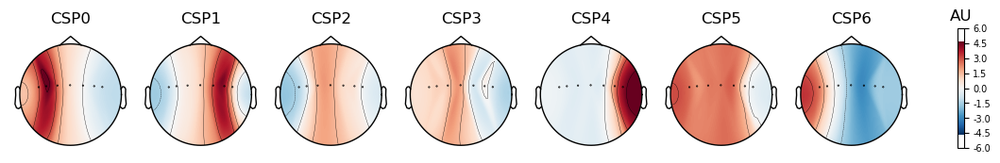

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [25]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [26]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [27]:
result_train = [[],[],[],[]]
result_test = [[],[],[],[]]

In [28]:
result_train,result_test = svm(X_train, X_test, y_train, y_test, target,result_train,result_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6830426658361881
recall: 0.6730769230769231
f1_score: 0.6550716440422323
              precision    recall  f1-score   support

        rest       0.69      0.72      0.71        25
        left       0.71      0.36      0.48        14
       right       0.63      0.92      0.75        13

    accuracy                           0.67        52
   macro avg       0.68      0.67      0.64        52
weighted avg       0.68      0.67      0.66        52

Confusion matrix 
[[18  2  5]
 [ 7  5  2]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.643916797488226
recall: 0.6285714285714286
f1_score: 0.6215710632078918
              precision    recall  f1-score   support

        rest       0.69      0.53      0.60        17
        left       0.62      0.56      0.59         9
      

In [29]:
result_train,result_test = lda(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.75
precision: 0.7482037193575656
recall: 0.75
f1_score: 0.7485754985754985
              precision    recall  f1-score   support

        rest       0.76      0.76      0.76        25
        left       0.69      0.64      0.67        14
       right       0.79      0.85      0.81        13

    accuracy                           0.75        52
   macro avg       0.75      0.75      0.75        52
weighted avg       0.75      0.75      0.75        52

Confusion matrix 
[[19  4  2]
 [ 4  9  1]
 [ 2  0 11]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.631968031968032
recall: 0.6
f1_score: 0.5954730983302412
              precision    recall  f1-score   support

        rest       0.73      0.47      0.57        17
        left       0.55      0.67      0.60         9
       right       0.54      0.78      0.64         9

    accuracy                  

In [30]:
result_train,result_test = logistic_regression(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.7115384615384616
precision: 0.7167127534774593
recall: 0.7115384615384616
f1_score: 0.6981845077998924
              precision    recall  f1-score   support

        rest       0.70      0.76      0.73        25
        left       0.75      0.43      0.55        14
       right       0.71      0.92      0.80        13

    accuracy                           0.71        52
   macro avg       0.72      0.70      0.69        52
weighted avg       0.72      0.71      0.70        52

Confusion matrix 
[[19  2  4]
 [ 7  6  1]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.5703571428571428
recall: 0.5714285714285714
f1_score: 0.5701982228298017
              precision    recall  f1-score   support

        rest       0.56      0.53      0.55        17
        left       0.56      0.56      0.56         9
       right       0.60      0.67      0.

In [31]:
result_train,result_test = naive(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.7307692307692307
precision: 0.7303167420814479
recall: 0.7307692307692307
f1_score: 0.7224358974358975
              precision    recall  f1-score   support

        rest       0.76      0.76      0.76        25
        left       0.70      0.50      0.58        14
       right       0.71      0.92      0.80        13

    accuracy                           0.73        52
   macro avg       0.72      0.73      0.71        52
weighted avg       0.73      0.73      0.72        52

Confusion matrix 
[[19  3  3]
 [ 5  7  2]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.5347763347763348
recall: 0.5142857142857142
f1_score: 0.5175510204081633
              precision    recall  f1-score   support

        rest       0.56      0.59      0.57        17
        left       0.67      0.44      0.53         9
       right       0.36      0.44      0.40      

In [32]:
result_train,result_test = knn(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6588319088319088
recall: 0.6730769230769231
f1_score: 0.6474438506076223
              precision    recall  f1-score   support

        rest       0.70      0.76      0.73        25
        left       0.57      0.29      0.38        14
       right       0.67      0.92      0.77        13

    accuracy                           0.67        52
   macro avg       0.65      0.66      0.63        52
weighted avg       0.66      0.67      0.65        52

Confusion matrix 
[[19  3  3]
 [ 7  4  3]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.7142857142857143
precision: 0.7685400313971743
recall: 0.7142857142857143
f1_score: 0.7204761904761905
              precision    recall  f1-score   support

        rest       0.85      0.65      0.73        17
        left       0.86      0.67      0.75         9
       right       0.53      0.89  

In [33]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=7, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(3, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32)                256       
                                                                 
 dense_1 (Dense)             (None, 8)                 264       
                                                                 
 dense_2 (Dense)             (None, 3)                 27        
                                                                 
Total params: 547
Trainable params: 547
Non-trainable params: 0
_________________________________________________________________


In [34]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 839ms/step - loss: 1.1300 - accuracy: 0.3654 - val_loss: 1.1498 - val_accuracy: 0.2857
Epoch 2/50
1/1 [==============================] - 0s 36ms/step - loss: 1.1245 - accuracy: 0.3654 - val_loss: 1.1464 - val_accuracy: 0.3143
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 1.1191 - accuracy: 0.3462 - val_loss: 1.1432 - val_accuracy: 0.3143
Epoch 4/50
1/1 [==============================] - 0s 34ms/step - loss: 1.1139 - accuracy: 0.3462 - val_loss: 1.1399 - val_accuracy: 0.3143
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 1.1088 - accuracy: 0.3654 - val_loss: 1.1368 - val_accuracy: 0.3429
Epoch 6/50
1/1 [==============================] - 0s 36ms/step - loss: 1.1037 - accuracy: 0.3654 - val_loss: 1.1339 - val_accuracy: 0.3143
Epoch 7/50
1/1 [==============================] - 0s 35ms/step - loss: 1.0987 - accuracy: 0.3462 - val_loss: 1.1310 - val_accuracy: 0.3143
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 3ms/step
--------------Training set:--------------
Accuracy: 0.5384615384615384
precision: 0.6354515050167223
recall: 0.5384615384615384
f1_score: 0.4515228120861923
              precision    recall  f1-score   support

        rest       0.52      0.96      0.68        25
        left       0.50      0.14      0.22        14
       right       1.00      0.15      0.27        13

    accuracy                           0.54        52
   macro avg       0.67      0.42      0.39        52
weighted avg       0.64      0.54      0.45        52

Confusion matrix 
[[24  1  0]
 [12  2  0]
 [10  1  2]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.4959183673469388
recall: 0.5142857142857142
f1_score: 0.4490842490842491
              precision    recall  f1-score   support

        rest       0.54      0.88      0.67        17
        left       0.25      0.11      0.15         9
       right       0.67      0.22   

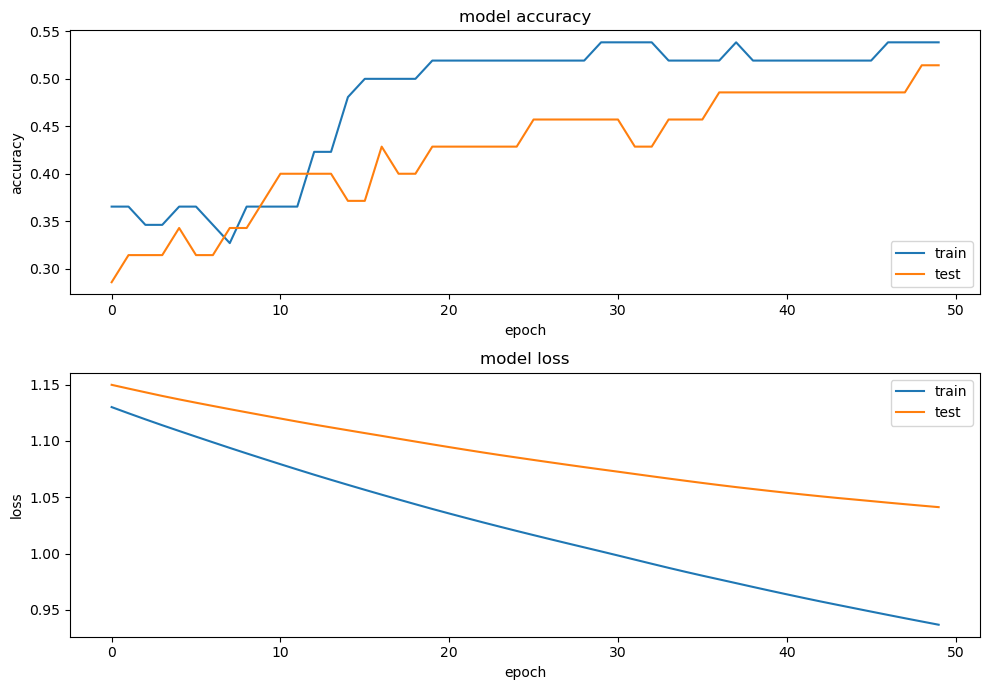

In [35]:
result_train,result_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target,result_train,result_test, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

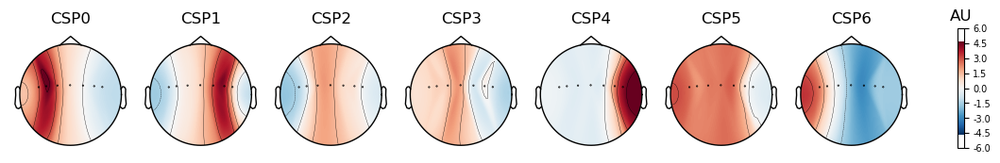

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [36]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [37]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [38]:
result_train,result_test = svm(X_train, X_test, y_train, y_test, target, result_train,result_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.5961538461538461
precision: 0.5801790801790802
recall: 0.5961538461538461
f1_score: 0.5506487604903895
              precision    recall  f1-score   support

        rest       0.63      0.68      0.65        25
        left       0.50      0.14      0.22        14
       right       0.57      0.92      0.71        13

    accuracy                           0.60        52
   macro avg       0.57      0.58      0.53        52
weighted avg       0.58      0.60      0.55        52

Confusion matrix 
[[17  2  6]
 [ 9  2  3]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.4914285714285714
recall: 0.4857142857142857
f1_score: 0.4646187146187145
              precision    recall  f1-score   support

        rest       0.50      0.47      0.48        17
        left       0.50      0.22      0.31         9
     

In [39]:
result_train,result_test = lda(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.6153846153846154
precision: 0.6080806213017751
recall: 0.6153846153846154
f1_score: 0.6067184168096946
              precision    recall  f1-score   support

        rest       0.69      0.72      0.71        25
        left       0.50      0.36      0.42        14
       right       0.56      0.69      0.62        13

    accuracy                           0.62        52
   macro avg       0.58      0.59      0.58        52
weighted avg       0.61      0.62      0.61        52

Confusion matrix 
[[18  3  4]
 [ 6  5  3]
 [ 2  2  9]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.5703571428571428
recall: 0.5714285714285714
f1_score: 0.5701982228298017
              precision    recall  f1-score   support

        rest       0.56      0.53      0.55        17
        left       0.56      0.56      0.56         9
       right       0.60   

In [40]:
result_train,result_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.6153846153846154
precision: 0.6127247273798998
recall: 0.6153846153846154
f1_score: 0.5829524182665099
              precision    recall  f1-score   support

        rest       0.62      0.72      0.67        25
        left       0.60      0.21      0.32        14
       right       0.61      0.85      0.71        13

    accuracy                           0.62        52
   macro avg       0.61      0.59      0.56        52
weighted avg       0.61      0.62      0.58        52

Confusion matrix 
[[18  2  5]
 [ 9  3  2]
 [ 2  0 11]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.487218045112782
recall: 0.4857142857142857
f1_score: 0.4810526315789474
              precision    recall  f1-score   support

        rest       0.47      0.53      0.50        17
        left       0.50      0.33      0.40         9
       right       0.50      0.56      0.5

In [41]:
result_train,result_test = naive(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.6538461538461539
precision: 0.669884771099346
recall: 0.6538461538461539
f1_score: 0.6394466440422323
              precision    recall  f1-score   support

        rest       0.69      0.72      0.71        25
        left       0.71      0.36      0.48        14
       right       0.58      0.85      0.69        13

    accuracy                           0.65        52
   macro avg       0.66      0.64      0.62        52
weighted avg       0.67      0.65      0.64        52

Confusion matrix 
[[18  2  5]
 [ 6  5  3]
 [ 2  0 11]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.5406802721088435
recall: 0.5142857142857142
f1_score: 0.5141614906832298
              precision    recall  f1-score   support

        rest       0.53      0.47      0.50        17
        left       0.67      0.44      0.53         9
       right       0.43      0.67      0.52       

In [42]:
result_train,result_test = knn(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6923076923076923
precision: 0.6896812678062678
recall: 0.6923076923076923
f1_score: 0.6814547607852878
              precision    recall  f1-score   support

        rest       0.70      0.76      0.73        25
        left       0.67      0.43      0.52        14
       right       0.69      0.85      0.76        13

    accuracy                           0.69        52
   macro avg       0.69      0.68      0.67        52
weighted avg       0.69      0.69      0.68        52

Confusion matrix 
[[19  3  3]
 [ 6  6  2]
 [ 2  0 11]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.479421768707483
recall: 0.4857142857142857
f1_score: 0.47481645289694824
              precision    recall  f1-score   support

        rest       0.52      0.65      0.58        17
        left       0.50      0.33      0.40         9
       right       0.38      0.33  

In [43]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 32)                96        
                                                                 
 dense_4 (Dense)             (None, 16)                528       
                                                                 
 dense_5 (Dense)             (None, 8)                 136       
                                                                 
 dense_6 (Dense)             (None, 3)                 27        
                                                                 
Total params: 787
Trainable params: 787
Non-trainable params: 0
_________________________________________________________________


In [44]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 631ms/step - loss: 1.1775 - accuracy: 0.1923 - val_loss: 1.1642 - val_accuracy: 0.2286
Epoch 2/100
1/1 [==============================] - 0s 49ms/step - loss: 1.1706 - accuracy: 0.1923 - val_loss: 1.1598 - val_accuracy: 0.2571
Epoch 3/100
1/1 [==============================] - 0s 49ms/step - loss: 1.1645 - accuracy: 0.1923 - val_loss: 1.1559 - val_accuracy: 0.2571
Epoch 4/100
1/1 [==============================] - 0s 42ms/step - loss: 1.1588 - accuracy: 0.1923 - val_loss: 1.1523 - val_accuracy: 0.2571
Epoch 5/100
1/1 [==============================] - 0s 36ms/step - loss: 1.1533 - accuracy: 0.2115 - val_loss: 1.1489 - val_accuracy: 0.2571
Epoch 6/100
1/1 [==============================] - 0s 35ms/step - loss: 1.1481 - accuracy: 0.2115 - val_loss: 1.1456 - val_accuracy: 0.2857
Epoch 7/100
1/1 [==============================] - 0s 37ms/step - loss: 1.1431 - accuracy: 0.2308 - val_loss: 1.1425 - val_accuracy: 0.2857
Epoch 8/100
1/1 [==

2/2 [==============================] - 0s 4ms/step
--------------Training set:--------------
Accuracy: 0.6538461538461539
precision: 0.6872469635627529
recall: 0.6538461538461539
f1_score: 0.6499950049950051
              precision    recall  f1-score   support

        rest       0.79      0.60      0.68        25
        left       0.64      0.50      0.56        14
       right       0.55      0.92      0.69        13

    accuracy                           0.65        52
   macro avg       0.66      0.67      0.64        52
weighted avg       0.69      0.65      0.65        52

Confusion matrix 
[[15  4  6]
 [ 3  7  4]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.5836363636363636
recall: 0.5714285714285714
f1_score: 0.5523947550034508
              precision    recall  f1-score   support

        rest       0.60      0.35      0.44        17
        left       0.64      0.78      0.70         9
       right       0.50      0.78   

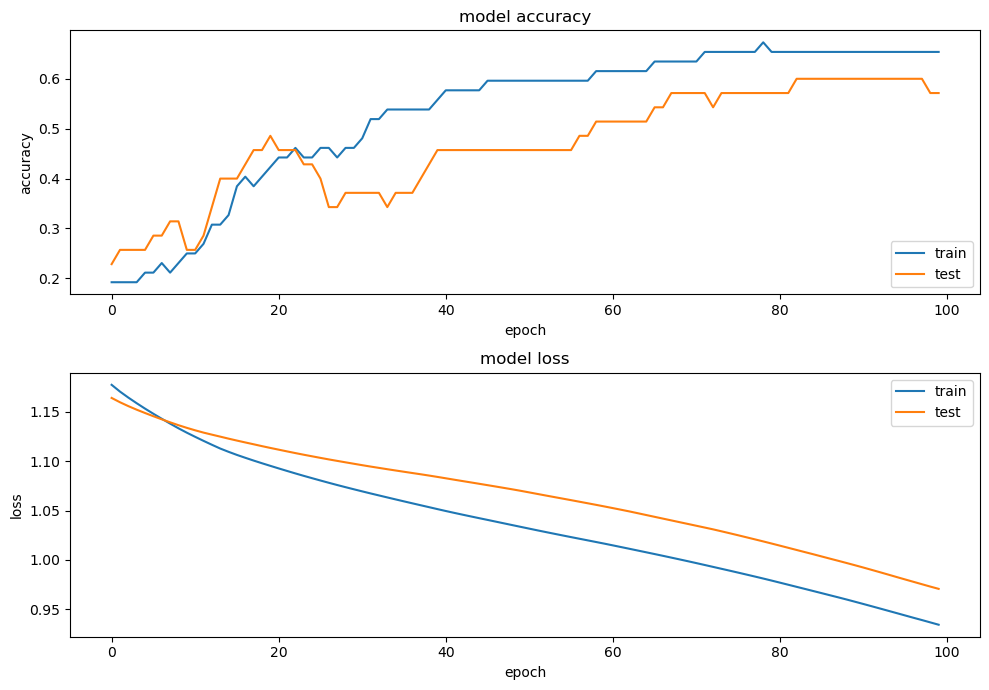

In [45]:
result_train,result_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_train,result_test, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

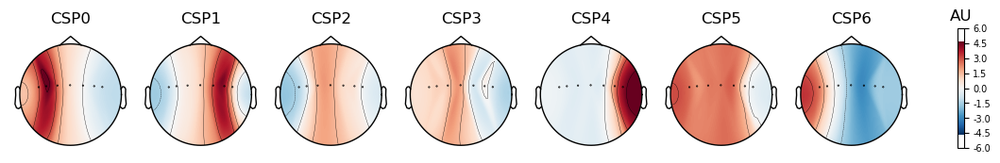

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [46]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [47]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [48]:
subset = mRMR_csp(csp,np.array(X_train),np.array(y_train),k=2)
subset

X_train, X_test = X_train[subset], X_test[subset]

100%|██████████| 2/2 [00:01<00:00,  1.51it/s]


In [49]:
result_train,result_test = svm(X_train, X_test, y_train, y_test, target,result_train,result_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.6153846153846154
precision: 0.45048076923076924
recall: 0.6153846153846154
f1_score: 0.5192000981474666
              precision    recall  f1-score   support

        rest       0.62      0.80      0.70        25
        left       0.00      0.00      0.00        14
       right       0.60      0.92      0.73        13

    accuracy                           0.62        52
   macro avg       0.41      0.57      0.48        52
weighted avg       0.45      0.62      0.52        52

Confusion matrix 
[[20  0  5]
 [11  0  3]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.3628571428571428
recall: 0.4857142857142857
f1_score: 0.4125482625482625
              precision    recall  f1-score   support

        rest       0.50      0.59      0.54        17
        left       0.00      0.00      0.00         9
    

In [50]:
result_train,result_test = lda(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.5769230769230769
precision: 0.46654001240694787
recall: 0.5769230769230769
f1_score: 0.5158914361500568
              precision    recall  f1-score   support

        rest       0.61      0.76      0.68        25
        left       0.00      0.00      0.00        14
       right       0.69      0.85      0.76        13

    accuracy                           0.58        52
   macro avg       0.43      0.54      0.48        52
weighted avg       0.47      0.58      0.52        52

Confusion matrix 
[[19  4  2]
 [11  0  3]
 [ 1  1 11]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.5
recall: 0.5142857142857142
f1_score: 0.5012244897959184
              precision    recall  f1-score   support

        rest       0.59      0.59      0.59        17
        left       0.33      0.22      0.27         9
       right       0.50      0.67      0

In [51]:
result_train,result_test = logistic_regression(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.5961538461538461
precision: 0.43611213348055455
recall: 0.5961538461538461
f1_score: 0.5034399867374005
              precision    recall  f1-score   support

        rest       0.61      0.80      0.69        25
        left       0.00      0.00      0.00        14
       right       0.58      0.85      0.69        13

    accuracy                           0.60        52
   macro avg       0.40      0.55      0.46        52
weighted avg       0.44      0.60      0.50        52

Confusion matrix 
[[20  0  5]
 [11  0  3]
 [ 2  0 11]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.37142857142857144
recall: 0.4857142857142857
f1_score: 0.4209314495028781
              precision    recall  f1-score   support

        rest       0.50      0.65      0.56        17
        left       0.00      0.00      0.00         9
       right       0.50      0.67      

In [52]:
result_train,result_test = naive(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6688709840883753
recall: 0.6730769230769231
f1_score: 0.6633240281224152
              precision    recall  f1-score   support

        rest       0.74      0.68      0.71        25
        left       0.55      0.43      0.48        14
       right       0.67      0.92      0.77        13

    accuracy                           0.67        52
   macro avg       0.65      0.68      0.65        52
weighted avg       0.67      0.67      0.66        52

Confusion matrix 
[[17  5  3]
 [ 5  6  3]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.45714285714285713
precision: 0.3500751879699248
recall: 0.45714285714285713
f1_score: 0.39285714285714285
              precision    recall  f1-score   support

        rest       0.47      0.53      0.50        17
        left       0.00      0.00      0.00         9
       right       0.47      0.78      0.58   

In [53]:
result_train,result_test = knn(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.7115384615384616
precision: 0.7135028949545078
recall: 0.7115384615384616
f1_score: 0.7010451505016723
              precision    recall  f1-score   support

        rest       0.68      0.84      0.75        25
        left       0.67      0.43      0.52        14
       right       0.83      0.77      0.80        13

    accuracy                           0.71        52
   macro avg       0.73      0.68      0.69        52
weighted avg       0.71      0.71      0.70        52

Confusion matrix 
[[21  3  1]
 [ 7  6  1]
 [ 3  0 10]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.6465306122448979
recall: 0.6285714285714286
f1_score: 0.5933673469387755
              precision    recall  f1-score   support

        rest       0.60      0.88      0.71        17
        left       0.67      0.22      0.33         9
       right       0.71      0.56  

In [54]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_7 (Dense)             (None, 32)                96        
                                                                 
 dense_8 (Dense)             (None, 16)                528       
                                                                 
 dense_9 (Dense)             (None, 8)                 136       
                                                                 
 dense_10 (Dense)            (None, 3)                 27        
                                                                 
Total params: 787
Trainable params: 787
Non-trainable params: 0
_________________________________________________________________


In [55]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 584ms/step - loss: 1.1014 - accuracy: 0.3077 - val_loss: 1.0982 - val_accuracy: 0.3714
Epoch 2/50
1/1 [==============================] - 0s 33ms/step - loss: 1.0986 - accuracy: 0.2885 - val_loss: 1.0966 - val_accuracy: 0.3714
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 1.0959 - accuracy: 0.3269 - val_loss: 1.0951 - val_accuracy: 0.3714
Epoch 4/50
1/1 [==============================] - 0s 33ms/step - loss: 1.0933 - accuracy: 0.3462 - val_loss: 1.0937 - val_accuracy: 0.3714
Epoch 5/50
1/1 [==============================] - 0s 35ms/step - loss: 1.0910 - accuracy: 0.3654 - val_loss: 1.0923 - val_accuracy: 0.3429
Epoch 6/50
1/1 [==============================] - 0s 33ms/step - loss: 1.0889 - accuracy: 0.3462 - val_loss: 1.0910 - val_accuracy: 0.3429
Epoch 7/50
1/1 [==============================] - 0s 33ms/step - loss: 1.0867 - accuracy: 0.3462 - val_loss: 1.0895 - val_accuracy: 0.3429
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 2ms/step
--------------Training set:--------------
Accuracy: 0.5576923076923077
precision: 0.4227065527065527
recall: 0.5576923076923077
f1_score: 0.4722438492681408
              precision    recall  f1-score   support

        rest       0.63      0.68      0.65        25
        left       0.00      0.00      0.00        14
       right       0.48      0.92      0.63        13

    accuracy                           0.56        52
   macro avg       0.37      0.53      0.43        52
weighted avg       0.42      0.56      0.47        52

Confusion matrix 
[[17  0  8]
 [ 9  0  5]
 [ 1  0 12]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.38148496240601504
recall: 0.4857142857142857
f1_score: 0.41187384044526903
              precision    recall  f1-score   support

        rest       0.56      0.53      0.55        17
        left       0.00      0.00      0.00         9
       right       0.42      0.89 

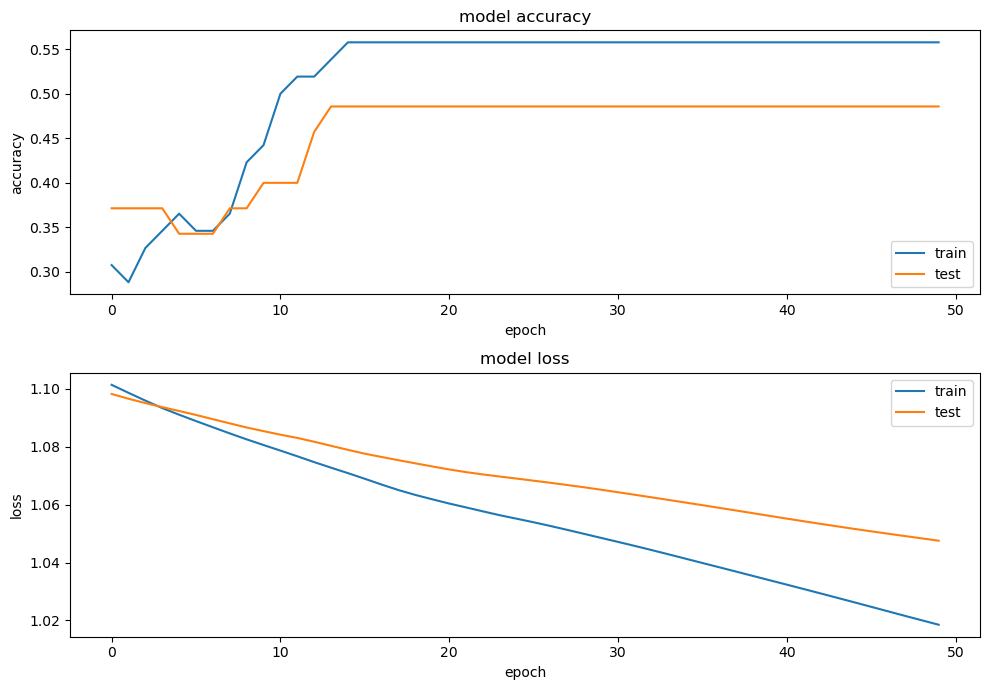

In [56]:
result_train,result_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target,result_train,result_test, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

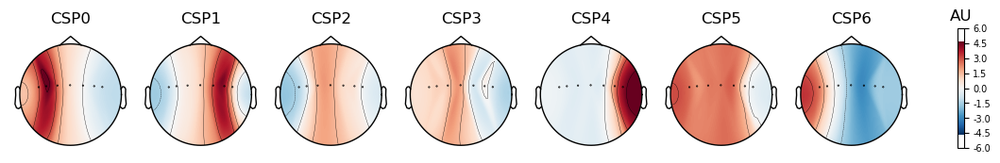

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


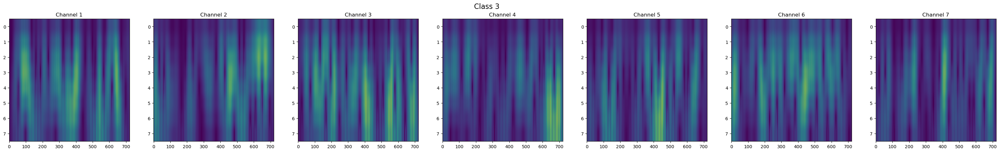

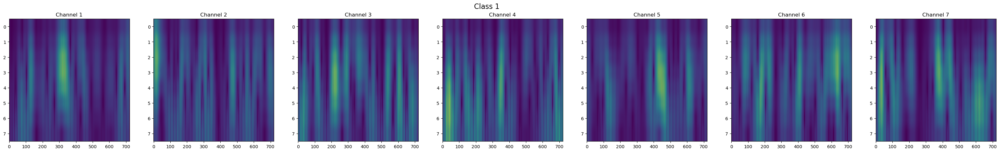

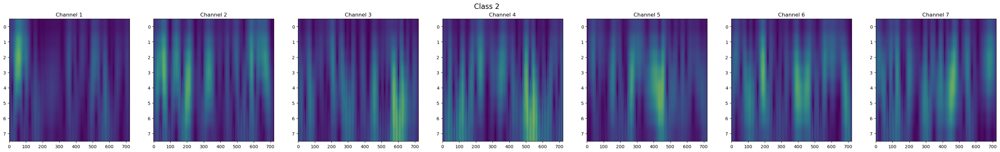

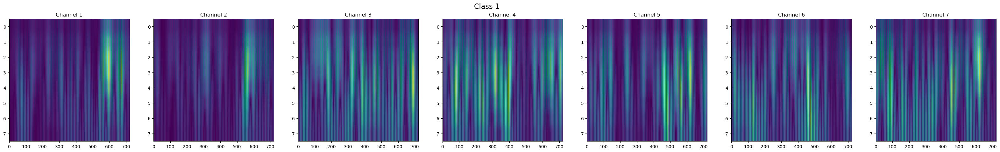

In [57]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [58]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [59]:
result_train,result_test = svm(X_train, X_test, y_train, y_test, target, result_train,result_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.6489795918367347
recall: 0.6
f1_score: 0.6047261009667025
              precision    recall  f1-score   support

        rest       0.57      0.71      0.63        17
        left       1.00      0.56      0.71         9
       right       0.44      0.44      0.44         9

    accuracy                           0

In [60]:
result_train,result_test = lda(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.5961538461538461
precision: 0.5834841628959276
recall: 0.5961538461538461
f1_score: 0.5720959831129323
              precision    recall  f1-score   support

        rest       0.62      0.84      0.71        25
        left       0.60      0.43      0.50        14
       right       0.50      0.31      0.38        13

    accuracy                           0.60        52
   macro avg       0.57      0.53      0.53        52
weighted avg       0.58      0.60      0.57        52

Confusion matrix 
[[21  2  2]
 [ 6  6  2]
 [ 7  2  4]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.7723214285714286
recall: 0.5714285714285714
f1_score: 0.4819613040021204
              precision    recall  f1-score   support

        rest       0.53      1.00      0.69        17
        left       1.00      0.22      0.36         9
       right       1.00   

In [61]:
result_train,result_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.595578231292517
recall: 0.6
f1_score: 0.5715424819083357
              precision    recall  f1-score   support

        rest       0.58      0.82      0.68        17
        left       0.71      0.56      0.63         9
       right       0.50      0.22      0.31         9

    accuracy                           0.60        35
   macro avg       0.60

In [62]:
result_train,result_test = naive(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.6108374384236454
recall: 0.5714285714285714
f1_score: 0.5093167701863354
              precision    recall  f1-score   support

        rest       0.55      0.94      0.70        17
        left       0.33      0.11      0.17         9
       right       1.00      0.33      0.50         9

    accuracy                           0.57        35


In [63]:
result_train,result_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_train,result_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6153846153846154
precision: 0.7556918656056588
recall: 0.6153846153846154
f1_score: 0.6266858141858141
              precision    recall  f1-score   support

        rest       0.87      0.52      0.65        25
        left       0.88      0.50      0.64        14
       right       0.41      0.92      0.57        13

    accuracy                           0.62        52
   macro avg       0.72      0.65      0.62        52
weighted avg       0.76      0.62      0.63        52

Confusion matrix 
[[13  0 12]
 [ 2  7  5]
 [ 0  1 12]]
----------------Test set:----------------
Accuracy: 0.37142857142857144
precision: 0.5142857142857142
recall: 0.37142857142857144
f1_score: 0.35423376623376623
              precision    recall  f1-score   support

        rest       0.38      0.18      0.24        17
        left       1.00      0.33      0.50         9
       right       0.29      0.7

In [64]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 128)               5168256   
                                                                 
 dense_12 (Dense)            (None, 32)                4128      
                                                                 
 dense_13 (Dense)            (None, 8)                 264       
                                                                 
 dense_14 (Dense)            (None, 3)                 27        
                                                                 
Total params: 5,172,675
Trainable params: 5,172,675
Non-trainable params: 0
_________________________________________________________________


In [65]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 590ms/step - loss: 1.4096 - accuracy: 0.4615 - val_loss: 42.2003 - val_accuracy: 0.2571
Epoch 2/50
1/1 [==============================] - 0s 78ms/step - loss: 41.7191 - accuracy: 0.2692 - val_loss: 2.0755 - val_accuracy: 0.2571
Epoch 3/50
1/1 [==============================] - 0s 46ms/step - loss: 1.9933 - accuracy: 0.2500 - val_loss: 1.0987 - val_accuracy: 0.2571
Epoch 4/50
1/1 [==============================] - 0s 49ms/step - loss: 1.0959 - accuracy: 0.2500 - val_loss: 1.0986 - val_accuracy: 0.2571
Epoch 5/50
1/1 [==============================] - 0s 48ms/step - loss: 1.0986 - accuracy: 0.2500 - val_loss: 1.0985 - val_accuracy: 0.4857
Epoch 6/50
1/1 [==============================] - 0s 46ms/step - loss: 1.0985 - accuracy: 0.4808 - val_loss: 1.0983 - val_accuracy: 0.4857
Epoch 7/50
1/1 [==============================] - 0s 46ms/step - loss: 1.0983 - accuracy: 0.4808 - val_loss: 1.0982 - val_accuracy: 0.4857
Epoch 8/50
1/1 [========

2/2 [==============================] - 0s 5ms/step
--------------Training set:--------------
Accuracy: 0.4807692307692308
precision: 0.2311390532544379
recall: 0.4807692307692308
f1_score: 0.31218781218781216
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65        25
        left       0.00      0.00      0.00        14
       right       0.00      0.00      0.00        13

    accuracy                           0.48        52
   macro avg       0.16      0.33      0.22        52
weighted avg       0.23      0.48      0.31        52

Confusion matrix 
[[25  0  0]
 [14  0  0]
 [13  0  0]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.23591836734693875
recall: 0.4857142857142857
f1_score: 0.31758241758241756
              precision    recall  f1-score   support

        rest       0.49      1.00      0.65        17
        left       0.00      0.00      0.00         9
       right       0.00      0.00

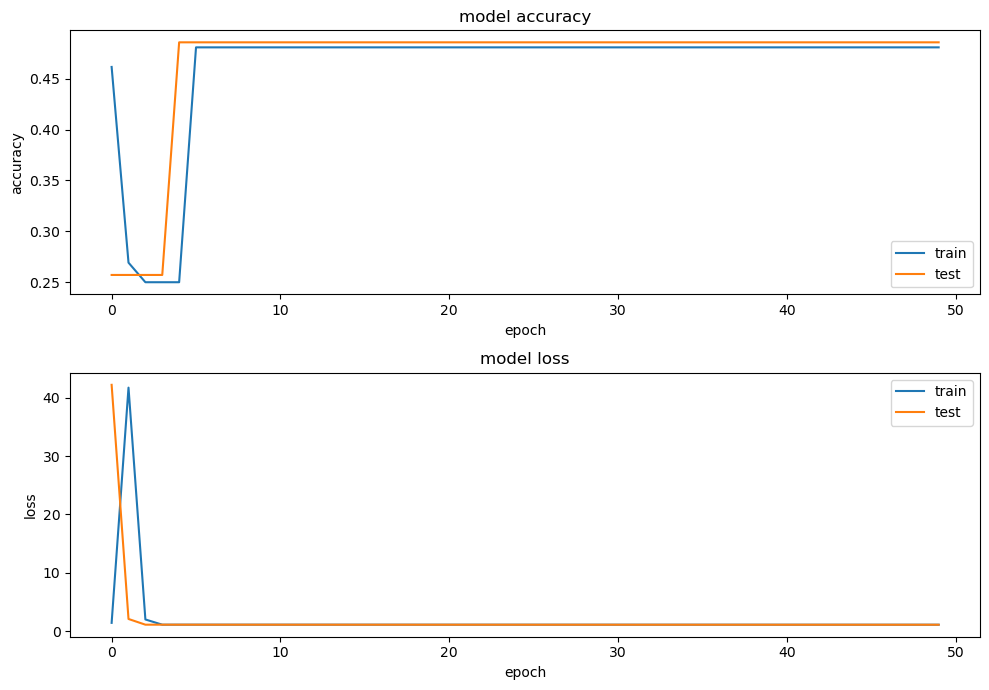

In [66]:
# X_train = pd.DataFrame(X_train)
# X_test = pd.DataFrame(X_test)
result_train,result_test = nn_report(y_train_encoded, y_test_encoded,history, X_train, X_test, target,result_train,result_test, numclass , model)

In [67]:
# Split data into training and test sets
X_train, X_test,y_train, y_test = train_test_split(train_data_cwt,y, test_size=0.4, random_state=56, shuffle=False)

# Convert arrays to DataFrames
X_train_df = pd.DataFrame(X_train.reshape(X_train.shape[0], -1))
X_test_df = pd.DataFrame(X_test.reshape(X_test.shape[0], -1))

In [68]:
X_train.shape

(52, 7, 8, 721)

In [69]:
model = models.Sequential()
model.add(layers.Conv2D(32, (2, 2), activation='relu', input_shape=(7, 8, 721)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(16, (3, 3), activation='relu'))
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dense(10))

model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit(X_train, y_train, epochs=50,batch_size = X_train.shape[0],validation_data=(X_test, y_test))

Epoch 1/50
1/1 [==============================] - 1s 623ms/step - loss: 3.4157 - accuracy: 0.0000e+00 - val_loss: 2.6380 - val_accuracy: 0.0000e+00
Epoch 2/50
1/1 [==============================] - 0s 46ms/step - loss: 2.3837 - accuracy: 0.0577 - val_loss: 2.5628 - val_accuracy: 0.4286
Epoch 3/50
1/1 [==============================] - 0s 78ms/step - loss: 2.5027 - accuracy: 0.4423 - val_loss: 2.2499 - val_accuracy: 0.4286
Epoch 4/50
1/1 [==============================] - 0s 43ms/step - loss: 2.0244 - accuracy: 0.4808 - val_loss: 2.2030 - val_accuracy: 0.0286
Epoch 5/50
1/1 [==============================] - 0s 41ms/step - loss: 1.8189 - accuracy: 0.1923 - val_loss: 2.0930 - val_accuracy: 0.1429
Epoch 6/50
1/1 [==============================] - 0s 92ms/step - loss: 1.6312 - accuracy: 0.3654 - val_loss: 1.7998 - val_accuracy: 0.4571
Epoch 7/50
1/1 [==============================] - 0s 113ms/step - loss: 1.3698 - accuracy: 0.5000 - val_loss: 1.7927 - val_accuracy: 0.4571
Epoch 8/50
1/1 [=

2/2 - 0s - loss: 1.4323 - accuracy: 0.5143 - 35ms/epoch - 18ms/step


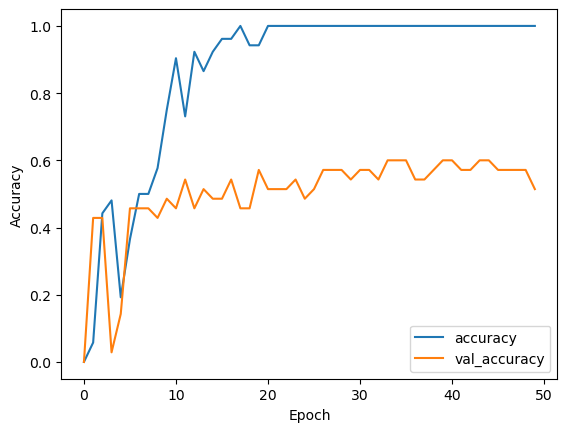

In [70]:
plt.plot(history.history['accuracy'], label='accuracy')
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend(loc='lower right')

test_loss, test_acc = model.evaluate(X_test,  y_test, verbose=2)

In [71]:
score_train = model.evaluate(X_train, y_train, verbose=0)
print("Train loss:", score_train[0])
print("Train accuracy:", score_train[1])

Train loss: 0.004142385441809893
Train accuracy: 1.0


In [72]:
cnn = [[],[],[],[]]

2/2 [==============================] - 0s 3ms/step
[1 1 1 2 1 2 2 1 2 3 2 1 2 3 1 1 1 2 2 2 3 2 1 1 1 1 3 1 1 1 1 1 2 1 2]
(35,)
Accuracy: 0.5142857142857142
precision: 0.4781954887218045
recall: 0.5142857142857142
f1_score: 0.4858189429618001
              precision    recall  f1-score   support

        rest       0.63      0.71      0.67        17
        left       0.42      0.56      0.48         9
       right       0.25      0.11      0.15         9

    accuracy                           0.51        35
   macro avg       0.43      0.46      0.43        35
weighted avg       0.48      0.51      0.49        35

Confusion matrix 
[[12  3  2]
 [ 3  5  1]
 [ 4  4  1]]
Test loss: 1.432289958000183
Test accuracy: 0.5142857432365417


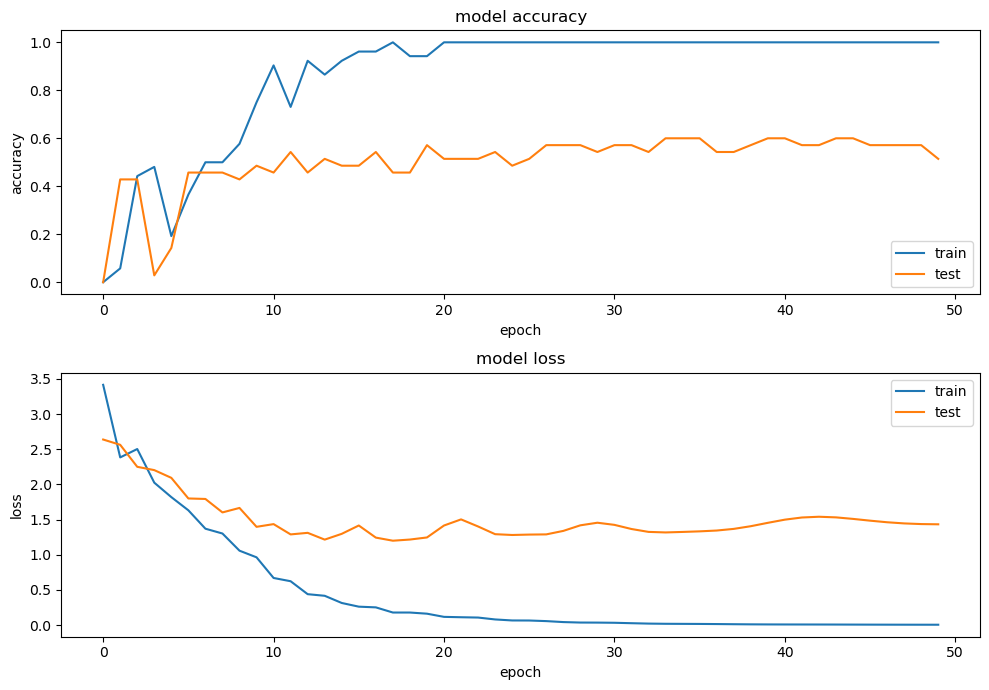

In [73]:
y_test_encoded = pd.get_dummies(y_test, columns=[1, 2])
actual_classes_str = pd.get_dummies(y_test_encoded).idxmax(1)
actual_classes_str = pd.DataFrame(actual_classes_str, index=y_test_encoded.index)

#Predictions on the test set
predicted_classes = np.argmax(model.predict(X_test),axis=1)
predicted_classes_str = []

for i in predicted_classes:
    if i == 1:
        predicted_classes_str.append(numclass[0])
    elif i == 2:
        predicted_classes_str.append(numclass[1])
    elif i == 3:
        predicted_classes_str.append(numclass[2])

print(predicted_classes)
print(np.array(predicted_classes_str).shape)
predicted_classes_str = pd.DataFrame(predicted_classes_str,index=y_test_encoded.index)


re = report(actual_classes_str, predicted_classes_str,cnn,target)

score = model.evaluate(X_test, y_test, verbose=0)
print("Test loss:", score[0])
print("Test accuracy:", score[1])

# plotting the metrics
plt.figure(figsize=(10, 7))
plt.subplot(2,1,1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='lower right')

plt.subplot(2,1,2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.tight_layout()

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

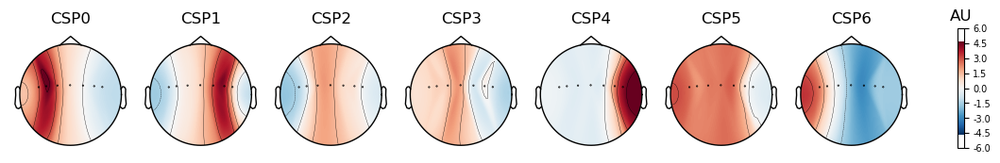

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


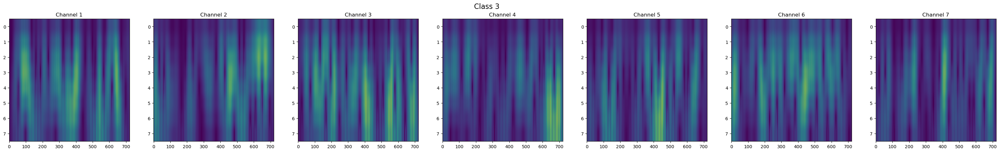

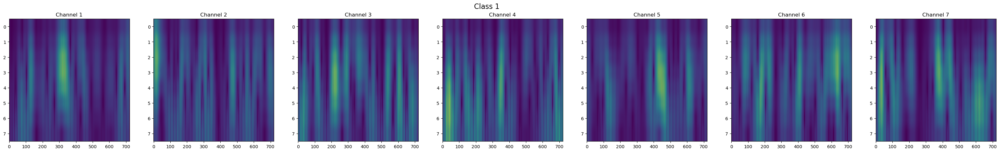

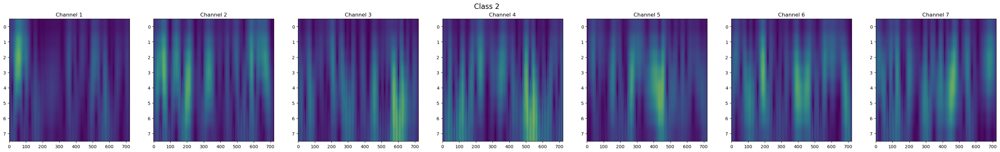

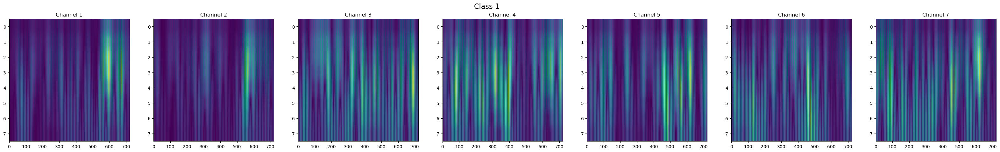

In [74]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [75]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [76]:
subset = mRMR_WT(np.array(X_train), np.array(y_train),k= 1000)

100%|██████████| 1000/1000 [28:13<00:00,  1.69s/it]


[3605, 10965, 21745, 25471, 23699, 33694, 38640, 2655, 2892, 16881, 12547, 37156, 1841, 3613, 14162, 16890, 647, 1444, 10973, 6781, 33757, 34831, 2885, 3383, 27155, 23681, 3, 10381, 6189, 37877, 37920, 35925, 1451, 6787, 12541, 1940, 33756, 730, 16169, 1848, 2164, 7494, 22010, 33695, 11942, 6066, 9, 33051, 32653, 724, 2661, 36743, 35552, 6360, 12566, 22458, 1219, 19388, 2172, 6060, 16873, 24650, 13268, 19799, 2662, 11948, 34477, 6773, 2171, 37919, 17273, 6183, 10, 36646, 26434, 18954, 21289, 23687, 2569, 4, 6910, 37199, 11956, 6367, 37878, 10964, 1934, 22466, 2165, 21121, 37876, 25366, 6904, 731, 6373, 3376, 34469, 13261, 13441, 38641, 16, 7502, 10981, 32973, 2576, 20109, 18947, 2900, 498, 25377, 32330, 1450, 7508, 32726, 16177, 11058, 1445, 6331, 33374, 6052, 32974, 3621, 34825, 653, 39905, 12540, 35932, 723, 7618, 6366, 4334, 18226, 3382, 34838, 12802, 33764, 8215, 13287, 16160, 7052, 1120, 737, 11820, 29121, 7500, 2179, 33043, 19382, 8332, 11950, 7773, 736, 37927, 31355, 10989, 2668

In [77]:
X_train = X_train[subset]
X_test = X_test[subset]

In [78]:
result_train,result_test = svm(X_train, X_test, y_train, y_test, target, result_train,result_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.5864285714285714
recall: 0.6
f1_score: 0.5684619213539075
              precision    recall  f1-score   support

        rest       0.62      0.88      0.73        17
        left       0.60      0.33      0.43         9
       right       0.50      0.33      0.40         9

    accuracy                           0

In [79]:
result_train,result_test = lda(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.9423076923076923
precision: 0.9414447731755424
recall: 0.9423076923076923
f1_score: 0.941342383107089
              precision    recall  f1-score   support

        rest       0.96      1.00      0.98        25
        left       0.93      0.93      0.93        14
       right       0.92      0.85      0.88        13

    accuracy                           0.94        52
   macro avg       0.94      0.92      0.93        52
weighted avg       0.94      0.94      0.94        52

Confusion matrix 
[[25  0  0]
 [ 0 13  1]
 [ 1  1 11]]
----------------Test set:----------------
Accuracy: 0.5428571428571428
precision: 0.5317669172932331
recall: 0.5428571428571428
f1_score: 0.5355742296918767
              precision    recall  f1-score   support

        rest       0.63      0.71      0.67        17
        left       0.38      0.33      0.35         9
       right       0.50    

In [80]:
result_train,result_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_train,result_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6547293700088731
recall: 0.6571428571428571
f1_score: 0.6352040816326531
              precision    recall  f1-score   support

        rest       0.65      0.88      0.75        17
        left       0.71      0.56      0.63         9
       right       0.60      0.33      0.43         9

    accuracy                           0.66   

In [81]:
result_train,result_test = naive(X_train, X_test, y_train, y_test, target,result_train,result_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.508994708994709
recall: 0.5142857142857142
f1_score: 0.4673326673326673
              precision    recall  f1-score   support

        rest       0.52      0.82      0.64        17
        left       0.50      0.22      0.31         9
       right       0.50      0.22      0.31         9

    accuracy                           0.51        35
 

In [82]:
result_train,result_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_train,result_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.9807692307692307
precision: 0.982051282051282
recall: 0.9807692307692307
f1_score: 0.9807161803713529
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       0.93      1.00      0.97        14
       right       1.00      0.92      0.96        13

    accuracy                           0.98        52
   macro avg       0.98      0.97      0.98        52
weighted avg       0.98      0.98      0.98        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  1 12]]
----------------Test set:----------------
Accuracy: 0.4857142857142857
precision: 0.5163265306122449
recall: 0.4857142857142857
f1_score: 0.4910639150470848
              precision    recall  f1-score   support

        rest       0.57      0.47      0.52        17
        left       0.57      0.44      0.50         9
       right       0.36      0.56   

In [83]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(3, activation='softmax'))

model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_17 (Dense)            (None, 64)                64064     
                                                                 
 dense_18 (Dense)            (None, 32)                2080      
                                                                 
 dense_19 (Dense)            (None, 16)                528       
                                                                 
 dense_20 (Dense)            (None, 3)                 51        
                                                                 
Total params: 66,723
Trainable params: 66,723
Non-trainable params: 0
_________________________________________________________________


In [84]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 642ms/step - loss: 1.6468 - accuracy: 0.2885 - val_loss: 1.3444 - val_accuracy: 0.2571
Epoch 2/50
1/1 [==============================] - 0s 38ms/step - loss: 1.0460 - accuracy: 0.4808 - val_loss: 1.3177 - val_accuracy: 0.2000
Epoch 3/50
1/1 [==============================] - 0s 35ms/step - loss: 0.8747 - accuracy: 0.6923 - val_loss: 1.2983 - val_accuracy: 0.3429
Epoch 4/50
1/1 [==============================] - 0s 36ms/step - loss: 0.7236 - accuracy: 0.8269 - val_loss: 1.3252 - val_accuracy: 0.3714
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 0.5559 - accuracy: 0.9038 - val_loss: 1.3163 - val_accuracy: 0.4000
Epoch 6/50
1/1 [==============================] - 0s 43ms/step - loss: 0.3934 - accuracy: 0.9423 - val_loss: 1.2999 - val_accuracy: 0.4000
Epoch 7/50
1/1 [==============================] - 0s 37ms/step - loss: 0.2702 - accuracy: 0.9615 - val_loss: 1.3080 - val_accuracy: 0.4571
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 3ms/step
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00        25
        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0  0]
 [ 0 14  0]
 [ 0  0 13]]
----------------Test set:----------------
Accuracy: 0.5428571428571428
precision: 0.5511904761904762
recall: 0.5428571428571428
f1_score: 0.508177905308465
              precision    recall  f1-score   support

        rest       0.58      0.82      0.68        17
        left       0.67      0.22      0.33         9
       right       0.38      0.33      0.35         9

    accuracy                           0.5

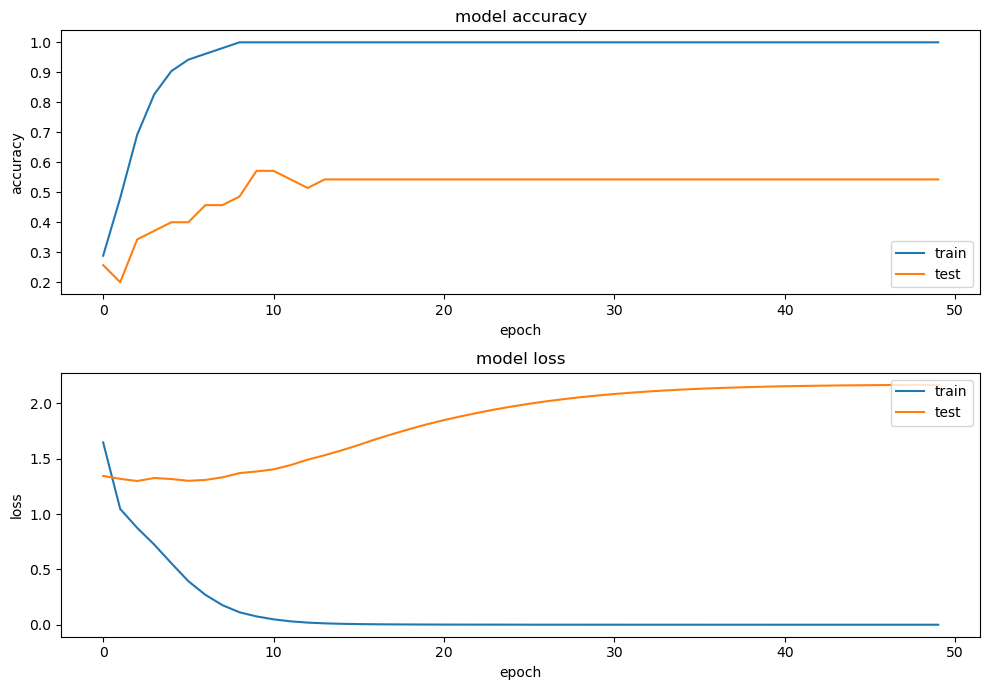

In [85]:
result_train,result_test = nn_report(y_train_encoded, y_test_encoded,history, X_train, X_test, target, result_train,result_test, numclass , model)

## **left right**

In [86]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'left': 2, 'right': 3}
target = ['left','right']
numclass = [2,3]

In [87]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 6

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating reject

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

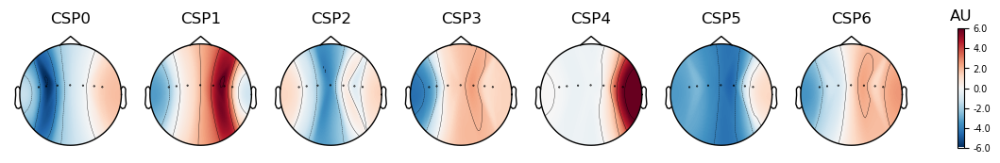

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [88]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [89]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [90]:
result_mi_train = [[],[],[],[]]
result_mi_test = [[],[],[],[]]

In [91]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test , kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.9259259259259259
precision: 0.9259259259259259
recall: 0.9259259259259259
f1_score: 0.9259259259259259
              precision    recall  f1-score   support

        left       0.93      0.93      0.93        14
       right       0.92      0.92      0.92        13

    accuracy                           0.93        27
   macro avg       0.93      0.93      0.93        27
weighted avg       0.93      0.93      0.93        27

Confusion matrix 
[[13  1]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.7

In [92]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.9259259259259259
precision: 0.9259259259259259
recall: 0.9259259259259259
f1_score: 0.9259259259259259
              precision    recall  f1-score   support

        left       0.93      0.93      0.93        14
       right       0.92      0.92      0.92        13

    accuracy                           0.93        27
   macro avg       0.93      0.93      0.93        27
weighted avg       0.93      0.93      0.93        27

Confusion matrix 
[[13  1]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.7

In [93]:
result_mi_train,result_mi_test = lda(X_train, X_test, y_train, y_test, target,result_mi_train,result_mi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.6666666666666666
precision: 0.6666666666666666
recall: 0.6666666666666666
f1_score: 0.6666666666666666
              precision    recall  f1-score   support

        left       0.67      0.67      0.67         9
       right       0.67      0.67      0.67         9

    accuracy                           0.67        18
   macro avg       0.67      0.67      0.67

In [94]:
result_mi_train,result_mi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.9259259259259259
precision: 0.9259259259259259
recall: 0.9259259259259259
f1_score: 0.9259259259259259
              precision    recall  f1-score   support

        left       0.93      0.93      0.93        14
       right       0.92      0.92      0.92        13

    accuracy                           0.93        27
   macro avg       0.93      0.93      0.93        27
weighted avg       0.93      0.93      0.93        27

Confusion matrix 
[[13  1]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weig

In [95]:
result_mi_train,result_mi_test = naive(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.9629629629629629
precision: 0.9656084656084656
recall: 0.9629629629629629
f1_score: 0.9629629629629629
              precision    recall  f1-score   support

        left       1.00      0.93      0.96        14
       right       0.93      1.00      0.96        13

    accuracy                           0.96        27
   macro avg       0.96      0.96      0.96        27
weighted avg       0.97      0.96      0.96        27

Confusion matrix 
[[13  1]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.75
recall: 0.7222222222222222
f1_score: 0.7142857142857143
              precision    recall  f1-score   support

        left       0.83      0.56      0.67         9
       right       0.67      0.89      0.76         9

    accuracy                           0.72        18
   macro avg       0.75      0.72      0.71        18
weighted avg       0.75   

In [96]:
result_mi_train,result_mi_test = knn(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.9629629629629629
precision: 0.9656084656084656
recall: 0.9629629629629629
f1_score: 0.9629629629629629
              precision    recall  f1-score   support

        left       1.00      0.93      0.96        14
       right       0.93      1.00      0.96        13

    accuracy                           0.96        27
   macro avg       0.96      0.96      0.96        27
weighted avg       0.97      0.96      0.96        27

Confusion matrix 
[[13  1]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7922077922077921
recall: 0.7777777777777778
f1_score: 0.7749999999999999
              precision    recall  f1-score   support

        left       0.86      0.67      0.75         9
       right       0.73      0.89      0.80         9

    accuracy                           0.78        18
   macro avg       0.79      0.78      0.77        1

In [97]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_21 (Dense)            (None, 32)                256       
                                                                 
 dense_22 (Dense)            (None, 16)                528       
                                                                 
 dense_23 (Dense)            (None, 2)                 34        
                                                                 
Total params: 818
Trainable params: 818
Non-trainable params: 0
_________________________________________________________________


In [98]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 552ms/step - loss: 0.6740 - accuracy: 0.6296 - val_loss: 0.6698 - val_accuracy: 0.6667
Epoch 2/50
1/1 [==============================] - 0s 33ms/step - loss: 0.6703 - accuracy: 0.6667 - val_loss: 0.6666 - val_accuracy: 0.7222
Epoch 3/50
1/1 [==============================] - 0s 33ms/step - loss: 0.6667 - accuracy: 0.7037 - val_loss: 0.6634 - val_accuracy: 0.6667
Epoch 4/50
1/1 [==============================] - 0s 33ms/step - loss: 0.6630 - accuracy: 0.7407 - val_loss: 0.6602 - val_accuracy: 0.6667
Epoch 5/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6591 - accuracy: 0.7407 - val_loss: 0.6570 - val_accuracy: 0.7222
Epoch 6/50
1/1 [==============================] - 0s 40ms/step - loss: 0.6553 - accuracy: 0.7407 - val_loss: 0.6538 - val_accuracy: 0.6667
Epoch 7/50
1/1 [==============================] - 0s 34ms/step - loss: 0.6514 - accuracy: 0.7778 - val_loss: 0.6504 - val_accuracy: 0.7222
Epoch 8/50
1/1 [==========

1/1 [==============================] - 0s 32ms/step
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.8333333333333334
precision: 0.8374999999999999
recall: 0.8333333333333334
f1_score: 0.8328173374613004
              precision    recall  f1-score   support

        left       0.88      0.78      0.82         9
       right       0.80      0.89      0.84         9

    accuracy                           0.83        18
   macro avg       0.84      0.83      0.83        1

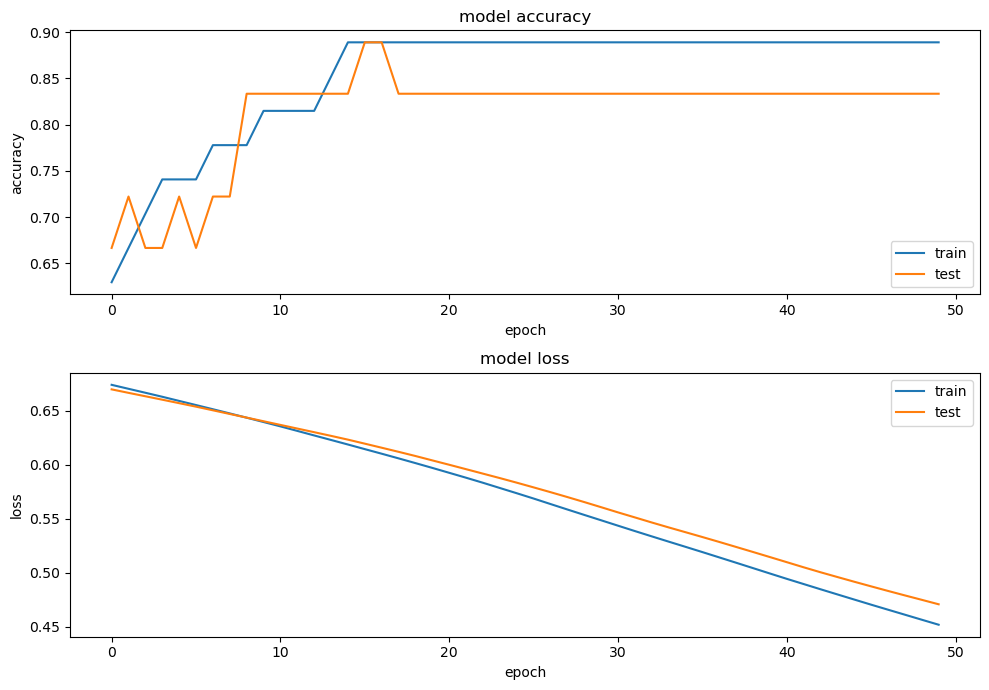

In [99]:
result_mi_train,result_mi_test = nn_report(y_train_encoded, y_test_encoded,history,X_train, X_test, target, result_mi_train,result_mi_test, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

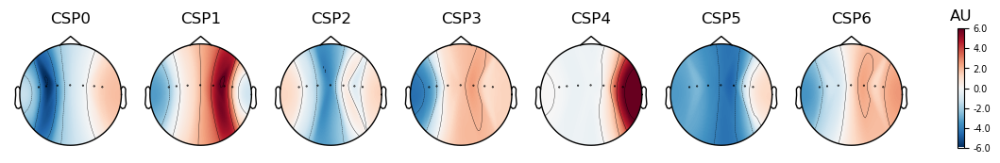

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [100]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [101]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [102]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7777777777777778
recall: 0.7777777777777778
f1_score: 0.7777777777777778
              precision    recall  f1-score   support

        left       0.78      0.78      0.78         9
       right       0.78      0.78      0.78         9

    accuracy                           0.78        18
   macro avg       0.7

In [103]:
result_mi_train,result_mi_test = lda(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7777777777777778
recall: 0.7777777777777778
f1_score: 0.7777777777777778
              precision    recall  f1-score   support

        left       0.78      0.78      0.78         9
       right       0.78      0.78      0.78         9

    accuracy                           0.78        18
   macro avg       0.78      0.78      0.78

In [104]:
result_mi_train,result_mi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7777777777777778
recall: 0.7777777777777778
f1_score: 0.7777777777777778
              precision    recall  f1-score   support

        left       0.78      0.78      0.78         9
       right       0.78      0.78      0.78         9

    accuracy                           0.78        18
   macro avg       0.78      0.78      0.78        18
weig

In [105]:
result_mi_train,result_mi_test = naive(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.6666666666666666
precision: 0.6666666666666666
recall: 0.6666666666666666
f1_score: 0.6666666666666666
              precision    recall  f1-score   support

        left       0.67      0.67      0.67         9
       right       0.67      0.67      0.67         9

    accuracy                           0.67        18
   macro avg       0.67      0.67      0.67        18
weighted avg

In [106]:
result_mi_train,result_mi_test = knn(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.9259259259259259
precision: 0.9259259259259259
recall: 0.9259259259259259
f1_score: 0.9259259259259259
              precision    recall  f1-score   support

        left       0.93      0.93      0.93        14
       right       0.92      0.92      0.92        13

    accuracy                           0.93        27
   macro avg       0.93      0.93      0.93        27
weighted avg       0.93      0.93      0.93        27

Confusion matrix 
[[13  1]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.6111111111111112
precision: 0.6124999999999999
recall: 0.6111111111111112
f1_score: 0.6099071207430341
              precision    recall  f1-score   support

        left       0.60      0.67      0.63         9
       right       0.62      0.56      0.59         9

    accuracy                           0.61        18
   macro avg       0.61      0.61      0.61        1

In [107]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_24 (Dense)            (None, 32)                96        
                                                                 
 dense_25 (Dense)            (None, 16)                528       
                                                                 
 dense_26 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [108]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 835ms/step - loss: 0.6805 - accuracy: 0.5926 - val_loss: 0.6728 - val_accuracy: 0.6667
Epoch 2/100
1/1 [==============================] - 0s 32ms/step - loss: 0.6762 - accuracy: 0.7037 - val_loss: 0.6683 - val_accuracy: 0.6667
Epoch 3/100
1/1 [==============================] - 0s 31ms/step - loss: 0.6719 - accuracy: 0.7407 - val_loss: 0.6639 - val_accuracy: 0.8333
Epoch 4/100
1/1 [==============================] - 0s 31ms/step - loss: 0.6677 - accuracy: 0.7778 - val_loss: 0.6594 - val_accuracy: 0.9444
Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 0.6635 - accuracy: 0.8519 - val_loss: 0.6551 - val_accuracy: 0.9444
Epoch 6/100
1/1 [==============================] - 0s 32ms/step - loss: 0.6594 - accuracy: 0.8889 - val_loss: 0.6509 - val_accuracy: 0.9444
Epoch 7/100
1/1 [==============================] - 0s 53ms/step - loss: 0.6553 - accuracy: 0.8889 - val_loss: 0.6468 - val_accuracy: 0.9444
Epoch 8/100
1/1 [==

1/1 [==============================] - 0s 27ms/step
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.8888888888888888
precision: 0.8888888888888888
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.89      0.89      0.89         9
       right       0.89      0.89      0.89         9

    accuracy                           0.89        18
   macro avg       0.89      0.89      0.89        1

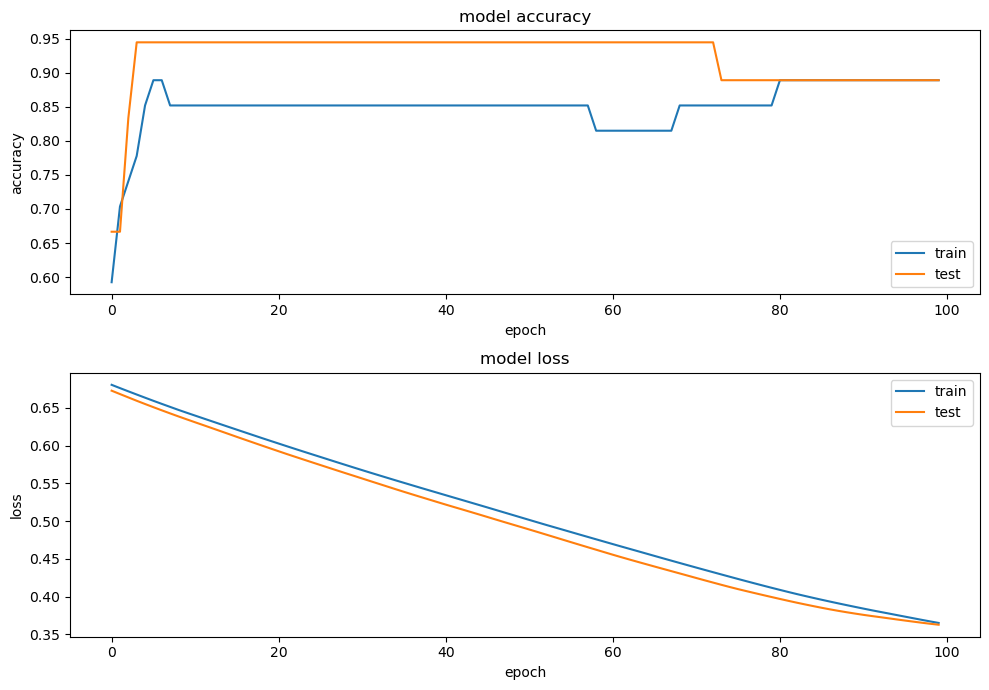

In [109]:
result_mi_train,result_mi_test = nn_report(y_train_encoded, y_test_encoded,history,X_train, X_test, target, result_mi_train,result_mi_test, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

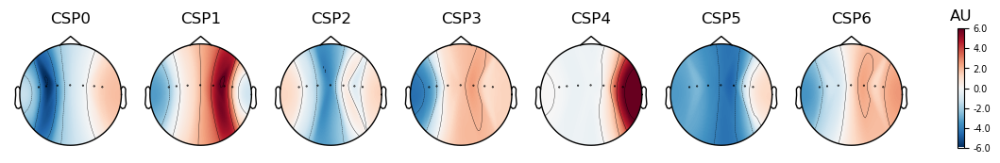

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [110]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [111]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [112]:
subset = mRMR_csp(csp,np.array(X_train),np.array(y_train),k=2)
subset

X_train, X_test = X_train[subset], X_test[subset]

100%|██████████| 2/2 [00:01<00:00,  1.66it/s]


In [113]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.7

In [114]:
result_mi_train,result_mi_test = lda(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.75
recall: 0.7222222222222222
f1_score: 0.7142857142857143
              precision    recall  f1-score   support

        left       0.83      0.56      0.67         9
       right       0.67      0.89      0.76         9

    accuracy                           0.72        18
   macro avg       0.75      0.72      0.71        18
wei

In [115]:
result_mi_train,result_mi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weig

In [116]:
result_mi_train,result_mi_test = naive(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.8888888888888888
precision: 0.8913308913308913
recall: 0.8888888888888888
f1_score: 0.8888888888888888
              precision    recall  f1-score   support

        left       0.92      0.86      0.89        14
       right       0.86      0.92      0.89        13

    accuracy                           0.89        27
   macro avg       0.89      0.89      0.89        27
weighted avg       0.89      0.89      0.89        27

Confusion matrix 
[[12  2]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.75
recall: 0.7222222222222222
f1_score: 0.7142857142857143
              precision    recall  f1-score   support

        left       0.83      0.56      0.67         9
       right       0.67      0.89      0.76         9

    accuracy                           0.72        18
   macro avg       0.75      0.72      0.71        18
weighted avg       0.75   

In [117]:
result_mi_train,result_mi_test = knn(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.9259259259259259
precision: 0.9259259259259259
recall: 0.9259259259259259
f1_score: 0.9259259259259259
              precision    recall  f1-score   support

        left       0.93      0.93      0.93        14
       right       0.92      0.92      0.92        13

    accuracy                           0.93        27
   macro avg       0.93      0.93      0.93        27
weighted avg       0.93      0.93      0.93        27

Confusion matrix 
[[13  1]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        1

In [118]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_27 (Dense)            (None, 32)                96        
                                                                 
 dense_28 (Dense)            (None, 16)                528       
                                                                 
 dense_29 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [119]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=60,batch_size = X_train.shape[0])

Epoch 1/60
1/1 [==============================] - 1s 581ms/step - loss: 0.7106 - accuracy: 0.4815 - val_loss: 0.6974 - val_accuracy: 0.5000
Epoch 2/60
1/1 [==============================] - 0s 38ms/step - loss: 0.7066 - accuracy: 0.4815 - val_loss: 0.6949 - val_accuracy: 0.5000
Epoch 3/60
1/1 [==============================] - 0s 36ms/step - loss: 0.7026 - accuracy: 0.4815 - val_loss: 0.6924 - val_accuracy: 0.5000
Epoch 4/60
1/1 [==============================] - 0s 35ms/step - loss: 0.6987 - accuracy: 0.4815 - val_loss: 0.6900 - val_accuracy: 0.5000
Epoch 5/60
1/1 [==============================] - 0s 35ms/step - loss: 0.6949 - accuracy: 0.4815 - val_loss: 0.6877 - val_accuracy: 0.5000
Epoch 6/60
1/1 [==============================] - 0s 37ms/step - loss: 0.6912 - accuracy: 0.4815 - val_loss: 0.6855 - val_accuracy: 0.5000
Epoch 7/60
1/1 [==============================] - 0s 37ms/step - loss: 0.6876 - accuracy: 0.4815 - val_loss: 0.6833 - val_accuracy: 0.5000
Epoch 8/60
1/1 [==========

1/1 [==============================] - 0s 26ms/step
--------------Training set:--------------
Accuracy: 0.8148148148148148
precision: 0.8324915824915825
recall: 0.8148148148148148
f1_score: 0.8132822477650065
              precision    recall  f1-score   support

        left       0.91      0.71      0.80        14
       right       0.75      0.92      0.83        13

    accuracy                           0.81        27
   macro avg       0.83      0.82      0.81        27
weighted avg       0.83      0.81      0.81        27

Confusion matrix 
[[10  4]
 [ 1 12]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.75
recall: 0.7222222222222222
f1_score: 0.7142857142857143
              precision    recall  f1-score   support

        left       0.83      0.56      0.67         9
       right       0.67      0.89      0.76         9

    accuracy                           0.72        18
   macro avg       0.75      0.72      0.71        18
weighted avg

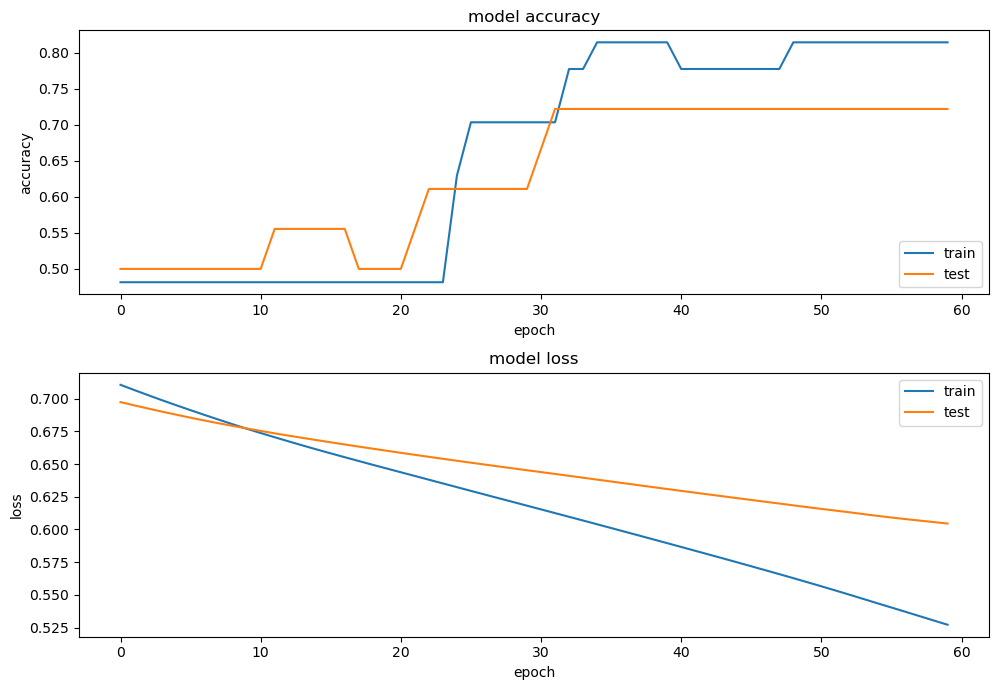

In [120]:
result_mi_train,result_mi_test = nn_report(y_train_encoded, y_test_encoded,history,X_train, X_test, target, result_mi_train,result_mi_test, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

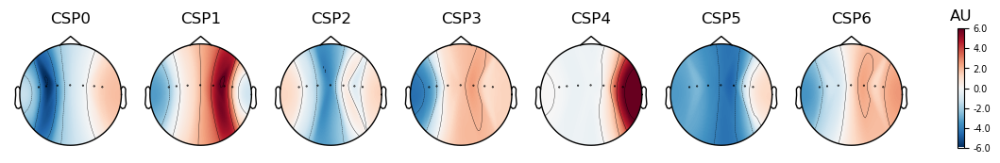

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


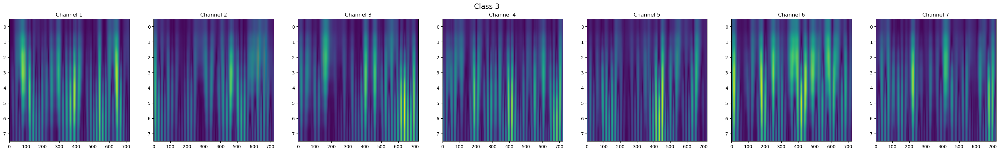

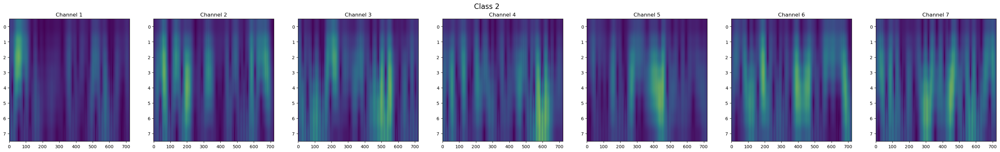

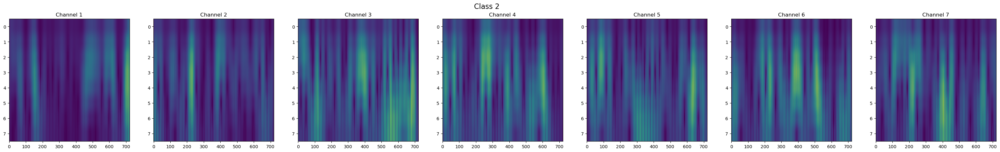

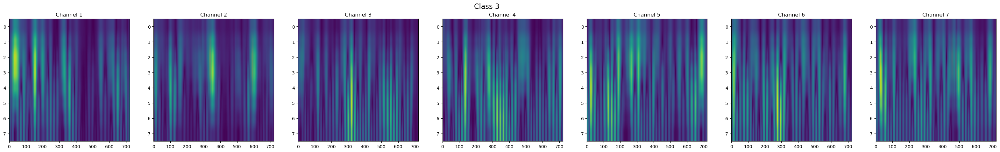

In [121]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [122]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [123]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target,result_mi_train,result_mi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.8333333333333334
precision: 0.8374999999999999
recall: 0.8333333333333334
f1_score: 0.8328173374613004
              precision    recall  f1-score   support

        left       0.88      0.78      0.82         9
       right       0.80      0.89      0.84         9

    accuracy                           0.83        18
   macro avg       0.84      0.83      0.83        18
weighted avg       0.84     

In [124]:
result_mi_train,result_mi_test = lda(X_train, X_test, y_train, y_test, target,result_mi_train,result_mi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.5925925925925926
precision: 0.5919753086419753
recall: 0.5925925925925926
f1_score: 0.5914687100893997
              precision    recall  f1-score   support

        left       0.60      0.64      0.62        14
       right       0.58      0.54      0.56        13

    accuracy                           0.59        27
   macro avg       0.59      0.59      0.59        27
weighted avg       0.59      0.59      0.59        27

Confusion matrix 
[[9 5]
 [6 7]]
----------------Test set:----------------
Accuracy: 0.6111111111111112
precision: 0.625
recall: 0.6111111111111112
f1_score: 0.6000000000000001
              precision    recall  f1-score   support

        left       0.58      0.78      0.67         9
       right       0.67      0.44      0.53         9

    accuracy                           0.61        18
   macro avg       0.62      0.61      0.60        18
weight

In [125]:
result_mi_train,result_mi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7777777777777778
recall: 0.7777777777777778
f1_score: 0.7777777777777778
              precision    recall  f1-score   support

        left       0.78      0.78      0.78         9
       right       0.78      0.78      0.78         9

    accuracy                           0.78        18
   macro avg       0.78      0.78      0.78        18
weighted avg       0.78      0.78      0.78        18

Confusion

In [126]:
result_mi_train,result_mi_test = naive(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.8333333333333334
precision: 0.8374999999999999
recall: 0.8333333333333334
f1_score: 0.8328173374613004
              precision    recall  f1-score   support

        left       0.88      0.78      0.82         9
       right       0.80      0.89      0.84         9

    accuracy                           0.83        18
   macro avg       0.84      0.83      0.83        18
weighted avg       0.84      0.83      0.83        18

Confusion matrix 

In [127]:
result_mi_train,result_mi_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_mi_train,result_mi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.7407407407407407
precision: 0.8314814814814816
recall: 0.7407407407407407
f1_score: 0.7250280583613917
              precision    recall  f1-score   support

        left       1.00      0.50      0.67        14
       right       0.65      1.00      0.79        13

    accuracy                           0.74        27
   macro avg       0.82      0.75      0.73        27
weighted avg       0.83      0.74      0.73        27

Confusion matrix 
[[ 7  7]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.5555555555555556
precision: 0.7647058823529412
recall: 0.5555555555555556
f1_score: 0.4461538461538461
              precision    recall  f1-score   support

        left       1.00      0.11      0.20         9
       right       0.53      1.00      0.69         9

    accuracy                           0.56        18
   macro avg       0.76      0.56      0.45        1

In [128]:
#create model
model = Sequential()
#add model layers
model.add(Dense(512, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_30 (Dense)            (None, 512)               20673024  
                                                                 
 dense_31 (Dense)            (None, 128)               65664     
                                                                 
 dense_32 (Dense)            (None, 32)                4128      
                                                                 
 dense_33 (Dense)            (None, 8)                 264       
                                                                 
 dense_34 (Dense)            (None, 2)                 18        
                                                                 
Total params: 20,743,098
Trainable params: 20,743,098
Non-trainable params: 0
_________________________________________________________________


In [129]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70
1/1 [==============================] - 1s 678ms/step - loss: 0.7701 - accuracy: 0.4815 - val_loss: 29.2001 - val_accuracy: 0.5000
Epoch 2/70
1/1 [==============================] - 0s 78ms/step - loss: 26.2030 - accuracy: 0.5185 - val_loss: 0.6980 - val_accuracy: 0.5000
Epoch 3/70
1/1 [==============================] - 0s 65ms/step - loss: 0.6691 - accuracy: 0.5185 - val_loss: 0.6928 - val_accuracy: 0.5000
Epoch 4/70
1/1 [==============================] - 0s 65ms/step - loss: 0.6715 - accuracy: 0.5926 - val_loss: 1.3827 - val_accuracy: 0.5000
Epoch 5/70
1/1 [==============================] - 0s 66ms/step - loss: 1.2157 - accuracy: 0.4815 - val_loss: 0.6947 - val_accuracy: 0.5000
Epoch 6/70
1/1 [==============================] - 0s 69ms/step - loss: 0.6899 - accuracy: 0.5185 - val_loss: 0.6977 - val_accuracy: 0.5000
Epoch 7/70
1/1 [==============================] - 0s 71ms/step - loss: 0.6905 - accuracy: 0.5185 - val_loss: 0.7006 - val_accuracy: 0.5000
Epoch 8/70
1/1 [========

1/1 [==============================] - 0s 36ms/step
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.5
precision: 0.25
recall: 0.5
f1_score: 0.3333333333333333
              precision    recall  f1-score   support

        left       0.50      1.00      0.67         9
       right       0.00      0.00      0.00         9

    accuracy                           0.50        18
   macro avg       0.25      0.50      0.33        18
weighted avg       0.25      0.50      0.33        18

Confusion matrix 
[[9 0]
 [9 0]]
Test loss: 0.9

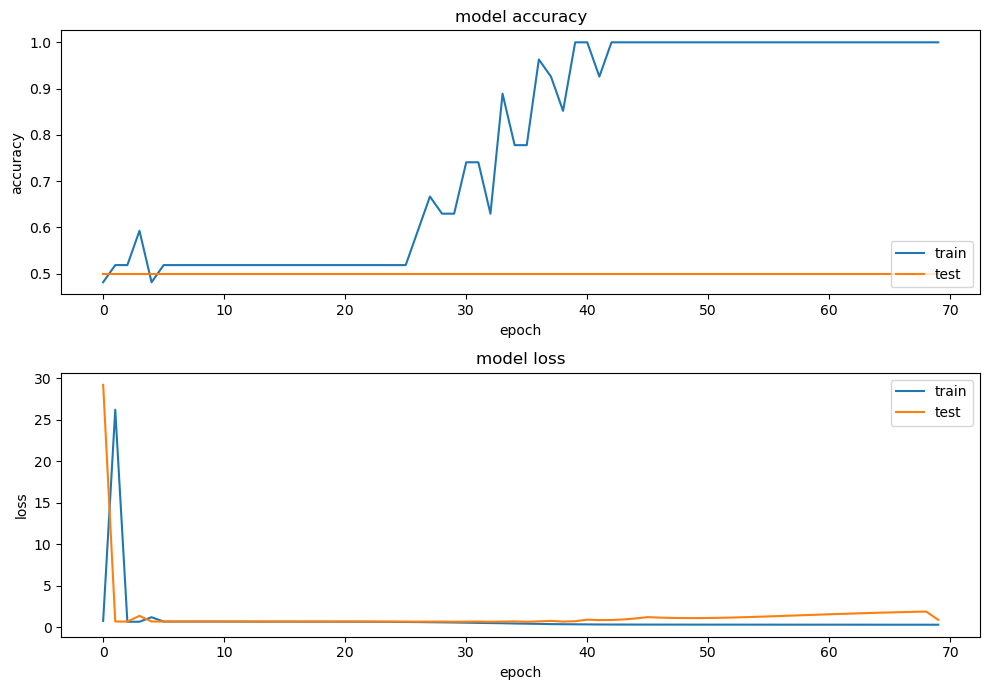

In [130]:
result_mi_train,result_mi_test = nn_report(y_train_encoded,y_test_encoded,history, X_train,X_test, target, result_mi_train,result_mi_test, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag

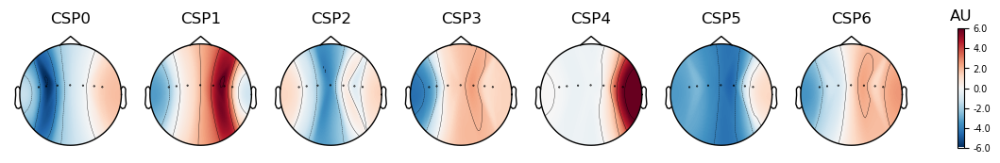

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


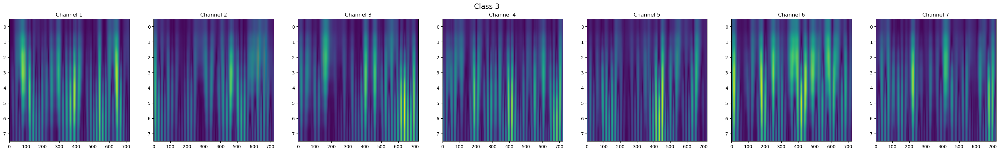

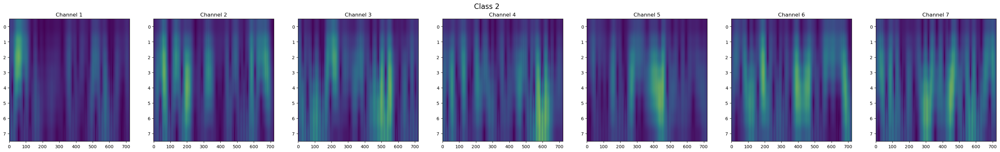

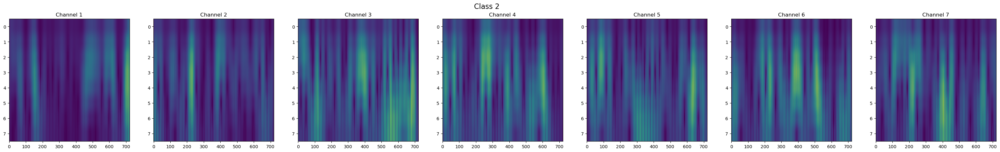

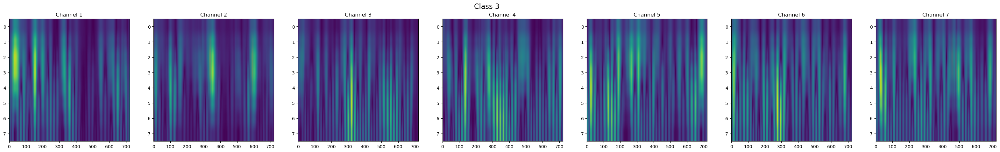

In [131]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [132]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [133]:
subset = mRMR_WT(np.array(X_train), np.array(y_train),k= 1000)

100%|██████████| 1000/1000 [25:13<00:00,  1.51s/it]


[21, 17036, 6156, 3148, 31120, 8, 24918, 729, 14050, 14, 37281, 9987, 30009, 15, 34742, 25639, 723, 29288, 27, 10708, 735, 34736, 24925, 554, 32718, 1406, 31841, 742, 38426, 12464, 548, 10716, 9, 2127, 9994, 2234, 35457, 24204, 30399, 1412, 31997, 736, 13739, 11743, 36985, 9995, 1275, 31121, 18462, 1513, 33438, 1450, 13018, 685, 6115, 37706, 382, 26047, 3, 17735, 24912, 691, 2240, 6121, 23171, 2856, 748, 1103, 26054, 17741, 2133, 1519, 10715, 13185, 32717, 560, 23405, 33633, 26219, 34748, 1456, 2955, 8986, 36560, 1269, 20, 24197, 30400, 18456, 13487, 34167, 36553, 40282, 12457, 25646, 36978, 1824, 10707, 31849, 792, 730, 6836, 6713, 14461, 1889, 1443, 31842, 13011, 34833, 39561, 11737, 25333, 37705, 11437, 18464, 23128, 14460, 2, 31127, 14208, 26768, 9274, 39147, 1096, 25777, 24919, 13329, 37288, 35463, 798, 376, 4400, 2610, 33446, 40291, 11736, 36257, 23177, 1281, 32726, 1444, 6127, 4401, 37282, 19242, 2140, 7434, 34839, 16883, 18463, 23898, 23849, 17734, 26767, 375, 6830, 34345, 741,

In [134]:
X_train = X_train[subset]
X_test = X_test[subset]

In [135]:
result_mi_train,result_mi_test = svm(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weighted avg       0.73     

In [136]:
result_mi_train,result_mi_test = lda(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7777777777777778
precision: 0.7777777777777778
recall: 0.7777777777777778
f1_score: 0.7777777777777778
              precision    recall  f1-score   support

        left       0.78      0.78      0.78         9
       right       0.78      0.78      0.78         9

    accuracy                           0.78        18
   macro avg       0.78      0.78      0.78        18
weighted avg       0.78      0.78      0.78      

In [137]:
result_mi_train,result_mi_test = logistic_regression(X_train, X_test, y_train, y_test, target,result_mi_train,result_mi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weighted avg       0.73      0.72      0.72        18

Confusion

In [138]:
result_mi_train,result_mi_test = naive(X_train, X_test, y_train, y_test, target, result_mi_train,result_mi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.6666666666666666
precision: 0.6666666666666666
recall: 0.6666666666666666
f1_score: 0.6666666666666666
              precision    recall  f1-score   support

        left       0.67      0.67      0.67         9
       right       0.67      0.67      0.67         9

    accuracy                           0.67        18
   macro avg       0.67      0.67      0.67        18
weighted avg       0.67      0.67      0.67        18

Confusion matrix 

In [139]:
result_mi_train,result_mi_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target,result_mi_train,result_mi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.75      0.67      0.71         9
       right       0.70      0.78      0.74         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weighted avg       0.73      0.72      0.72        18

Con

In [140]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_35 (Dense)            (None, 64)                64064     
                                                                 
 dense_36 (Dense)            (None, 32)                2080      
                                                                 
 dense_37 (Dense)            (None, 16)                528       
                                                                 
 dense_38 (Dense)            (None, 2)                 34        
                                                                 
Total params: 66,706
Trainable params: 66,706
Non-trainable params: 0
_________________________________________________________________


In [141]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 685ms/step - loss: 1.0281 - accuracy: 0.4815 - val_loss: 0.6424 - val_accuracy: 0.6667
Epoch 2/50
1/1 [==============================] - 0s 86ms/step - loss: 0.6707 - accuracy: 0.5556 - val_loss: 0.5907 - val_accuracy: 0.7778
Epoch 3/50
1/1 [==============================] - 0s 42ms/step - loss: 0.5144 - accuracy: 0.7778 - val_loss: 0.5524 - val_accuracy: 0.7222
Epoch 4/50
1/1 [==============================] - 0s 37ms/step - loss: 0.3554 - accuracy: 0.9259 - val_loss: 0.5692 - val_accuracy: 0.6667
Epoch 5/50
1/1 [==============================] - 0s 38ms/step - loss: 0.2681 - accuracy: 0.9630 - val_loss: 0.5358 - val_accuracy: 0.6667
Epoch 6/50
1/1 [==============================] - 0s 40ms/step - loss: 0.1718 - accuracy: 1.0000 - val_loss: 0.4740 - val_accuracy: 0.6667
Epoch 7/50
1/1 [==============================] - 0s 43ms/step - loss: 0.0980 - accuracy: 1.0000 - val_loss: 0.4468 - val_accuracy: 0.7778
Epoch 8/50
1/1 [==========

1/1 [==============================] - 0s 25ms/step
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        left       1.00      1.00      1.00        14
       right       1.00      1.00      1.00        13

    accuracy                           1.00        27
   macro avg       1.00      1.00      1.00        27
weighted avg       1.00      1.00      1.00        27

Confusion matrix 
[[14  0]
 [ 0 13]]
----------------Test set:----------------
Accuracy: 0.7222222222222222
precision: 0.7250000000000001
recall: 0.7222222222222222
f1_score: 0.7213622291021671
              precision    recall  f1-score   support

        left       0.70      0.78      0.74         9
       right       0.75      0.67      0.71         9

    accuracy                           0.72        18
   macro avg       0.72      0.72      0.72        18
weighted avg       0.73      0.72      0.72        18

Con

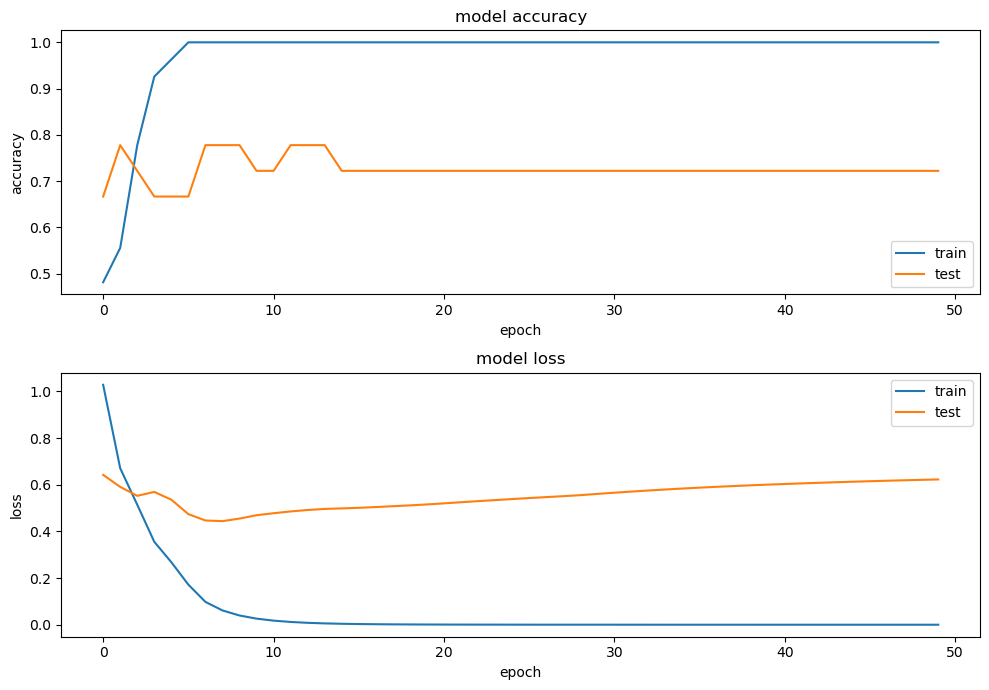

In [142]:
result_mi_train,result_mi_test = nn_report(y_train_encoded, y_test_encoded,history, X_train, X_test, target, result_mi_train,result_mi_test, numclass , model)

## **Non-MI MI**

In [143]:
# --- Data Details --- 
subject_id = ["001"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['non-MI','MI']
numclass = [1,2]

In [144]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took 6

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 14 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 3 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating rejection dictionary for eeg
0 bad 

In [145]:
result_nonmi_train = [[],[],[],[]]
result_nonmi_test = [[],[],[],[]]

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

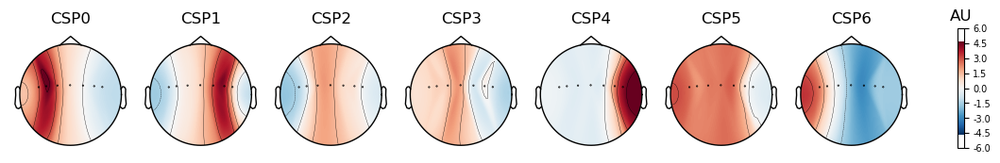

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [146]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [147]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [148]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [149]:
result_nonmi_train, result_nonmi_test = svm(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6728479853479854
recall: 0.6730769230769231
f1_score: 0.6727130012844298
              precision    recall  f1-score   support

      non-MI       0.67      0.64      0.65        25
          MI       0.68      0.70      0.69        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[16  9]
 [ 8 19]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.6

In [150]:
result_nonmi_train, result_nonmi_test = lda(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.7307692307692307
precision: 0.731345865528774
recall: 0.7307692307692307
f1_score: 0.7299679487179488
              precision    recall  f1-score   support

      non-MI       0.74      0.68      0.71        25
          MI       0.72      0.78      0.75        27

    accuracy                           0.73        52
   macro avg       0.73      0.73      0.73        52
weighted avg       0.73      0.73      0.73        52

Confusion matrix 
[[17  8]
 [ 6 21]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.6027972027972028
recall: 0.6
f1_score: 0.5933333333333333
              precision    recall  f1-score   support

      non-MI       0.62      0.47      0.53        17
          MI       0.59      0.72      0.65        18

    accuracy                           0.60        35
   macro avg       0.60      0.60      0.59        35
weighted avg       0

In [151]:
result_nonmi_train, result_nonmi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6738165680473374
recall: 0.6730769230769231
f1_score: 0.6731978713110787
              precision    recall  f1-score   support

      non-MI       0.65      0.68      0.67        25
          MI       0.69      0.67      0.68        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[17  8]
 [ 9 18]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35
weig

In [152]:
result_nonmi_train, result_nonmi_test = naive(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.6538461538461539
precision: 0.6538461538461539
recall: 0.6538461538461539
f1_score: 0.6538461538461539
              precision    recall  f1-score   support

      non-MI       0.64      0.64      0.64        25
          MI       0.67      0.67      0.67        27

    accuracy                           0.65        52
   macro avg       0.65      0.65      0.65        52
weighted avg       0.65      0.65      0.65        52

Confusion matrix 
[[16  9]
 [ 9 18]]
----------------Test set:----------------
Accuracy: 0.5714285714285714
precision: 0.5714285714285714
recall: 0.5714285714285714
f1_score: 0.5671747607231478
              precision    recall  f1-score   support

      non-MI       0.57      0.47      0.52        17
          MI       0.57      0.67      0.62        18

    accuracy                           0.57        35
   macro avg       0.57      0.57      0.57        35
weighted avg

In [153]:
result_nonmi_train, result_nonmi_test = knn(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.8076923076923077
precision: 0.8140730237504431
recall: 0.8076923076923077
f1_score: 0.8059624034136779
              precision    recall  f1-score   support

      non-MI       0.86      0.72      0.78        25
          MI       0.77      0.89      0.83        27

    accuracy                           0.81        52
   macro avg       0.82      0.80      0.81        52
weighted avg       0.81      0.81      0.81        52

Confusion matrix 
[[18  7]
 [ 3 24]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.6306122448979591
recall: 0.6285714285714286
f1_score: 0.6248847926267281
              precision    recall  f1-score   support

      non-MI       0.64      0.53      0.58        17
          MI       0.62      0.72      0.67        18

    accuracy                           0.63        35
   macro avg       0.63      0.63      0.62        3

In [154]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


 dense_39 (Dense)            (None, 32)                256       
                                                                 
 dense_40 (Dense)            (None, 16)                528       
                                                                 
 dense_41 (Dense)            (None, 2)                 34        
                                                                 
Total params: 818
Trainable params: 818
Non-trainable params: 0
_________________________________________________________________


In [155]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 538ms/step - loss: 0.6912 - accuracy: 0.5192 - val_loss: 0.7135 - val_accuracy: 0.5143
Epoch 2/50
1/1 [==============================] - 0s 42ms/step - loss: 0.6880 - accuracy: 0.5192 - val_loss: 0.7121 - val_accuracy: 0.5143
Epoch 3/50
1/1 [==============================] - 0s 35ms/step - loss: 0.6848 - accuracy: 0.5192 - val_loss: 0.7106 - val_accuracy: 0.5143
Epoch 4/50
1/1 [==============================] - 0s 36ms/step - loss: 0.6819 - accuracy: 0.5192 - val_loss: 0.7091 - val_accuracy: 0.5143
Epoch 5/50
1/1 [==============================] - 0s 37ms/step - loss: 0.6791 - accuracy: 0.5192 - val_loss: 0.7078 - val_accuracy: 0.5143
Epoch 6/50
1/1 [==============================] - 0s 35ms/step - loss: 0.6764 - accuracy: 0.5192 - val_loss: 0.7066 - val_accuracy: 0.5143
Epoch 7/50
1/1 [==============================] - 0s 36ms/step - loss: 0.6736 - accuracy: 0.5192 - val_loss: 0.7054 - val_accuracy: 0.5143
Epoch 8/50
1/1 [==========

2/2 [==============================] - 0s 2ms/step
--------------Training set:--------------
Accuracy: 0.75
precision: 0.78125
recall: 0.75
f1_score: 0.740418118466899
              precision    recall  f1-score   support

      non-MI       0.88      0.56      0.68        25
          MI       0.69      0.93      0.79        27

    accuracy                           0.75        52
   macro avg       0.78      0.74      0.74        52
weighted avg       0.78      0.75      0.74        52

Confusion matrix 
[[14 11]
 [ 2 25]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.7488095238095239
recall: 0.6857142857142857
f1_score: 0.6605714285714287
              precision    recall  f1-score   support

      non-MI       0.88      0.41      0.56        17
          MI       0.63      0.94      0.76        18

    accuracy                           0.69        35
   macro avg       0.75      0.68      0.66        35
weighted avg       0.75      0.69      

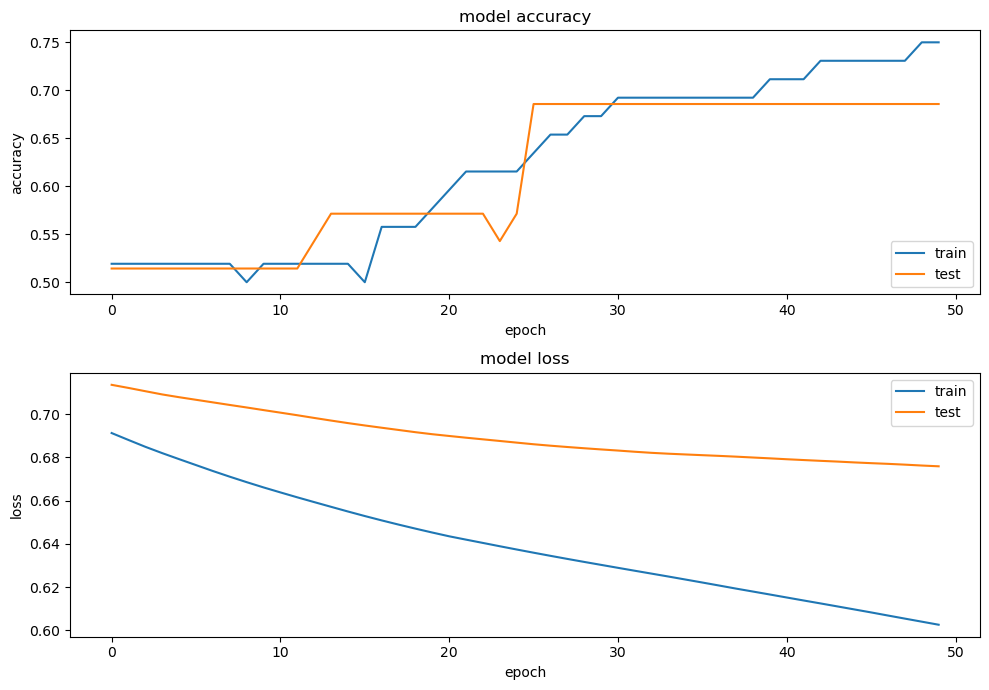

In [156]:
result_nonmi_train, result_nonmi_test = nn_report(y_train_encoded, y_test_encoded,history, X_train, X_test, target, result_nonmi_train, result_nonmi_test , numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

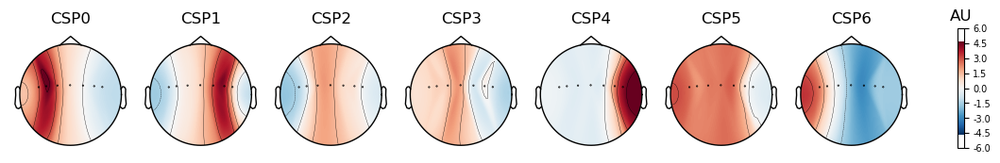

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [157]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [158]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [159]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[0,1])

In [160]:
result_nonmi_train, result_nonmi_test = svm(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.6923076923076923
precision: 0.6925383462115098
recall: 0.6923076923076923
f1_score: 0.6913919413919414
              precision    recall  f1-score   support

      non-MI       0.70      0.64      0.67        25
          MI       0.69      0.74      0.71        27

    accuracy                           0.69        52
   macro avg       0.69      0.69      0.69        52
weighted avg       0.69      0.69      0.69        52

Confusion matrix 
[[16  9]
 [ 7 20]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.6

In [161]:
result_nonmi_train, result_nonmi_test = lda(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6728479853479854
recall: 0.6730769230769231
f1_score: 0.6727130012844298
              precision    recall  f1-score   support

      non-MI       0.67      0.64      0.65        25
          MI       0.68      0.70      0.69        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[16  9]
 [ 8 19]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64

In [162]:
result_nonmi_train, result_nonmi_test = logistic_regression(X_train, X_test, y_train, y_test, target,result_nonmi_train, result_nonmi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6728479853479854
recall: 0.6730769230769231
f1_score: 0.6727130012844298
              precision    recall  f1-score   support

      non-MI       0.67      0.64      0.65        25
          MI       0.68      0.70      0.69        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[16  9]
 [ 8 19]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35
weig

In [163]:
result_nonmi_train, result_nonmi_test = naive(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.7115384615384616
precision: 0.7114239926739927
recall: 0.7115384615384616
f1_score: 0.711217354074497
              precision    recall  f1-score   support

      non-MI       0.71      0.68      0.69        25
          MI       0.71      0.74      0.73        27

    accuracy                           0.71        52
   macro avg       0.71      0.71      0.71        52
weighted avg       0.71      0.71      0.71        52

Confusion matrix 
[[17  8]
 [ 7 20]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35
weighted avg 

In [165]:
result_nonmi_train, result_nonmi_test = knn(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.7692307692307693
precision: 0.7701533848460385
recall: 0.7692307692307693
f1_score: 0.768543956043956
              precision    recall  f1-score   support

      non-MI       0.78      0.72      0.75        25
          MI       0.76      0.81      0.79        27

    accuracy                           0.77        52
   macro avg       0.77      0.77      0.77        52
weighted avg       0.77      0.77      0.77        52

Confusion matrix 
[[18  7]
 [ 5 22]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.6485714285714285
recall: 0.6285714285714286
f1_score: 0.6106558385628154
              precision    recall  f1-score   support

      non-MI       0.70      0.41      0.52        17
          MI       0.60      0.83      0.70        18

    accuracy                           0.63        35
   macro avg       0.65      0.62      0.61        35

In [166]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_42 (Dense)            (None, 32)                96        
                                                                 
 dense_43 (Dense)            (None, 16)                528       
                                                                 
 dense_44 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [167]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100


1/1 [==============================] - 1s 570ms/step - loss: 0.7071 - accuracy: 0.4808 - val_loss: 0.7040 - val_accuracy: 0.4857
Epoch 2/100
1/1 [==============================] - 0s 33ms/step - loss: 0.7039 - accuracy: 0.4808 - val_loss: 0.7013 - val_accuracy: 0.5143
Epoch 3/100
1/1 [==============================] - 0s 32ms/step - loss: 0.7008 - accuracy: 0.4808 - val_loss: 0.6989 - val_accuracy: 0.5143
Epoch 4/100
1/1 [==============================] - 0s 32ms/step - loss: 0.6977 - accuracy: 0.4808 - val_loss: 0.6965 - val_accuracy: 0.5714
Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 0.6947 - accuracy: 0.5000 - val_loss: 0.6941 - val_accuracy: 0.5714
Epoch 6/100
1/1 [==============================] - 0s 32ms/step - loss: 0.6916 - accuracy: 0.4808 - val_loss: 0.6916 - val_accuracy: 0.5429
Epoch 7/100
1/1 [==============================] - 0s 38ms/step - loss: 0.6886 - accuracy: 0.5000 - val_loss: 0.6892 - val_accuracy: 0.5143
Epoch 8/100
1/1 [==============

2/2 [==============================] - 0s 2ms/step
--------------Training set:--------------
Accuracy: 0.7307692307692307
precision: 0.7347867186576864
recall: 0.7307692307692307
f1_score: 0.728347364779149
              precision    recall  f1-score   support

      non-MI       0.76      0.64      0.70        25
          MI       0.71      0.81      0.76        27

    accuracy                           0.73        52
   macro avg       0.74      0.73      0.73        52
weighted avg       0.73      0.73      0.73        52

Confusion matrix 
[[16  9]
 [ 5 22]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.7177142857142857
recall: 0.6857142857142857
f1_score: 0.6705549403223822
              precision    recall  f1-score   support

      non-MI       0.80      0.47      0.59        17
          MI       0.64      0.89      0.74        18

    accuracy                           0.69        35
   macro avg       0.72      0.68      0.67        35


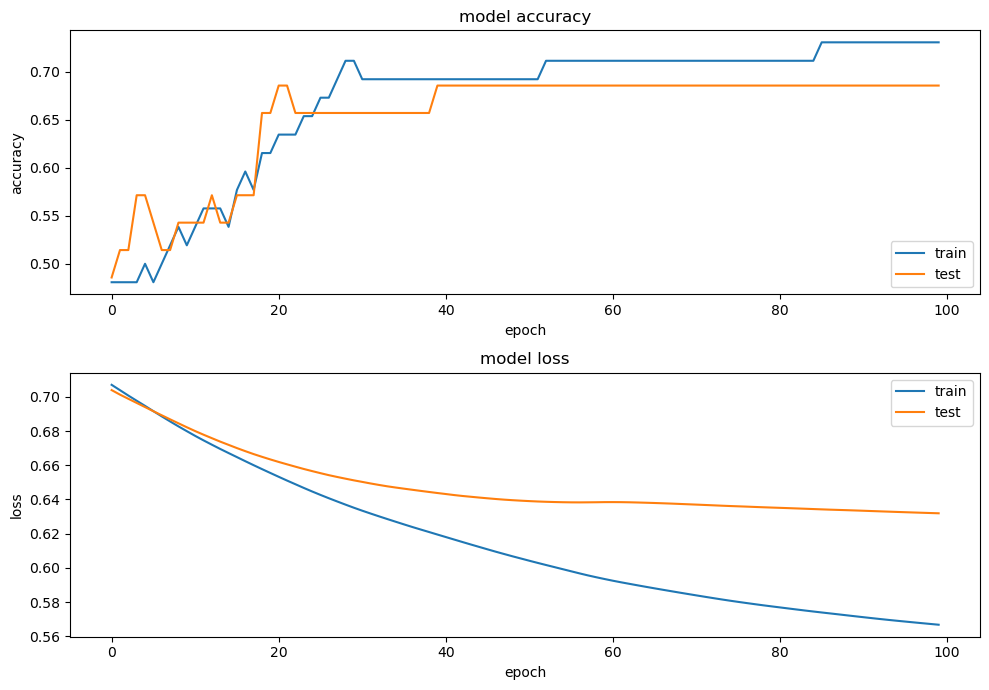

In [168]:
result_nonmi_train, result_nonmi_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_nonmi_train, result_nonmi_test, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

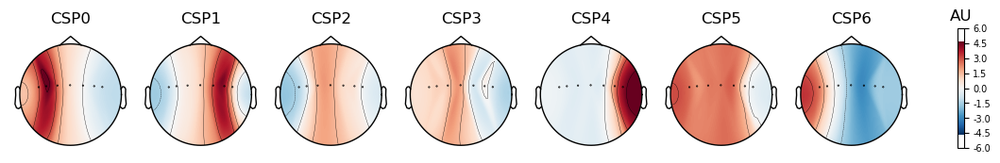

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [169]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [170]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [171]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [172]:
subset = mRMR_csp(csp,np.array(X_train),np.array(y_train),k=2)
subset

X_train, X_test = X_train[subset], X_test[subset]

100%|██████████| 2/2 [00:01<00:00,  1.46it/s]


In [173]:
result_nonmi_train, result_nonmi_test = svm(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.6923076923076923
precision: 0.6925383462115098
recall: 0.6923076923076923
f1_score: 0.6913919413919414
              precision    recall  f1-score   support

      non-MI       0.70      0.64      0.67        25
          MI       0.69      0.74      0.71        27

    accuracy                           0.69        52
   macro avg       0.69      0.69      0.69        52
weighted avg       0.69      0.69      0.69        52

Confusion matrix 
[[16  9]
 [ 7 20]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.6

In [174]:
result_nonmi_train, result_nonmi_test = lda(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6728479853479854
recall: 0.6730769230769231
f1_score: 0.6727130012844298
              precision    recall  f1-score   support

      non-MI       0.67      0.64      0.65        25
          MI       0.68      0.70      0.69        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[16  9]
 [ 8 19]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64

In [175]:
result_nonmi_train, result_nonmi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.6730769230769231
precision: 0.6728479853479854
recall: 0.6730769230769231
f1_score: 0.6727130012844298
              precision    recall  f1-score   support

      non-MI       0.67      0.64      0.65        25
          MI       0.68      0.70      0.69        27

    accuracy                           0.67        52
   macro avg       0.67      0.67      0.67        52
weighted avg       0.67      0.67      0.67        52

Confusion matrix 
[[16  9]
 [ 8 19]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35
weig

In [176]:
result_nonmi_train, result_nonmi_test = naive(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.7115384615384616
precision: 0.7114239926739927
recall: 0.7115384615384616
f1_score: 0.711217354074497
              precision    recall  f1-score   support

      non-MI       0.71      0.68      0.69        25
          MI       0.71      0.74      0.73        27

    accuracy                           0.71        52
   macro avg       0.71      0.71      0.71        52
weighted avg       0.71      0.71      0.71        52

Confusion matrix 
[[17  8]
 [ 7 20]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35
weighted avg 

In [177]:
result_nonmi_train, result_nonmi_test = knn(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.7692307692307693
precision: 0.7701533848460385
recall: 0.7692307692307693
f1_score: 0.768543956043956
              precision    recall  f1-score   support

      non-MI       0.78      0.72      0.75        25
          MI       0.76      0.81      0.79        27

    accuracy                           0.77        52
   macro avg       0.77      0.77      0.77        52
weighted avg       0.77      0.77      0.77        52

Confusion matrix 
[[18  7]
 [ 5 22]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.6485714285714285
recall: 0.6285714285714286
f1_score: 0.6106558385628154
              precision    recall  f1-score   support

      non-MI       0.70      0.41      0.52        17
          MI       0.60      0.83      0.70        18

    accuracy                           0.63        35
   macro avg       0.65      0.62      0.61        35

In [178]:
#create model
model = Sequential()
#add model layers
model.add(Dense(32, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_45 (Dense)            (None, 32)                96        
                                                                 
 dense_46 (Dense)            (None, 16)                528       
                                                                 
 dense_47 (Dense)            (None, 2)                 34        
                                                                 
Total params: 658
Trainable params: 658
Non-trainable params: 0
_________________________________________________________________


In [179]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=60,batch_size = X_train.shape[0])

Epoch 1/60
1/1 [==============================] - 1s 568ms/step - loss: 0.6880 - accuracy: 0.5385 - val_loss: 0.6858 - val_accuracy: 0.5714
Epoch 2/60
1/1 [==============================] - 0s 32ms/step - loss: 0.6851 - accuracy: 0.5577 - val_loss: 0.6842 - val_accuracy: 0.5714
Epoch 3/60
1/1 [==============================] - 0s 34ms/step - loss: 0.6827 - accuracy: 0.5577 - val_loss: 0.6827 - val_accuracy: 0.5714
Epoch 4/60
1/1 [==============================] - 0s 37ms/step - loss: 0.6805 - accuracy: 0.5577 - val_loss: 0.6814 - val_accuracy: 0.5714
Epoch 5/60
1/1 [==============================] - 0s 39ms/step - loss: 0.6783 - accuracy: 0.5577 - val_loss: 0.6801 - val_accuracy: 0.6000
Epoch 6/60
1/1 [==============================] - 0s 36ms/step - loss: 0.6763 - accuracy: 0.5769 - val_loss: 0.6789 - val_accuracy: 0.6000
Epoch 7/60
1/1 [==============================] - 0s 37ms/step - loss: 0.6742 - accuracy: 0.5962 - val_loss: 0.6777 - val_accuracy: 0.6000
Epoch 8/60
1/1 [==========

2/2 [==============================] - 0s 2ms/step
--------------Training set:--------------
Accuracy: 0.7115384615384616
precision: 0.7131118881118881
recall: 0.7115384615384616
f1_score: 0.7099233353432681
              precision    recall  f1-score   support

      non-MI       0.73      0.64      0.68        25
          MI       0.70      0.78      0.74        27

    accuracy                           0.71        52
   macro avg       0.71      0.71      0.71        52
weighted avg       0.71      0.71      0.71        52

Confusion matrix 
[[16  9]
 [ 6 21]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6746753246753247
recall: 0.6571428571428571
f1_score: 0.6448979591836734
              precision    recall  f1-score   support

      non-MI       0.73      0.47      0.57        17
          MI       0.62      0.83      0.71        18

    accuracy                           0.66        35
   macro avg       0.68      0.65      0.64        35

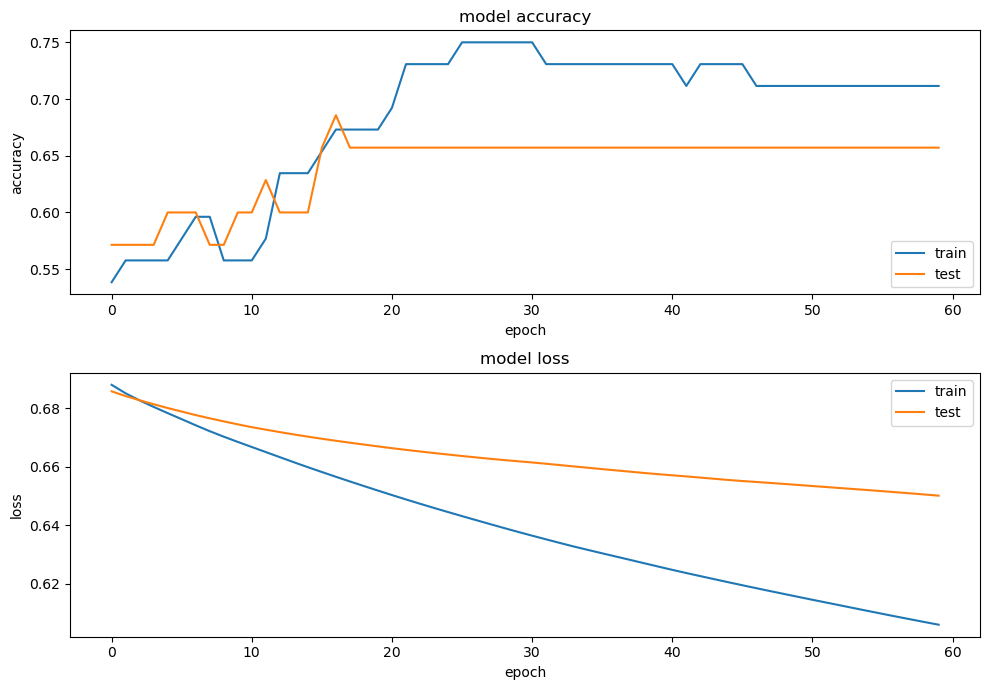

In [180]:
result_nonmi_train, result_nonmi_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_nonmi_train, result_nonmi_test, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

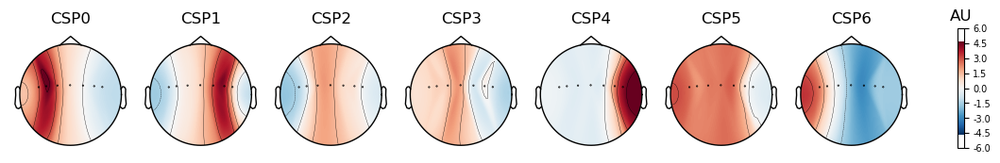

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


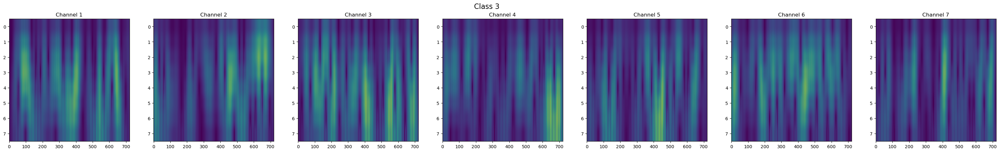

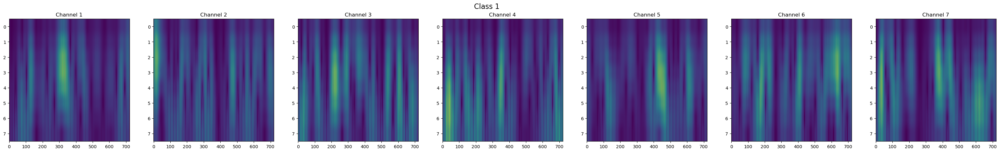

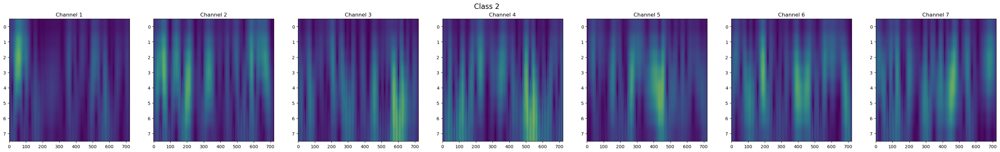

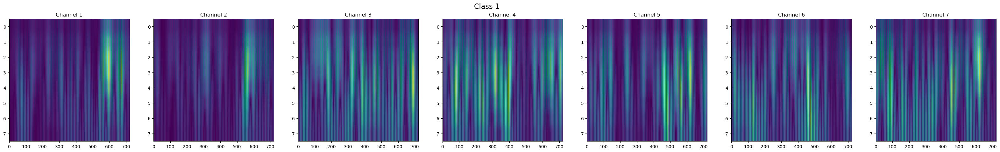

In [181]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [182]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [183]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [184]:
result_nonmi_train, result_nonmi_test = svm(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

      non-MI       1.00      1.00      1.00        25
          MI       1.00      1.00      1.00        27

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.6996894409937888
recall: 0.6857142857142857
f1_score: 0.6777844527213747
              precision    recall  f1-score   support

      non-MI       0.75      0.53      0.62        17
          MI       0.65      0.83      0.73        18

    accuracy                           0.69        35
   macro avg       0.70      0.68      0.68        35
weighted avg       0.70     

In [185]:
result_nonmi_train, result_nonmi_test = lda(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.6923076923076923
precision: 0.6925383462115098
recall: 0.6923076923076923
f1_score: 0.6913919413919414
              precision    recall  f1-score   support

      non-MI       0.70      0.64      0.67        25
          MI       0.69      0.74      0.71        27

    accuracy                           0.69        52
   macro avg       0.69      0.69      0.69        52
weighted avg       0.69      0.69      0.69        52

Confusion matrix 
[[16  9]
 [ 7 20]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.7177142857142857
recall: 0.6857142857142857
f1_score: 0.6705549403223822
              precision    recall  f1-score   support

      non-MI       0.80      0.47      0.59        17
          MI       0.64      0.89      0.74        18

    accuracy                           0.69        35
   macro avg       0.72      0.68      0.67

In [186]:
result_nonmi_train, result_nonmi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

      non-MI       1.00      1.00      1.00        25
          MI       1.00      1.00      1.00        27

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6571428571428571
precision: 0.6635364635364636
recall: 0.6571428571428571
f1_score: 0.6514285714285714
              precision    recall  f1-score   support

      non-MI       0.69      0.53      0.60        17
          MI       0.64      0.78      0.70        18

    accuracy                           0.66        35
   macro avg       0.66      0.65      0.65        35
weighted avg       0.66      0.66      0.65        35

Confusion

In [187]:
result_nonmi_train, result_nonmi_test = naive(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.9807692307692307
precision: 0.9814560439560439
recall: 0.9807692307692307
f1_score: 0.9807478236049664
              precision    recall  f1-score   support

      non-MI       1.00      0.96      0.98        25
          MI       0.96      1.00      0.98        27

    accuracy                           0.98        52
   macro avg       0.98      0.98      0.98        52
weighted avg       0.98      0.98      0.98        52

Confusion matrix 
[[24  1]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.6897959183673469
recall: 0.6857142857142857
f1_score: 0.6825948245303083
              precision    recall  f1-score   support

      non-MI       0.71      0.59      0.65        17
          MI       0.67      0.78      0.72        18

    accuracy                           0.69        35
   macro avg       0.69      0.68      0.68        35
weighted avg

In [188]:
result_nonmi_train, result_nonmi_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.75
precision: 0.83125
recall: 0.75
f1_score: 0.7303348124243647
              precision    recall  f1-score   support

      non-MI       1.00      0.48      0.65        25
          MI       0.68      1.00      0.81        27

    accuracy                           0.75        52
   macro avg       0.84      0.74      0.73        52
weighted avg       0.83      0.75      0.73        52

Confusion matrix 
[[12 13]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.775
recall: 0.6
f1_score: 0.516
              precision    recall  f1-score   support

      non-MI       1.00      0.18      0.30        17
          MI       0.56      1.00      0.72        18

    accuracy                           0.60        35
   macro avg       0.78      0.59      0.51        35
weighted avg       0.78      0.60      0.52        35

Confusion matrix 
[[ 3 14]
 [ 0 18]]



In [189]:
#create model
model = Sequential()
#add model layers
model.add(Dense(512, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_48 (Dense)            (None, 512)               20673024  
                                                                 
 dense_49 (Dense)            (None, 128)               65664     
                                                                 
 dense_50 (Dense)            (None, 32)                4128      
                                                                 
 dense_51 (Dense)            (None, 8)                 264       
                                                                 
 dense_52 (Dense)            (None, 2)                 18        
                                                                 
Total params: 20,743,098
Trainable params: 20,743,098
Non-trainable params: 0
_________________________________________________________________


In [190]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70


1/1 [==============================] - 1s 648ms/step - loss: 3.1828 - accuracy: 0.4808 - val_loss: 6.6535 - val_accuracy: 0.5143
Epoch 2/70
1/1 [==============================] - 0s 67ms/step - loss: 7.0557 - accuracy: 0.5192 - val_loss: 0.7095 - val_accuracy: 0.5143
Epoch 3/70
1/1 [==============================] - 0s 62ms/step - loss: 0.6929 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.5143
Epoch 4/70
1/1 [==============================] - 0s 65ms/step - loss: 0.6931 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.5143
Epoch 5/70
1/1 [==============================] - 0s 65ms/step - loss: 0.6931 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.5143
Epoch 6/70
1/1 [==============================] - 0s 72ms/step - loss: 0.6931 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.5143
Epoch 7/70
1/1 [==============================] - 0s 63ms/step - loss: 0.6931 - accuracy: 0.5192 - val_loss: 0.6931 - val_accuracy: 0.5143
Epoch 8/70
1/1 [=====================

2/2 [==============================] - 0s 119ms/step
--------------Training set:--------------
Accuracy: 0.5192307692307693
precision: 0.26960059171597633
recall: 0.5192307692307693
f1_score: 0.35491723466407016
              precision    recall  f1-score   support

      non-MI       0.00      0.00      0.00        25
          MI       0.52      1.00      0.68        27

    accuracy                           0.52        52
   macro avg       0.26      0.50      0.34        52
weighted avg       0.27      0.52      0.35        52

Confusion matrix 
[[ 0 25]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.5142857142857142
precision: 0.2644897959183673
recall: 0.5142857142857142
f1_score: 0.34932614555256064
              precision    recall  f1-score   support

      non-MI       0.00      0.00      0.00        17
          MI       0.51      1.00      0.68        18

    accuracy                           0.51        35
   macro avg       0.26      0.50      0.34     

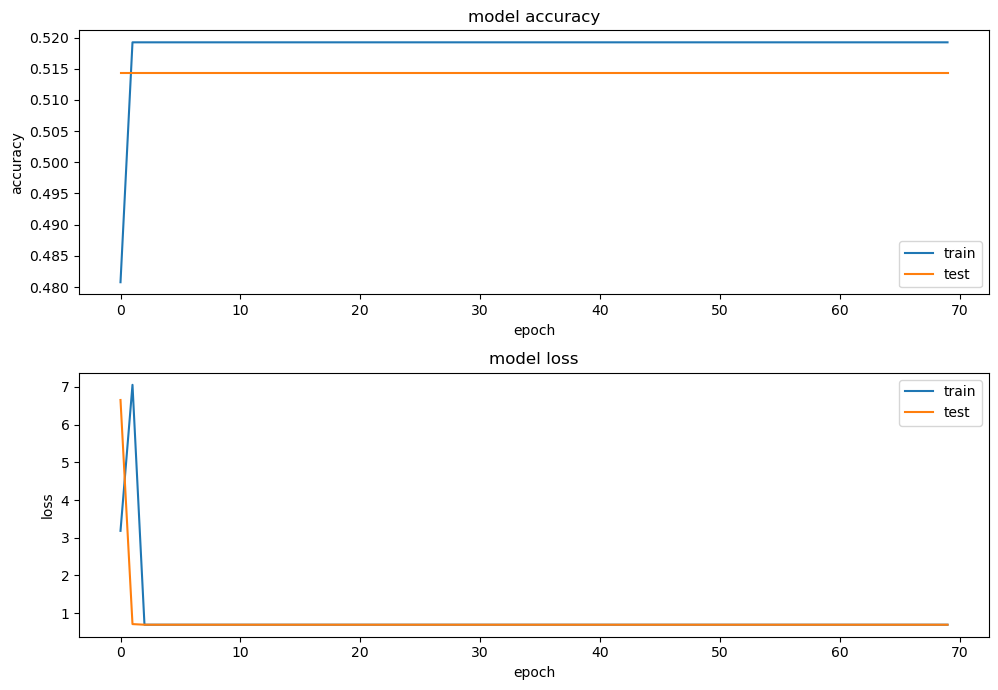

In [191]:
result_nonmi_train, result_nonmi_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target,result_nonmi_train, result_nonmi_test, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.7e-06 (2.2e-16 eps * 7 dim * 1.1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.6e-06 (2.2e-16 eps * 7 dim * 1e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.5e-06 (2.2e-16 eps * 7 dim * 1.6e+09  max singular value)
    Estimated rank (m

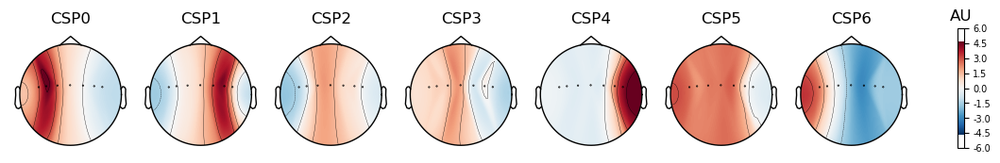

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


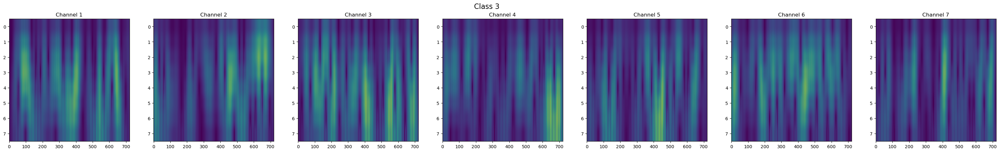

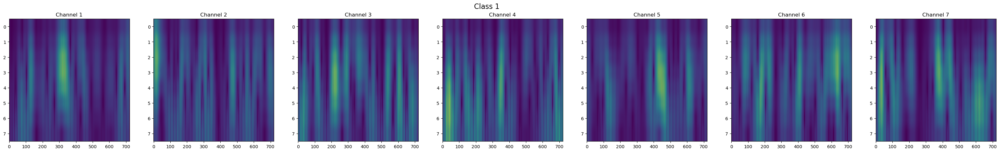

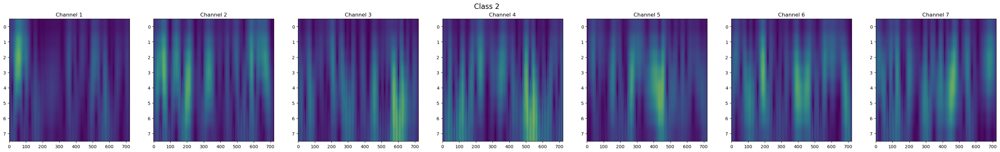

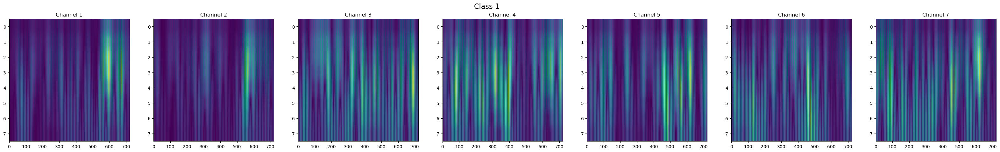

In [192]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [193]:
y_mi = y
y = [2 if i == 3 else i for i in y_mi]

In [194]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [195]:
subset = mRMR_WT(np.array(X_train), np.array(y_train),k= 1000)

100%|██████████| 1000/1000 [53:18<00:00,  3.20s/it]


[6781, 9540, 12807, 23815, 20656, 1841, 649, 26482, 7502, 20115, 6766, 19936, 1120, 36509, 2236, 7494, 2569, 31567, 9547, 6060, 1370, 19943, 39071, 2562, 20568, 6773, 15497, 655, 6787, 20108, 1848, 6045, 3613, 8215, 35788, 38121, 1191, 10268, 2777, 188, 19215, 399, 35067, 1376, 7508, 19299, 21289, 3383, 21786, 39063, 2563, 30132, 470, 37230, 2576, 16837, 6052, 19387, 21297, 643, 394, 3621, 6066, 7487, 28522, 10260, 1185, 35794, 1842, 20109, 3605, 6775, 1121, 19847, 31553, 20116, 2907, 6067, 2570, 8826, 7495, 19935, 26474, 30853, 1115, 2097, 39792, 16838, 464, 20576, 1843, 36646, 16218, 7500, 19298, 2900, 1899, 28659, 3283, 36515, 37400, 10989, 6788, 1847, 7052, 7488, 2914, 1919, 37229, 29618, 3291, 30847, 400, 18666, 6794, 19222, 6760, 38342, 18577, 2613, 35925, 21065, 8222, 20575, 1377, 28513, 4938, 909, 1836, 36508, 19305, 7496, 2892, 16847, 471, 3290, 2098, 1081, 26099, 1912, 29411, 26475, 19388, 1126, 1364, 10973, 1515, 7501, 2056, 35073, 1198, 22010, 39571, 38350, 654, 36502, 2066

In [196]:
X_train = X_train[subset]
X_test = X_test[subset]

In [197]:
result_nonmi_train, result_nonmi_test = svm(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

      non-MI       1.00      1.00      1.00        25
          MI       1.00      1.00      1.00        27

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.7428571428571429
precision: 0.7489795918367347
recall: 0.7428571428571429
f1_score: 0.7403048564338887
              precision    recall  f1-score   support

      non-MI       0.79      0.65      0.71        17
          MI       0.71      0.83      0.77        18

    accuracy                           0.74        35
   macro avg       0.75      0.74      0.74        35
weighted avg       0.75     

In [198]:
result_nonmi_train, result_nonmi_test = lda(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.9615384615384616
precision: 0.9615384615384616
recall: 0.9615384615384616
f1_score: 0.9615384615384616
              precision    recall  f1-score   support

      non-MI       0.96      0.96      0.96        25
          MI       0.96      0.96      0.96        27

    accuracy                           0.96        52
   macro avg       0.96      0.96      0.96        52
weighted avg       0.96      0.96      0.96        52

Confusion matrix 
[[24  1]
 [ 1 26]]
----------------Test set:----------------
Accuracy: 0.7428571428571429
precision: 0.7868571428571428
recall: 0.7428571428571429
f1_score: 0.7304540420819491
              precision    recall  f1-score   support

      non-MI       0.90      0.53      0.67        17
          MI       0.68      0.94      0.79        18

    accuracy                           0.74        35
   macro avg       0.79      0.74      0.73

In [199]:
result_nonmi_train, result_nonmi_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

      non-MI       1.00      1.00      1.00        25
          MI       1.00      1.00      1.00        27

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.7714285714285715
precision: 0.7742857142857144
recall: 0.7714285714285715
f1_score: 0.7703007518796993
              precision    recall  f1-score   support

      non-MI       0.80      0.71      0.75        17
          MI       0.75      0.83      0.79        18

    accuracy                           0.77        35
   macro avg       0.78      0.77      0.77        35
weighted avg       0.77      0.77      0.77        35

Confusion

In [200]:
result_nonmi_train, result_nonmi_test = naive(X_train, X_test, y_train, y_test, target, result_nonmi_train, result_nonmi_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.9807692307692307
precision: 0.9814560439560439
recall: 0.9807692307692307
f1_score: 0.9807478236049664
              precision    recall  f1-score   support

      non-MI       1.00      0.96      0.98        25
          MI       0.96      1.00      0.98        27

    accuracy                           0.98        52
   macro avg       0.98      0.98      0.98        52
weighted avg       0.98      0.98      0.98        52

Confusion matrix 
[[24  1]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6857142857142857
precision: 0.6858082706766918
recall: 0.6857142857142857
f1_score: 0.6851994851994851
              precision    recall  f1-score   support

      non-MI       0.69      0.65      0.67        17
          MI       0.68      0.72      0.70        18

    accuracy                           0.69        35
   macro avg       0.69      0.68      0.68        35
weighted avg

In [201]:
result_nonmi_train, result_nonmi_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target,result_nonmi_train, result_nonmi_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.9615384615384616
precision: 0.9641909814323608
recall: 0.9615384615384616
f1_score: 0.9614239926739927
              precision    recall  f1-score   support

      non-MI       1.00      0.92      0.96        25
          MI       0.93      1.00      0.96        27

    accuracy                           0.96        52
   macro avg       0.97      0.96      0.96        52
weighted avg       0.96      0.96      0.96        52

Confusion matrix 
[[23  2]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6
precision: 0.68
recall: 0.6
f1_score: 0.5409090909090909
              precision    recall  f1-score   support

      non-MI       0.80      0.24      0.36        17
          MI       0.57      0.94      0.71        18

    accuracy                           0.60        35
   macro avg       0.68      0.59      0.54        35
weighted avg       0.68      0.60      0.5

In [202]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_53 (Dense)            (None, 64)                64064     
                                                                 
 dense_54 (Dense)            (None, 32)                2080      
                                                                 
 dense_55 (Dense)            (None, 16)                528       
                                                                 
 dense_56 (Dense)            (None, 2)                 34        
                                                                 
Total params: 66,706
Trainable params: 66,706
Non-trainable params: 0
_________________________________________________________________


In [203]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 1s 824ms/step - loss: 1.0814 - accuracy: 0.5769 - val_loss: 1.0851 - val_accuracy: 0.5429
Epoch 2/50
1/1 [==============================] - 0s 67ms/step - loss: 1.2016 - accuracy: 0.5000 - val_loss: 0.7256 - val_accuracy: 0.6000
Epoch 3/50
1/1 [==============================] - 0s 287ms/step - loss: 0.6062 - accuracy: 0.6346 - val_loss: 1.0305 - val_accuracy: 0.4000
Epoch 4/50
1/1 [==============================] - 0s 65ms/step - loss: 0.5269 - accuracy: 0.7500 - val_loss: 1.1641 - val_accuracy: 0.4571
Epoch 5/50
1/1 [==============================] - 0s 164ms/step - loss: 0.5462 - accuracy: 0.6731 - val_loss: 0.9766 - val_accuracy: 0.4571
Epoch 6/50
1/1 [==============================] - 0s 131ms/step - loss: 0.3589 - accuracy: 0.8077 - val_loss: 0.7503 - val_accuracy: 0.5714
Epoch 7/50
1/1 [==============================] - 0s 186ms/step - loss: 0.2050 - accuracy: 0.9808 - val_loss: 0.7228 - val_accuracy: 0.5429
Epoch 8/50
1/1 [======

2/2 [==============================] - 0s 112ms/step
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

      non-MI       1.00      1.00      1.00        25
          MI       1.00      1.00      1.00        27

    accuracy                           1.00        52
   macro avg       1.00      1.00      1.00        52
weighted avg       1.00      1.00      1.00        52

Confusion matrix 
[[25  0]
 [ 0 27]]
----------------Test set:----------------
Accuracy: 0.6285714285714286
precision: 0.6306122448979591
recall: 0.6285714285714286
f1_score: 0.6248847926267281
              precision    recall  f1-score   support

      non-MI       0.64      0.53      0.58        17
          MI       0.62      0.72      0.67        18

    accuracy                           0.63        35
   macro avg       0.63      0.63      0.62        35
weighted avg       0.63      0.63      0.62        35

Co

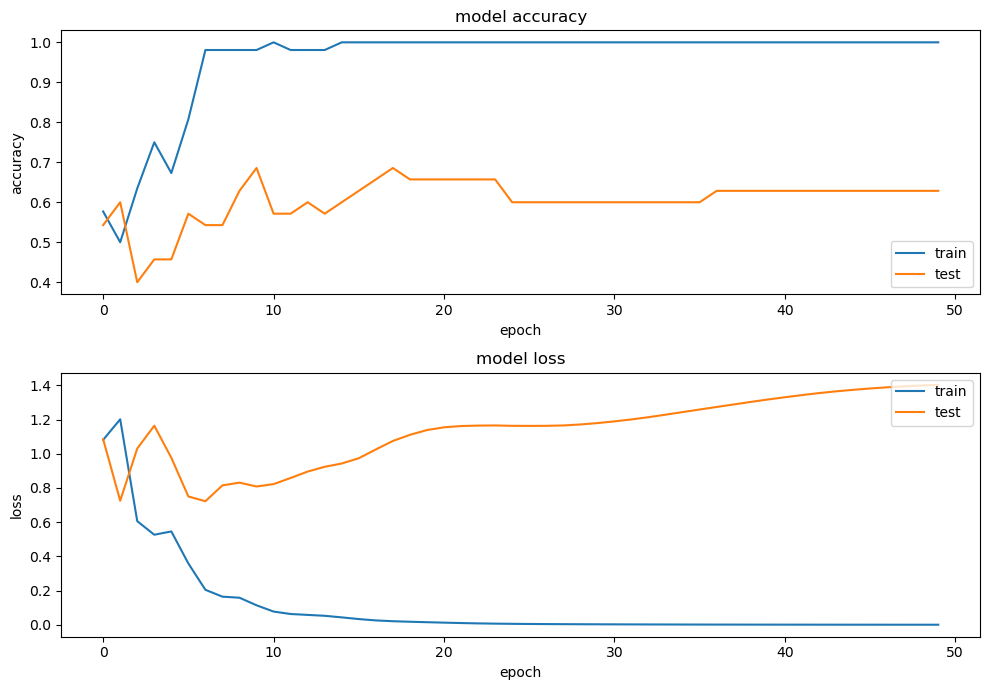

In [204]:
result_nonmi_train, result_nonmi_test = nn_report(y_train_encoded, y_test_encoded,history,X_train, X_test, target, result_nonmi_train, result_nonmi_test, numclass , model)

## **rest left right 60 paticipant**

In [205]:
# --- Data Details --- 
subject_id = ["001","002","003","004","005","006","007","008","009","010","011","012","013","014","015","016","017","018","019","020","021","022","023","024","025","026","027","028","029","030","031","032","033","034","035","036","037","038","039","040","041","042","043","044","045","046","047","048","049","050","051","052","053","054","055","056","057","058","059","060"]
task_id = ["04", "08", "12"]

# --- Set Montage ---
montage_name = 'standard_1020'

# --- Set Channels Select ---
chans_selected = ['C5','C3','C1','Cz','C2','C4','C6']

# --- Set event ---
event = {'rest':1, 'left': 2, 'right': 3}
target = ['rest', 'left', 'right']
numclass = [1,2,3]

In [206]:
raws_data = load_data(subject_id, task_id, montage_name)
epochs = preprocessing(raws_data, event, chans_selected)

EEG channel type selected for re-referencing
Adding average EEG reference projection.
1 projection items deactivated
Average reference projection was added, but has not been applied yet. Use the apply_proj method to apply it.
Created an SSP operator (subspace dimension = 1)
1 projection items activated
SSP projectors applied...
Filtering raw data in 180 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Fitting ICA to data using 64 channels (please be patient, this may take a while)
    Applying projection operator with 1 vector (pre-whitener computation)
    Applying projection operator with 1 vector (pre-whitener application)
Selecting by number: 63 components
    Applying projection operator with 1 vector (pre-whitener application)
Fitting ICA took

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done  63 out of  63 | elapsed:    6.1s finished


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 1600 samples (10.000 s)



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


Applying ICA to Raw instance
    Applying projection operator with 1 vector (pre-whitener application)
    Transforming to ICA space (63 components)
    Zeroing out 4 ICA components
    Projecting back using 64 PCA components
Used Annotations descriptions: ['T0', 'T1', 'T2']
Filtering raw data in 180 contiguous segments
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Setting up band-pass filter from 8 - 15 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 24 (effective, after forward-backward)
- Cutoffs at 8.00, 15.00 Hz: -6.02, -6.02 dB

Applying baseline correction (mode: mean)
Estimating rejec

In [207]:
result_ind_train = [[],[],[],[]]
result_ind_test = [[],[],[],[]]

### **CSP + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

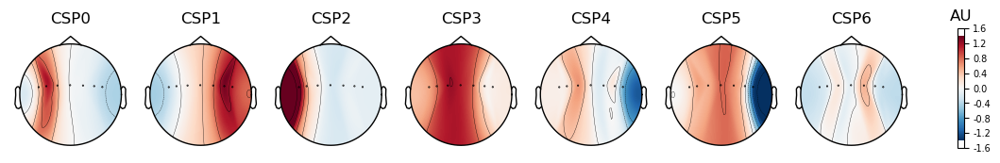

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [208]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [209]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.30,56)

In [210]:
result_ind_train,result_ind_test = svm(X_train, X_test, y_train, y_test, target,result_ind_train,result_ind_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.4767123287671233
precision: 0.22725464439857385
recall: 0.4767123287671233
f1_score: 0.3077845833227438
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       348
        left       0.00      0.00      0.00       199
       right       0.00      0.00      0.00       183

    accuracy                           0.48       730
   macro avg       0.16      0.33      0.22       730
weighted avg       0.23      0.48      0.31       730

Confusion matrix 
[[348   0   0]
 [199   0   0]
 [183   0   0]]
----------------Test set:----------------
Accuracy: 0.47770700636942676
precision: 0.22820398393443955
recall: 0.47770700636942676
f1_score: 0.3088622886009224
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       150
        left       0.00      0.00      0.00   

In [211]:
result_ind_train,result_ind_test = lda(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.4671232876712329
precision: 0.3887865506003469
recall: 0.4671232876712329
f1_score: 0.34296001584635455
              precision    recall  f1-score   support

        rest       0.48      0.93      0.63       348
        left       0.28      0.05      0.09       199
       right       0.33      0.04      0.07       183

    accuracy                           0.47       730
   macro avg       0.36      0.34      0.26       730
weighted avg       0.39      0.47      0.34       730

Confusion matrix 
[[324  15   9]
 [184  10   5]
 [165  11   7]]
----------------Test set:----------------
Accuracy: 0.49363057324840764
precision: 0.470151480404704
recall: 0.49363057324840764
f1_score: 0.3775638154821757
              precision    recall  f1-score   support

        rest       0.50      0.95      0.65       150
        left       0.44      0.09      0.16        85
       right   

In [212]:
result_ind_train,result_ind_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.46986301369863015
precision: 0.40329320603293206
recall: 0.46986301369863015
f1_score: 0.34596228595140777
              precision    recall  f1-score   support

        rest       0.48      0.93      0.64       348
        left       0.30      0.05      0.09       199
       right       0.36      0.04      0.08       183

    accuracy                           0.47       730
   macro avg       0.38      0.34      0.27       730
weighted avg       0.40      0.47      0.35       730

Confusion matrix 
[[325  14   9]
 [184  10   5]
 [166   9   8]]
----------------Test set:----------------
Accuracy: 0.4968152866242038
precision: 0.5002312903952046
recall: 0.4968152866242038
f1_score: 0.3750651949345128
              precision    recall  f1-score   support

        rest       0.50      0.97      0.66       150
        left       0.44      0.08      0.14        85
       right       0.57     

In [213]:
result_ind_train,result_ind_test = naive(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.4726027397260274
precision: 0.32284045472992345
recall: 0.4726027397260274
f1_score: 0.3431089685456541
              precision    recall  f1-score   support

        rest       0.48      0.94      0.64       348
        left       0.34      0.09      0.14       199
       right       0.00      0.00      0.00       183

    accuracy                           0.47       730
   macro avg       0.27      0.34      0.26       730
weighted avg       0.32      0.47      0.34       730

Confusion matrix 
[[327  21   0]
 [181  18   0]
 [169  14   0]]
----------------Test set:----------------
Accuracy: 0.43630573248407645
precision: 0.26225400130654913
recall: 0.43630573248407645
f1_score: 0.30962425648753195
              precision    recall  f1-score   support

        rest       0.46      0.89      0.61       150
        left       0.15      0.05      0.07        85
       right       0.00      0.00  

In [214]:
result_ind_train,result_ind_test = knn(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6671232876712329
precision: 0.6811924531102613
recall: 0.6671232876712329
f1_score: 0.6510179541071254
              precision    recall  f1-score   support

        rest       0.64      0.89      0.74       348
        left       0.74      0.49      0.59       199
       right       0.69      0.44      0.54       183

    accuracy                           0.67       730
   macro avg       0.69      0.61      0.63       730
weighted avg       0.68      0.67      0.65       730

Confusion matrix 
[[308  25  15]
 [ 80  98  21]
 [ 93   9  81]]
----------------Test set:----------------
Accuracy: 0.4554140127388535
precision: 0.4213312289866728
recall: 0.4554140127388535
f1_score: 0.4224244105456943
              precision    recall  f1-score   support

        rest       0.51      0.72      0.60       150
        left       0.32      0.19      0.24        85
       right       0.36   

In [215]:
#create model
model = Sequential()
#add model layers
model.add(Dense(150, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_57 (Dense)            (None, 150)               1200      
                                                                 
 dense_58 (Dense)            (None, 64)                9664      
                                                                 
 dense_59 (Dense)            (None, 32)                2080      
                                                                 
 dense_60 (Dense)            (None, 16)                528       
                                                                 
 dense_61 (Dense)            (None, 3)                 51        
                                                                 
Total params: 13,523
Trainable params: 13,523
Non-trainable params: 0
_________________________________________________________________


In [216]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 911ms/step - loss: 1.1388 - accuracy: 0.2507 - val_loss: 1.1186 - val_accuracy: 0.2548
Epoch 2/100
1/1 [==============================] - 0s 40ms/step - loss: 1.1190 - accuracy: 0.2562 - val_loss: 1.1058 - val_accuracy: 0.2675
Epoch 3/100
1/1 [==============================] - 0s 32ms/step - loss: 1.1054 - accuracy: 0.2890 - val_loss: 1.0975 - val_accuracy: 0.3121
Epoch 4/100
1/1 [==============================] - 0s 32ms/step - loss: 1.0967 - accuracy: 0.3288 - val_loss: 1.0926 - val_accuracy: 0.3726
Epoch 5/100
1/1 [==============================] - 0s 33ms/step - loss: 1.0913 - accuracy: 0.3699 - val_loss: 1.0893 - val_accuracy: 0.4013
Epoch 6/100
1/1 [==============================] - 0s 37ms/step - loss: 1.0874 - accuracy: 0.4082 - val_loss: 1.0869 - val_accuracy: 0.4299
Epoch 7/100
1/1 [==============================] - 0s 30ms/step - loss: 1.0842 - accuracy: 0.4425 - val_loss: 1.0846 - val_accuracy: 0.4554
Epoch 8/100
1/1 [==

23/23 [==============================] - 0s 1ms/step
--------------Training set:--------------
Accuracy: 0.5438356164383562
precision: 0.5346529731898527
recall: 0.5438356164383562
f1_score: 0.4965556639787086
              precision    recall  f1-score   support

        rest       0.56      0.87      0.68       348
        left       0.44      0.23      0.30       199
       right       0.59      0.26      0.36       183

    accuracy                           0.54       730
   macro avg       0.53      0.45      0.45       730
weighted avg       0.53      0.54      0.50       730

Confusion matrix 
[[304  26  18]
 [139  46  14]
 [104  32  47]]
----------------Test set:----------------
Accuracy: 0.4140127388535032
precision: 0.3676764688662297
recall: 0.4140127388535032
f1_score: 0.3609998504308115
              precision    recall  f1-score   support

        rest       0.47      0.73      0.57       150
        left       0.23      0.14      0.17        85
       right       0.33  

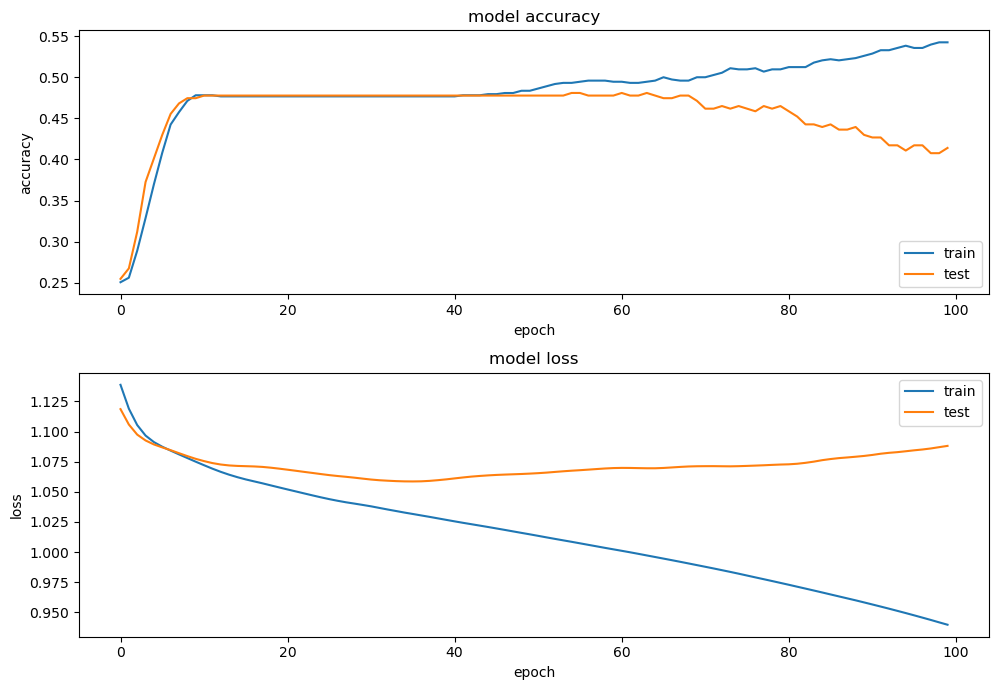

In [217]:
result_ind_train,result_ind_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_ind_train,result_ind_test, numclass , model)

### **CSP + CFS**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

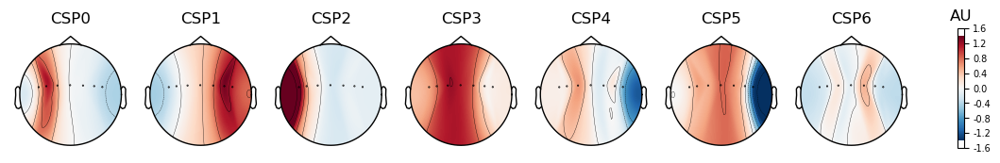

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [218]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [219]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56,subset=[2,5])

In [220]:
result_ind_train,result_ind_test = svm(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00 

In [221]:
result_ind_train,result_ind_test = lda(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       righ

In [222]:
result_ind_train,result_ind_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       right       0.00   

In [223]:
result_ind_train,result_ind_test = naive(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.48083067092651754
precision: 0.3533253520162271
recall: 0.48083067092651754
f1_score: 0.32436946467575795
              precision    recall  f1-score   support

        rest       0.48      0.99      0.65       299
        left       0.45      0.03      0.06       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.31      0.34      0.23       626
weighted avg       0.35      0.48      0.32       626

Confusion matrix 
[[296   3   0]
 [165   5   0]
 [154   3   0]]
----------------Test set:----------------
Accuracy: 0.47129186602870815
precision: 0.22544971475892525
recall: 0.47129186602870815
f1_score: 0.3049986385031314
              precision    recall  f1-score   support

        rest       0.47      0.99      0.64       199
        left       0.00      0.00      0.00       114
       right       0.00      0.00 

In [224]:
result_ind_train,result_ind_test = knn(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6805111821086262
precision: 0.6942113126204786
recall: 0.6805111821086262
f1_score: 0.6670474947338836
              precision    recall  f1-score   support

        rest       0.65      0.88      0.75       299
        left       0.74      0.51      0.60       170
       right       0.72      0.48      0.58       157

    accuracy                           0.68       626
   macro avg       0.71      0.62      0.64       626
weighted avg       0.69      0.68      0.67       626

Confusion matrix 
[[264  15  20]
 [ 75  86   9]
 [ 66  15  76]]
----------------Test set:----------------
Accuracy: 0.36363636363636365
precision: 0.31363926751232113
recall: 0.36363636363636365
f1_score: 0.3232755377911245
              precision    recall  f1-score   support

        rest       0.43      0.63      0.51       199
        left       0.21      0.11      0.15       114
       right       0.20

In [225]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_62 (Dense)            (None, 64)                192       
                                                                 
 dense_63 (Dense)            (None, 32)                2080      
                                                                 
 dense_64 (Dense)            (None, 16)                528       
                                                                 
 dense_65 (Dense)            (None, 3)                 51        
                                                                 
Total params: 2,851
Trainable params: 2,851
Non-trainable params: 0
_________________________________________________________________


In [226]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=100,batch_size = X_train.shape[0])

Epoch 1/100
1/1 [==============================] - 1s 772ms/step - loss: 1.0909 - accuracy: 0.3562 - val_loss: 1.0850 - val_accuracy: 0.4163
Epoch 2/100
1/1 [==============================] - 0s 41ms/step - loss: 1.0867 - accuracy: 0.4329 - val_loss: 1.0818 - val_accuracy: 0.4737
Epoch 3/100
1/1 [==============================] - 0s 31ms/step - loss: 1.0826 - accuracy: 0.4776 - val_loss: 1.0787 - val_accuracy: 0.4761
Epoch 4/100
1/1 [==============================] - 0s 33ms/step - loss: 1.0788 - accuracy: 0.4776 - val_loss: 1.0758 - val_accuracy: 0.4761
Epoch 5/100
1/1 [==============================] - 0s 35ms/step - loss: 1.0752 - accuracy: 0.4776 - val_loss: 1.0732 - val_accuracy: 0.4761
Epoch 6/100
1/1 [==============================] - 0s 31ms/step - loss: 1.0718 - accuracy: 0.4776 - val_loss: 1.0710 - val_accuracy: 0.4761
Epoch 7/100
1/1 [==============================] - 0s 30ms/step - loss: 1.0688 - accuracy: 0.4776 - val_loss: 1.0692 - val_accuracy: 0.4761
Epoch 8/100
1/1 [==

20/20 [==============================] - 0s 1ms/step
--------------Training set:--------------
Accuracy: 0.48722044728434505
precision: 0.34512087058013574
recall: 0.48722044728434505
f1_score: 0.347316009484666
              precision    recall  f1-score   support

        rest       0.49      0.98      0.65       299
        left       0.41      0.08      0.13       170
       right       0.00      0.00      0.00       157

    accuracy                           0.49       626
   macro avg       0.30      0.35      0.26       626
weighted avg       0.35      0.49      0.35       626

Confusion matrix 
[[292   7   0]
 [157  13   0]
 [145  12   0]]
----------------Test set:----------------
Accuracy: 0.45454545454545453
precision: 0.2540590111642743
recall: 0.45454545454545453
f1_score: 0.30710383624730503
              precision    recall  f1-score   support

        rest       0.47      0.94      0.63       199
        left       0.11      0.02      0.03       114
       right       0

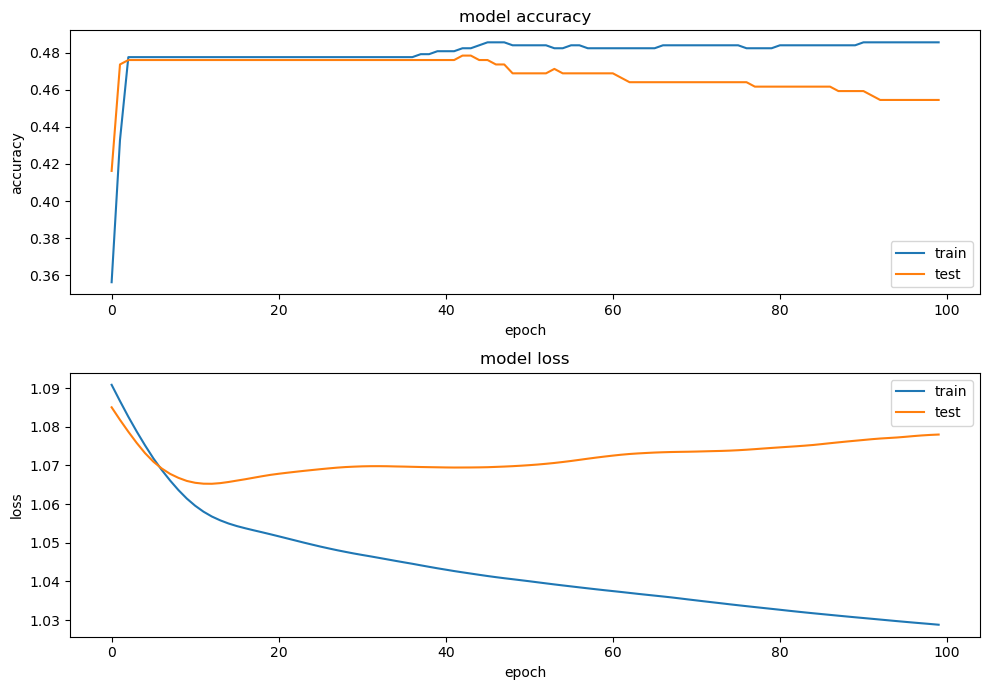

In [227]:
result_ind_train,result_ind_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_ind_train,result_ind_test, numclass , model)

### **CSP + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

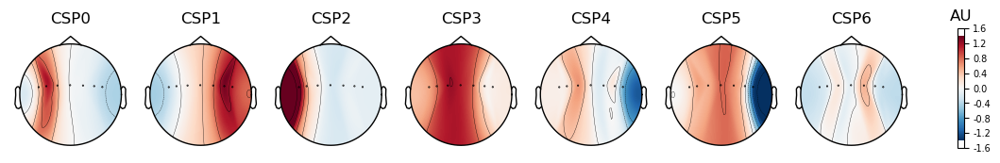

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


In [228]:
x, y, csp, csp_wt, new_data = extract_CSP(epochs, n_component = 7)

In [229]:
X_train, X_test, y_train, y_test = csp_split(csp,x,y,0.40,56)

In [230]:
subset = mRMR_csp(csp,np.array(X_train),np.array(y_train),k=2)
subset

X_train, X_test = X_train[subset], X_test[subset]

100%|██████████| 2/2 [00:01<00:00,  1.73it/s]


In [231]:
result_ind_train,result_ind_test = svm(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00 

In [232]:
result_ind_train,result_ind_test = lda(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       righ

In [233]:
result_ind_train,result_ind_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       right       0.00   

In [234]:
result_ind_train,result_ind_test = naive(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       right       0.00      0.00 

In [235]:
result_ind_train,result_ind_test = knn(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.6565495207667732
precision: 0.66996826771534
recall: 0.6565495207667732
f1_score: 0.6404413306242809
              precision    recall  f1-score   support

        rest       0.63      0.87      0.73       299
        left       0.73      0.47      0.57       170
       right       0.67      0.45      0.54       157

    accuracy                           0.66       626
   macro avg       0.68      0.60      0.61       626
weighted avg       0.67      0.66      0.64       626

Confusion matrix 
[[261  17  21]
 [ 77  80  13]
 [ 75  12  70]]
----------------Test set:----------------
Accuracy: 0.39473684210526316
precision: 0.3651959788182698
recall: 0.39473684210526316
f1_score: 0.3725432783167772
              precision    recall  f1-score   support

        rest       0.47      0.61      0.53       199
        left       0.32      0.24      0.27       114
       right       0.22   

In [236]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_66 (Dense)            (None, 128)               384       
                                                                 
 dense_67 (Dense)            (None, 32)                4128      
                                                                 
 dense_68 (Dense)            (None, 8)                 264       
                                                                 
 dense_69 (Dense)            (None, 3)                 27        
                                                                 
Total params: 4,803
Trainable params: 4,803
Non-trainable params: 0
_________________________________________________________________


In [237]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=70,batch_size = X_train.shape[0])

Epoch 1/70
1/1 [==============================] - 1s 774ms/step - loss: 1.0895 - accuracy: 0.4377 - val_loss: 1.0853 - val_accuracy: 0.4617
Epoch 2/70
1/1 [==============================] - 0s 34ms/step - loss: 1.0857 - accuracy: 0.4585 - val_loss: 1.0826 - val_accuracy: 0.4761
Epoch 3/70
1/1 [==============================] - 0s 33ms/step - loss: 1.0830 - accuracy: 0.4776 - val_loss: 1.0801 - val_accuracy: 0.4761
Epoch 4/70
1/1 [==============================] - 0s 31ms/step - loss: 1.0804 - accuracy: 0.4776 - val_loss: 1.0779 - val_accuracy: 0.4761
Epoch 5/70
1/1 [==============================] - 0s 33ms/step - loss: 1.0780 - accuracy: 0.4776 - val_loss: 1.0758 - val_accuracy: 0.4761
Epoch 6/70
1/1 [==============================] - 0s 32ms/step - loss: 1.0758 - accuracy: 0.4776 - val_loss: 1.0739 - val_accuracy: 0.4761
Epoch 7/70
1/1 [==============================] - 0s 31ms/step - loss: 1.0737 - accuracy: 0.4776 - val_loss: 1.0722 - val_accuracy: 0.4761
Epoch 8/70
1/1 [==========

20/20 [==============================] - 0s 2ms/step
--------------Training set:--------------
Accuracy: 0.4776357827476038
precision: 0.22813594096091622
recall: 0.4776357827476038
f1_score: 0.30878507900872115
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       299
        left       0.00      0.00      0.00       170
       right       0.00      0.00      0.00       157

    accuracy                           0.48       626
   macro avg       0.16      0.33      0.22       626
weighted avg       0.23      0.48      0.31       626

Confusion matrix 
[[299   0   0]
 [170   0   0]
 [157   0   0]]
----------------Test set:----------------
Accuracy: 0.47607655502392343
precision: 0.22664888624344678
recall: 0.47607655502392343
f1_score: 0.30709638395384364
              precision    recall  f1-score   support

        rest       0.48      1.00      0.65       199
        left       0.00      0.00      0.00       114
       right       

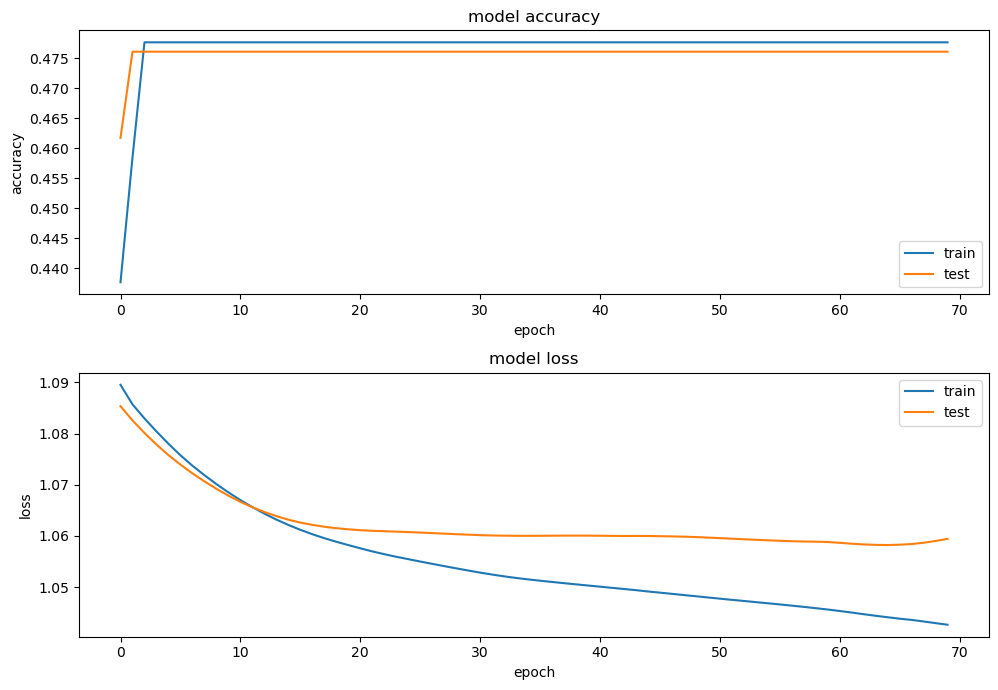

In [238]:
result_ind_train,result_ind_test = nn_report(y_train_encoded,y_test_encoded,history, X_train, X_test, target, result_ind_train,result_ind_test, numclass , model)

### **WT + no feature selection**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank 

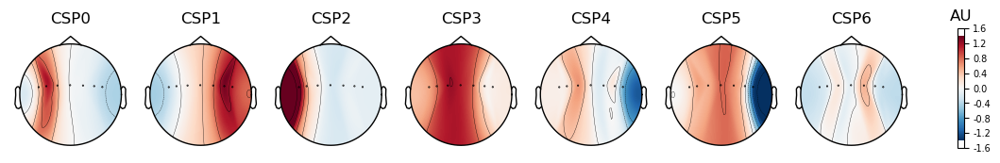

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


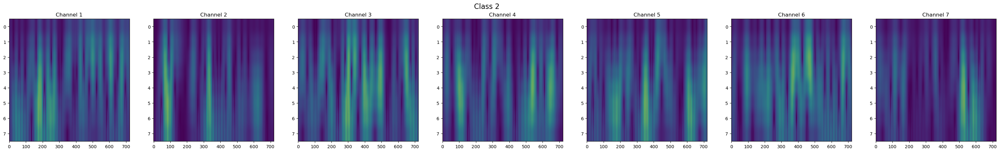

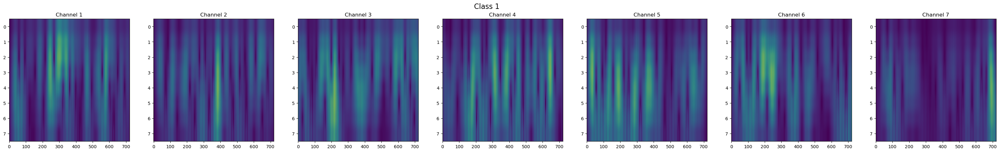

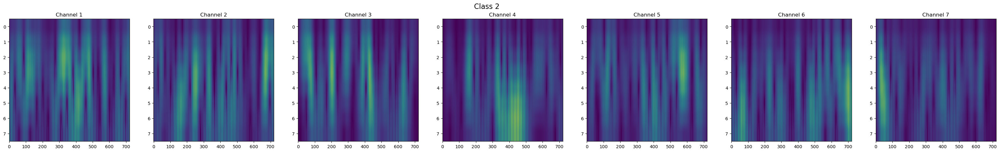

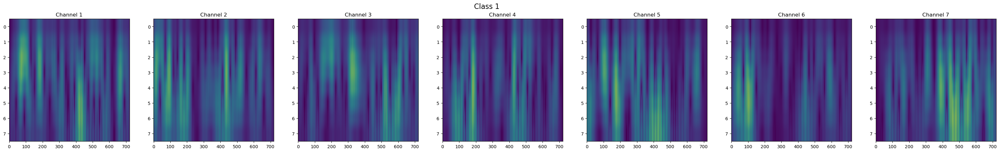

In [239]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [240]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [241]:
result_ind_train,result_ind_test = svm(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00       299
        left       1.00      1.00      1.00       170
       right       1.00      1.00      1.00       157

    accuracy                           1.00       626
   macro avg       1.00      1.00      1.00       626
weighted avg       1.00      1.00      1.00       626

Confusion matrix 
[[299   0   0]
 [  0 170   0]
 [  0   0 157]]
----------------Test set:----------------
Accuracy: 0.39473684210526316
precision: 0.39959493683541697
recall: 0.39473684210526316
f1_score: 0.3970188980204021
              precision    recall  f1-score   support

        rest       0.54      0.53      0.54       199
        left       0.30      0.30      0.30       114
       right       0.23      0.25      0.24       105

In [242]:
result_ind_train,result_ind_test = lda(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.8434504792332268
precision: 0.8433994525090677
recall: 0.8434504792332268
f1_score: 0.8426346654306528
              precision    recall  f1-score   support

        rest       0.84      0.90      0.87       299
        left       0.86      0.82      0.84       170
       right       0.83      0.77      0.80       157

    accuracy                           0.84       626
   macro avg       0.84      0.83      0.83       626
weighted avg       0.84      0.84      0.84       626

Confusion matrix 
[[268  14  17]
 [ 23 139   8]
 [ 27   9 121]]
----------------Test set:----------------
Accuracy: 0.45215311004784686
precision: 0.444559249141602
recall: 0.45215311004784686
f1_score: 0.44783840968480454
              precision    recall  f1-score   support

        rest       0.56      0.60      0.58       199
        left       0.37      0.35      0.36       114
       right   

In [243]:
result_ind_train,result_ind_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00       299
        left       1.00      1.00      1.00       170
       right       1.00      1.00      1.00       157

    accuracy                           1.00       626
   macro avg       1.00      1.00      1.00       626
weighted avg       1.00      1.00      1.00       626

Confusion matrix 
[[299   0   0]
 [  0 170   0]
 [  0   0 157]]
----------------Test set:----------------
Accuracy: 0.41626794258373206
precision: 0.41338619507883806
recall: 0.41626794258373206
f1_score: 0.4143741836182641
              precision    recall  f1-score   support

        rest       0.56      0.58      0.57       199
        left       0.34      0.30      0.32       114
       right       0.23      0.24      0.23       105

    accuracy                      

In [244]:
result_ind_train,result_ind_test = naive(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.5910543130990416
precision: 0.660919152729162
recall: 0.5910543130990416
f1_score: 0.5815435276249586
              precision    recall  f1-score   support

        rest       0.81      0.40      0.54       299
        left       0.51      0.79      0.62       170
       right       0.53      0.73      0.62       157

    accuracy                           0.59       626
   macro avg       0.62      0.64      0.59       626
weighted avg       0.66      0.59      0.58       626

Confusion matrix 
[[121  99  79]
 [ 15 134  21]
 [ 13  29 115]]
----------------Test set:----------------
Accuracy: 0.3444976076555024
precision: 0.39258244449632007
recall: 0.3444976076555024
f1_score: 0.3451981548480296
              precision    recall  f1-score   support

        rest       0.50      0.27      0.35       199
        left       0.30      0.43      0.35       114
       right       0.28      0.40      0

In [245]:
result_ind_train,result_ind_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_ind_train,result_ind_test)

============ K-Nearest Neighbors (KNN) ============


--------------Training set:--------------
Accuracy: 0.7124600638977636
precision: 0.723677532168718
recall: 0.7124600638977636
f1_score: 0.7020095760063031
              precision    recall  f1-score   support

        rest       0.71      0.87      0.78       299
        left       0.68      0.68      0.68       170
       right       0.81      0.46      0.59       157

    accuracy                           0.71       626
   macro avg       0.73      0.67      0.68       626
weighted avg       0.72      0.71      0.70       626

Confusion matrix 
[[259  31   9]
 [ 47 115   8]
 [ 61  24  72]]
----------------Test set:----------------
Accuracy: 0.38516746411483255
precision: 0.36418265145941203
recall: 0.38516746411483255
f1_score: 0.3704888567842764
              precision    recall  f1-score   support

        rest       0.47      0.56      0.51       199
        left       0.29      0.29      0.29       114
       right       0.24      0.15      0.19       105

    accuracy         

In [246]:
#create model
model = Sequential()
#add model layers
model.add(Dense(128, input_dim=X_train.shape[1], activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_70 (Dense)            (None, 128)               5168256   
                                                                 
 dense_71 (Dense)            (None, 64)                8256      
                                                                 
 dense_72 (Dense)            (None, 32)                2080      
                                                                 
 dense_73 (Dense)            (None, 3)                 99        
                                                                 
Total params: 5,178,691
Trainable params: 5,178,691
Non-trainable params: 0
_________________________________________________________________


In [247]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=50,batch_size = X_train.shape[0])

Epoch 1/50
1/1 [==============================] - 2s 2s/step - loss: 1.9268 - accuracy: 0.3323 - val_loss: 61.5369 - val_accuracy: 0.2727
Epoch 2/50
1/1 [==============================] - 0s 397ms/step - loss: 65.1998 - accuracy: 0.2716 - val_loss: 39.8108 - val_accuracy: 0.4761
Epoch 3/50
1/1 [==============================] - 0s 340ms/step - loss: 41.2871 - accuracy: 0.4776 - val_loss: 31.8119 - val_accuracy: 0.2727
Epoch 4/50
1/1 [==============================] - 0s 388ms/step - loss: 33.3208 - accuracy: 0.2716 - val_loss: 23.1219 - val_accuracy: 0.2512
Epoch 5/50
1/1 [==============================] - 0s 375ms/step - loss: 23.7276 - accuracy: 0.2508 - val_loss: 10.5758 - val_accuracy: 0.4761
Epoch 6/50
1/1 [==============================] - 1s 546ms/step - loss: 10.3648 - accuracy: 0.4776 - val_loss: 6.0288 - val_accuracy: 0.4761
Epoch 7/50
1/1 [==============================] - 0s 349ms/step - loss: 5.7961 - accuracy: 0.4776 - val_loss: 15.1311 - val_accuracy: 0.2727
Epoch 8/50
1

20/20 [==============================] - 10s 497ms/step
--------------Training set:--------------
Accuracy: 0.8466453674121406
precision: 0.8716068591503158
recall: 0.8466453674121406
f1_score: 0.8357272664646322
              precision    recall  f1-score   support

        rest       0.87      0.95      0.91       299
        left       0.99      0.54      0.69       170
       right       0.75      0.99      0.85       157

    accuracy                           0.85       626
   macro avg       0.87      0.82      0.82       626
weighted avg       0.87      0.85      0.84       626

Confusion matrix 
[[284   1  14]
 [ 40  91  39]
 [  2   0 155]]
----------------Test set:----------------
Accuracy: 0.43779904306220097
precision: 0.44195263496868104
recall: 0.43779904306220097
f1_score: 0.4011306421945318
              precision    recall  f1-score   support

        rest       0.57      0.66      0.61       199
        left       0.39      0.06      0.11       114
       right       

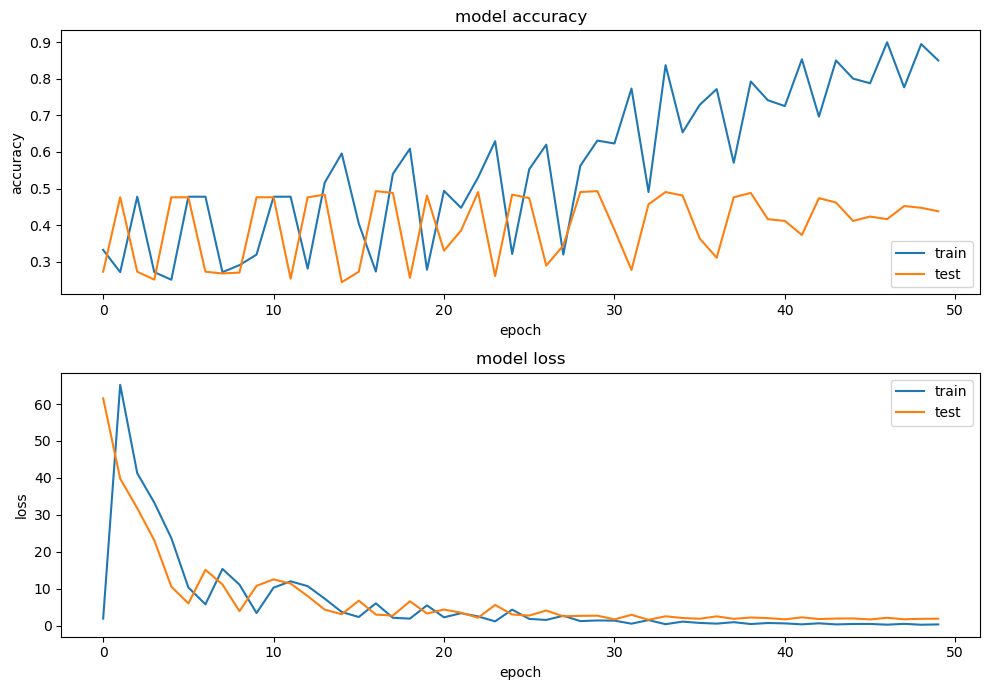

In [248]:
result_ind_train,result_ind_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_ind_train,result_ind_test, numclass , model)

### **WT + mRMR**

Computing rank from data with rank=None
    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None


    Using tolerance 2.6e-06 (2.2e-16 eps * 7 dim * 1.7e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.9e-06 (2.2e-16 eps * 7 dim * 1.3e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.
Computing rank from data with rank=None
    Using tolerance 1.8e-06 (2.2e-16 eps * 7 dim * 1.2e+09  max singular value)
    Estimated rank (mag): 7
    MAG: rank 7 computed from 7 data channels with 0 projectors
Reducing data rank from 7 -> 7
Estimating covariance using EMPIRICAL
Done.


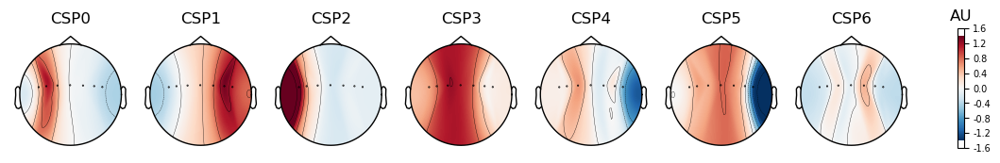

CSP({'component_order': 'mutual_info',
 'cov_est': 'concat',
 'cov_method_params': None,
 'log': None,
 'n_components': 7,
 'norm_trace': False,
 'rank': None,
 'reg': None,
 'transform_into': 'average_power'})


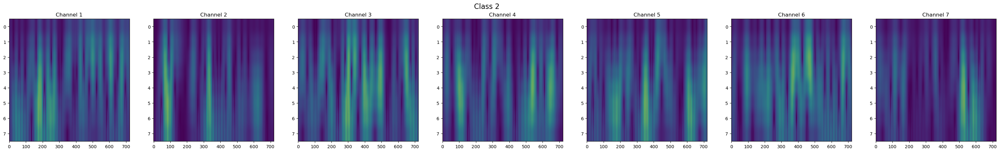

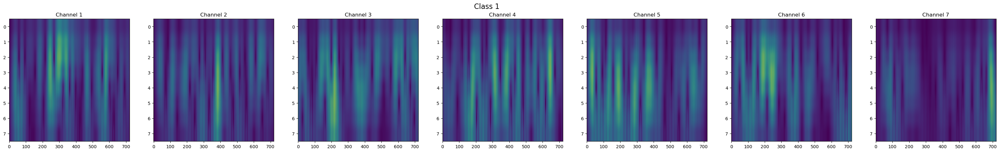

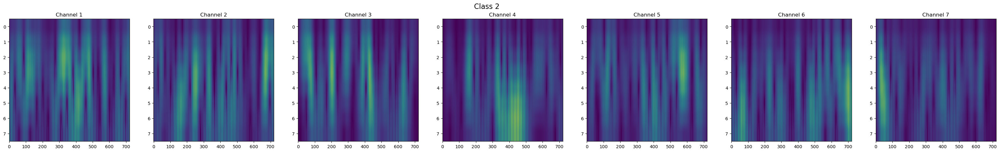

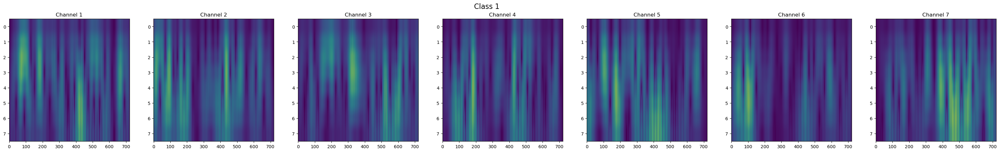

In [249]:
train_data_cwt, data_WT, labels, y = extract_WT(epochs, target , n_component = 7)

In [250]:
X_train, X_test, y_train, y_test = WT_split(data_WT,y,0.40,56)

In [251]:
subset = mRMR_WT(np.array(X_train), np.array(y_train),k= 1000)

100%|██████████| 1000/1000 [57:07<00:00,  3.43s/it]


[2442, 31472, 23174, 1238, 8843, 7049, 34767, 33650, 979, 1487, 5654, 29957, 16773, 1722, 34472, 8860, 34720, 11948, 18198, 12775, 1700, 9557, 6328, 1551, 33658, 2450, 22764, 1701, 23673, 3341, 9564, 4940, 6315, 35488, 32929, 1721, 23895, 16614, 6057, 8868, 1728, 34714, 11688, 7043, 34473, 973, 830, 9556, 4932, 31486, 30678, 2443, 3349, 6427, 9565, 258, 1494, 37816, 12054, 11250, 7764, 32930, 1001, 34481, 9588, 18919, 4933, 12669, 35441, 7696, 2449, 1694, 24617, 32207, 10286, 7050, 31349, 829, 17262, 7036, 280, 8835, 4941, 26238, 1707, 31479, 1493, 16782, 8867, 34437, 8836, 6322, 16622, 3171, 34766, 13845, 252, 33752, 6433, 5645, 1007, 23889, 20368, 33651, 836, 35435, 8140, 7771, 9572, 2793, 2208, 23790, 980, 23674, 5653, 29236, 32200, 18199, 1729, 986, 33760, 38537, 766, 7154, 14566, 9589, 26952, 12048, 16053, 8799, 517, 23896, 33659, 2786, 6975, 34428, 9581, 6321, 34773, 1550, 8828, 1714, 24931, 1953, 12663, 8122, 26511, 7147, 274, 29516, 9580, 17477, 3342, 22756, 7056, 4949, 30679, 

In [252]:
X_train = X_train[subset]
X_test = X_test[subset]

In [253]:
result_ind_train,result_ind_test = svm(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test, kernel='linear',gamma = 'auto')

============ Support Vector Machine (SVM) kernel(linear) gamma(auto) ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00       299
        left       1.00      1.00      1.00       170
       right       1.00      1.00      1.00       157

    accuracy                           1.00       626
   macro avg       1.00      1.00      1.00       626
weighted avg       1.00      1.00      1.00       626

Confusion matrix 
[[299   0   0]
 [  0 170   0]
 [  0   0 157]]
----------------Test set:----------------
Accuracy: 0.42822966507177035
precision: 0.42457798272544744
recall: 0.42822966507177035
f1_score: 0.42618508032743874
              precision    recall  f1-score   support

        rest       0.54      0.55      0.54       199
        left       0.34      0.35      0.35       114
       right       0.30      0.28      0.29       10

In [254]:
result_ind_train,result_ind_test = lda(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ Linear Discriminant Analysis (LDA) ============
--------------Training set:--------------
Accuracy: 0.9888178913738019
precision: 0.988864722099009
recall: 0.9888178913738019
f1_score: 0.9888311732028511
              precision    recall  f1-score   support

        rest       1.00      0.99      0.99       299
        left       0.98      0.98      0.98       170
       right       0.99      0.99      0.99       157

    accuracy                           0.99       626
   macro avg       0.99      0.99      0.99       626
weighted avg       0.99      0.99      0.99       626

Confusion matrix 
[[296   3   0]
 [  1 167   2]
 [  0   1 156]]
----------------Test set:----------------
Accuracy: 0.41148325358851673
precision: 0.4213654532168889
recall: 0.41148325358851673
f1_score: 0.4147880734492896
              precision    recall  f1-score   support

        rest       0.55      0.50      0.52       199
        left       0.33      0.40      0.37       114
       right    

In [255]:
result_ind_train,result_ind_test = logistic_regression(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ logistic_regression ============
--------------Training set:--------------
Accuracy: 1.0
precision: 1.0
recall: 1.0
f1_score: 1.0
              precision    recall  f1-score   support

        rest       1.00      1.00      1.00       299
        left       1.00      1.00      1.00       170
       right       1.00      1.00      1.00       157

    accuracy                           1.00       626
   macro avg       1.00      1.00      1.00       626
weighted avg       1.00      1.00      1.00       626

Confusion matrix 
[[299   0   0]
 [  0 170   0]
 [  0   0 157]]
----------------Test set:----------------
Accuracy: 0.4258373205741627
precision: 0.4342008276218803
recall: 0.4258373205741627
f1_score: 0.42907524720145057
              precision    recall  f1-score   support

        rest       0.57      0.53      0.55       199
        left       0.32      0.37      0.34       114
       right       0.31      0.30      0.30       105

    accuracy                        

In [256]:
result_ind_train,result_ind_test = naive(X_train, X_test, y_train, y_test, target, result_ind_train,result_ind_test)

============ naive bayes ============
--------------Training set:--------------
Accuracy: 0.5
precision: 0.5722837287500493
recall: 0.5
f1_score: 0.49850355077790864
              precision    recall  f1-score   support

        rest       0.71      0.38      0.50       299
        left       0.39      0.74      0.51       170
       right       0.51      0.46      0.49       157

    accuracy                           0.50       626
   macro avg       0.54      0.53      0.50       626
weighted avg       0.57      0.50      0.50       626

Confusion matrix 
[[115 131  53]
 [ 27 125  18]
 [ 20  64  73]]
----------------Test set:----------------
Accuracy: 0.35645933014354064
precision: 0.41979673970717485
recall: 0.35645933014354064
f1_score: 0.3461683887634936
              precision    recall  f1-score   support

        rest       0.54      0.24      0.33       199
        left       0.30      0.61      0.40       114
       right       0.32      0.31      0.32       105

    accurac

In [257]:
result_ind_train,result_ind_test = knn(X_train.to_numpy(), X_test.to_numpy(), y_train, y_test, target, result_ind_train,result_ind_test)

============ K-Nearest Neighbors (KNN) ============
--------------Training set:--------------
Accuracy: 0.7188498402555911
precision: 0.7336960272934613
recall: 0.7188498402555911
f1_score: 0.7055195496729043
              precision    recall  f1-score   support

        rest       0.68      0.92      0.78       299
        left       0.80      0.61      0.69       170
       right       0.76      0.46      0.57       157

    accuracy                           0.72       626
   macro avg       0.75      0.66      0.68       626
weighted avg       0.73      0.72      0.71       626

Confusion matrix 
[[274   9  16]
 [ 59 104   7]
 [ 68  17  72]]
----------------Test set:----------------
Accuracy: 0.4138755980861244
precision: 0.3875332562857499
recall: 0.4138755980861244
f1_score: 0.39358761510110435
              precision    recall  f1-score   support

        rest       0.48      0.62      0.55       199
        left       0.35      0.27      0.31       114
       right       0.25  

In [258]:
#create model
model = Sequential()
#add model layers
model.add(Dense(64, input_dim=len(subset), activation='relu'))
model.add(Dense(32, activation='relu'))
model.add(Dense(16, activation='relu'))
model.add(Dense(len(target), activation='softmax'))

model.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_74 (Dense)            (None, 64)                64064     
                                                                 
 dense_75 (Dense)            (None, 32)                2080      
                                                                 
 dense_76 (Dense)            (None, 16)                528       
                                                                 
 dense_77 (Dense)            (None, 3)                 51        
                                                                 
Total params: 66,723
Trainable params: 66,723
Non-trainable params: 0
_________________________________________________________________


In [259]:
y_train_encoded,y_test_encoded,history,model = nn_fit(X_train, X_test, y_train, y_test, model=model, epochs=80,batch_size = X_train.shape[0])

Epoch 1/80
1/1 [==============================] - 1s 1s/step - loss: 2.4431 - accuracy: 0.3275 - val_loss: 1.3243 - val_accuracy: 0.3254
Epoch 2/80
1/1 [==============================] - 0s 111ms/step - loss: 1.2739 - accuracy: 0.2987 - val_loss: 1.1941 - val_accuracy: 0.3445
Epoch 3/80
1/1 [==============================] - 0s 138ms/step - loss: 1.1255 - accuracy: 0.3403 - val_loss: 1.2085 - val_accuracy: 0.3469
Epoch 4/80
1/1 [==============================] - 0s 68ms/step - loss: 1.0870 - accuracy: 0.3722 - val_loss: 1.1276 - val_accuracy: 0.4306
Epoch 5/80
1/1 [==============================] - 0s 107ms/step - loss: 1.0161 - accuracy: 0.4840 - val_loss: 1.1102 - val_accuracy: 0.4498
Epoch 6/80
1/1 [==============================] - 0s 158ms/step - loss: 0.9983 - accuracy: 0.5112 - val_loss: 1.1235 - val_accuracy: 0.4522
Epoch 7/80
1/1 [==============================] - 0s 219ms/step - loss: 0.9664 - accuracy: 0.5335 - val_loss: 1.1788 - val_accuracy: 0.4354
Epoch 8/80
1/1 [========

20/20 [==============================] - 2s 94ms/step
--------------Training set:--------------
Accuracy: 0.9281150159744409
precision: 0.9281927733668822
recall: 0.9281150159744409
f1_score: 0.9275459034831083
              precision    recall  f1-score   support

        rest       0.91      0.95      0.93       299
        left       0.90      0.84      0.87       170
       right       0.99      0.99      0.99       157

    accuracy                           0.93       626
   macro avg       0.94      0.92      0.93       626
weighted avg       0.93      0.93      0.93       626

Confusion matrix 
[[284  15   0]
 [ 27 142   1]
 [  2   0 155]]
----------------Test set:----------------
Accuracy: 0.46172248803827753
precision: 0.4526907761760882
recall: 0.46172248803827753
f1_score: 0.45640103120206793
              precision    recall  f1-score   support

        rest       0.56      0.61      0.58       199
        left       0.38      0.38      0.38       114
       right       0.

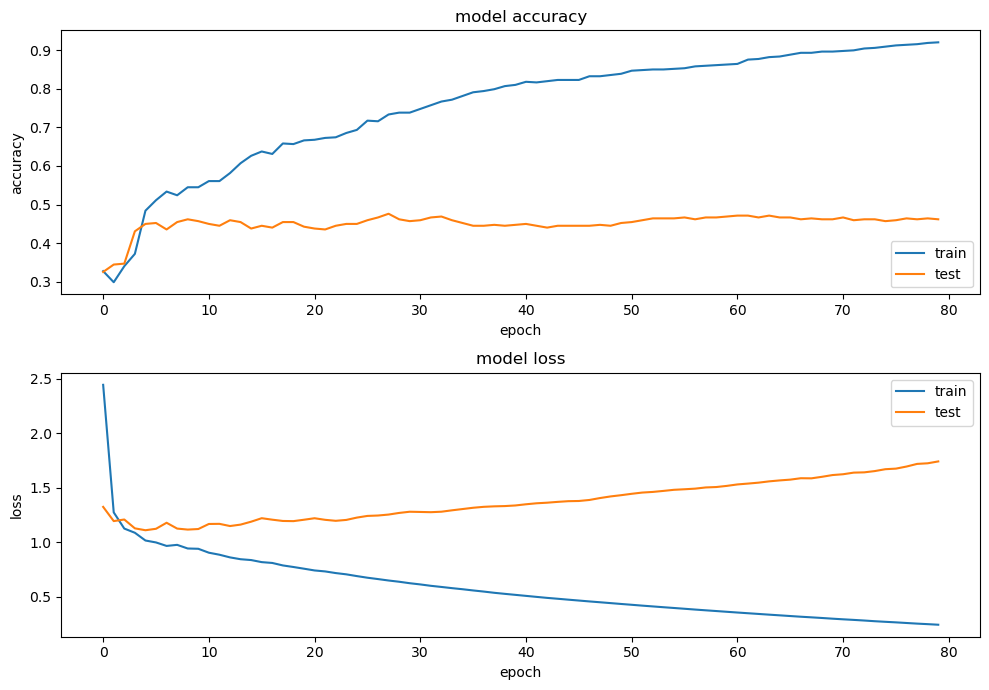

In [260]:
result_ind_train,result_ind_test = nn_report(y_train_encoded,y_test_encoded,history,X_train, X_test, target, result_ind_train,result_ind_test, numclass , model)

## **Conclusion**

### Result of 3 class (rest right-MI left-MI) : 
Accuracy, Precision, Recall, F1-score

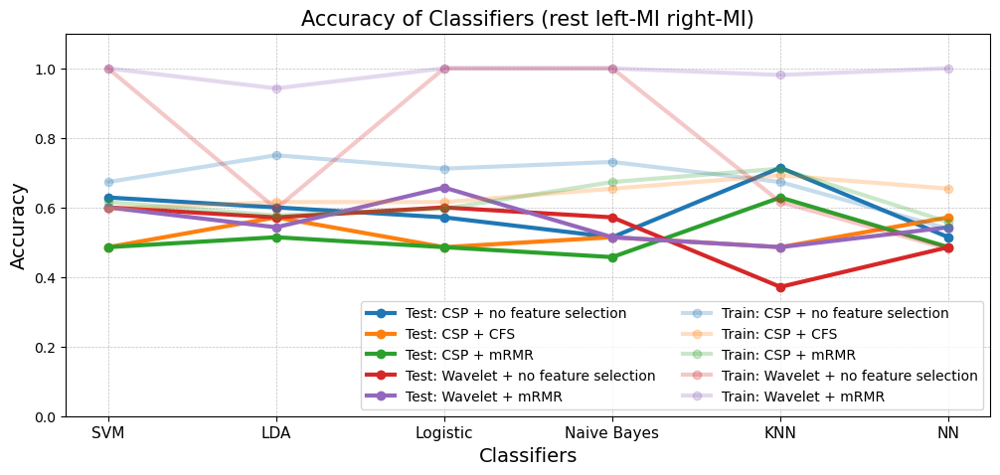

In [286]:
import matplotlib.pyplot as plt
import numpy as np
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_test[0][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_test[0][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_test[0][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_test[0][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_test[0][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_train[0][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.25)
plt.plot(np.array(result_train[0][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.25)
plt.plot(np.array(result_train[0][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.25)
plt.plot(np.array(result_train[0][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.25)
plt.plot(np.array(result_train[0][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.25)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['Test: CSP + no feature selection', 'Test: CSP + CFS', 'Test: CSP + mRMR', 'Test: Wavelet + no feature selection', 'Test: Wavelet + mRMR','Train: CSP + no feature selection', 'Train: CSP + CFS', 'Train: CSP + mRMR', 'Train: Wavelet + no feature selection', 'Train: Wavelet + mRMR'], loc='lower right', ncol=2, fontsize = 10)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

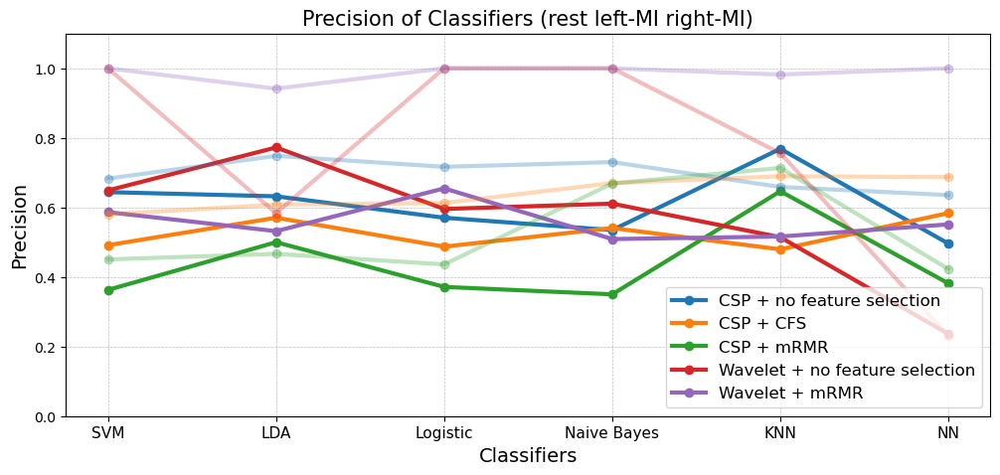

In [262]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_test[1][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_test[1][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_test[1][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_test[1][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_test[1][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_train[1][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_train[1][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_train[1][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_train[1][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_train[1][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

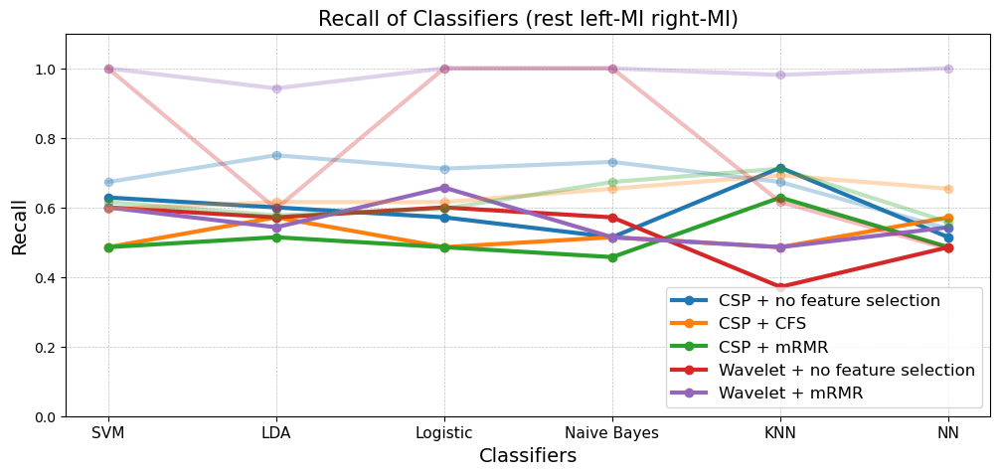

In [263]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_test[2][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_test[2][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_test[2][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_test[2][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_test[2][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_train[2][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_train[2][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_train[2][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_train[2][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_train[2][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

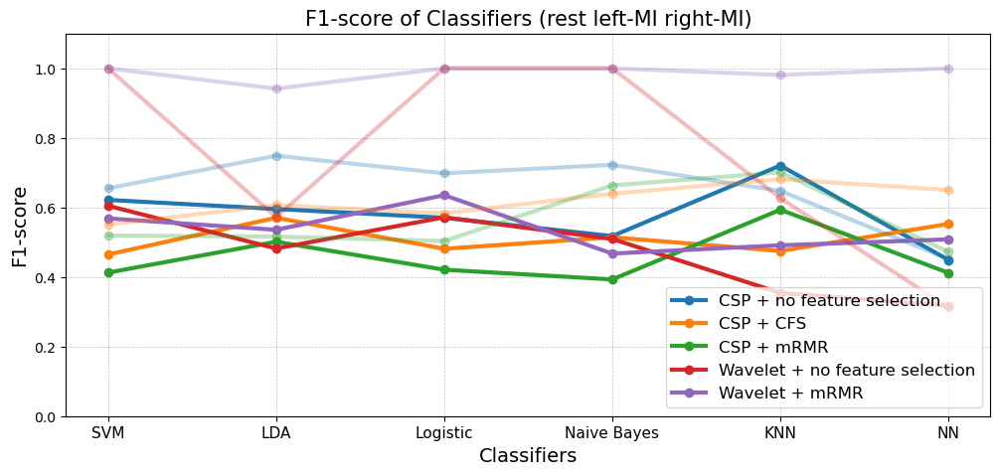

In [264]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_test[3][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_test[3][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_test[3][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_test[3][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_test[3][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_train[3][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_train[3][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_train[3][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_train[3][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_train[3][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (rest left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

-----------------------------------------------------

### Result of 2 class (right-MI left-MI) : 
Accuracy, Precision, Recall, F1-score

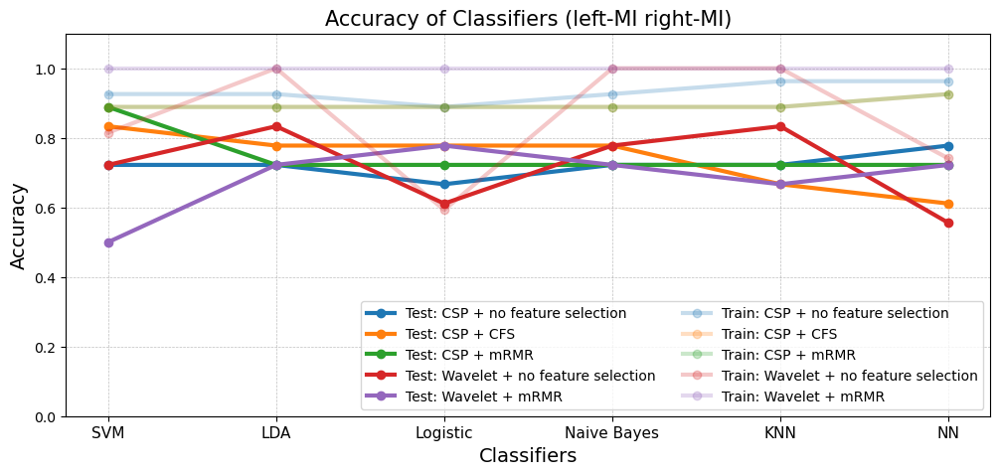

In [285]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi_test[0][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_mi_test[0][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_mi_test[0][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_mi_test[0][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_mi_test[0][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_mi_train[0][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.25)
plt.plot(np.array(result_mi_train[0][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.25)
plt.plot(np.array(result_mi_train[0][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.25)
plt.plot(np.array(result_mi_train[0][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.25)
plt.plot(np.array(result_mi_train[0][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.25)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['Test: CSP + no feature selection', 'Test: CSP + CFS', 'Test: CSP + mRMR', 'Test: Wavelet + no feature selection', 'Test: Wavelet + mRMR','Train: CSP + no feature selection', 'Train: CSP + CFS', 'Train: CSP + mRMR', 'Train: Wavelet + no feature selection', 'Train: Wavelet + mRMR'], loc='lower right', ncol=2, fontsize = 10)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

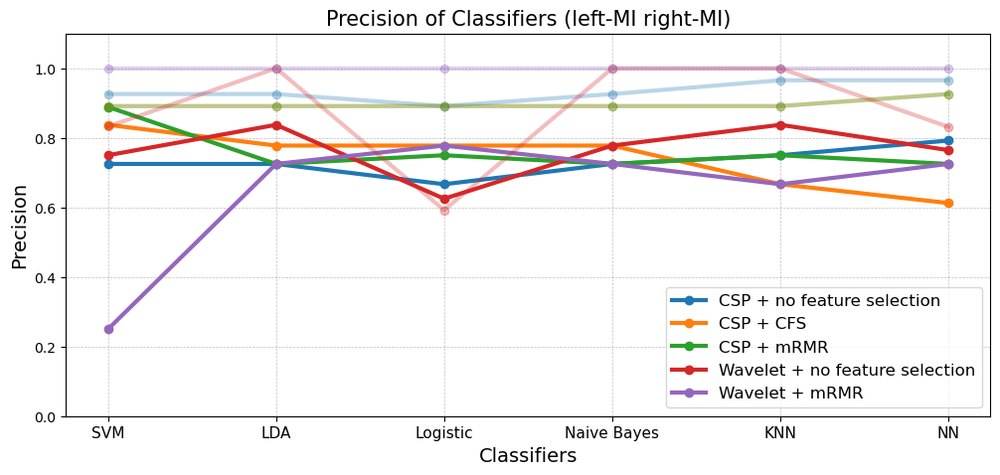

In [266]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi_test[1][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_mi_test[1][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_mi_test[1][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_mi_test[1][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_mi_test[1][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_mi_train[1][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_mi_train[1][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_mi_train[1][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_mi_train[1][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_mi_train[1][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

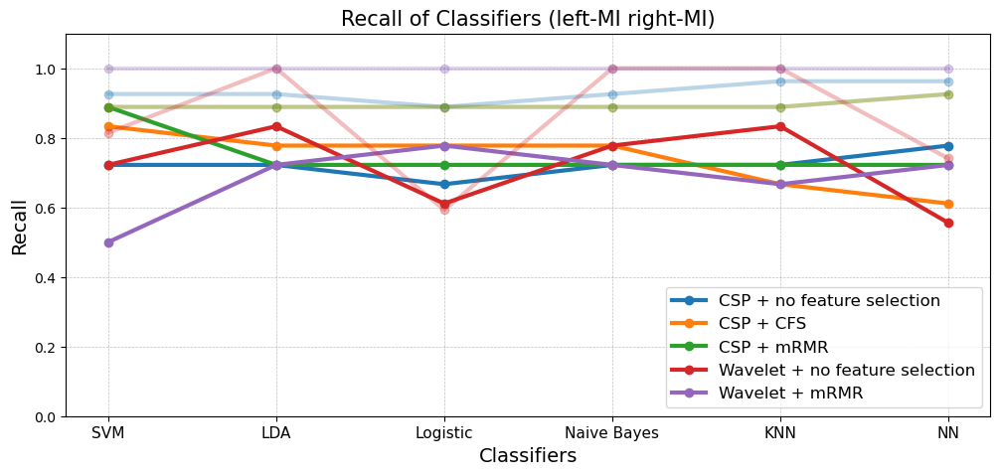

In [267]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi_test[2][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_mi_test[2][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_mi_test[2][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_mi_test[2][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_mi_test[2][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_mi_train[2][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_mi_train[2][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_mi_train[2][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_mi_train[2][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_mi_train[2][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

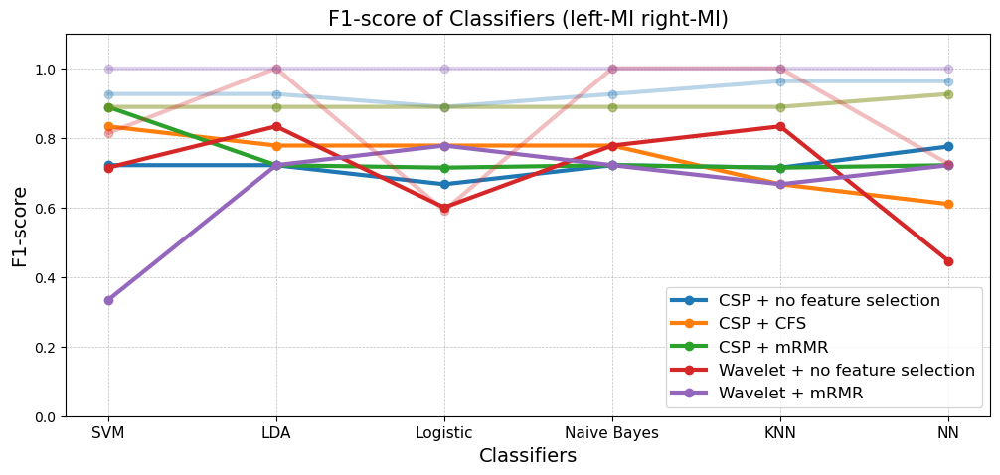

In [268]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_mi_test[3][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_mi_test[3][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_mi_test[3][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_mi_test[3][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_mi_test[3][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_mi_train[3][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_mi_train[3][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_mi_train[3][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_mi_train[3][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_mi_train[3][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (left-MI right-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

-------------------------------------------------------

### Result of 2 class (non-MI MI) : 
Accuracy, Precision, Recall, F1-score

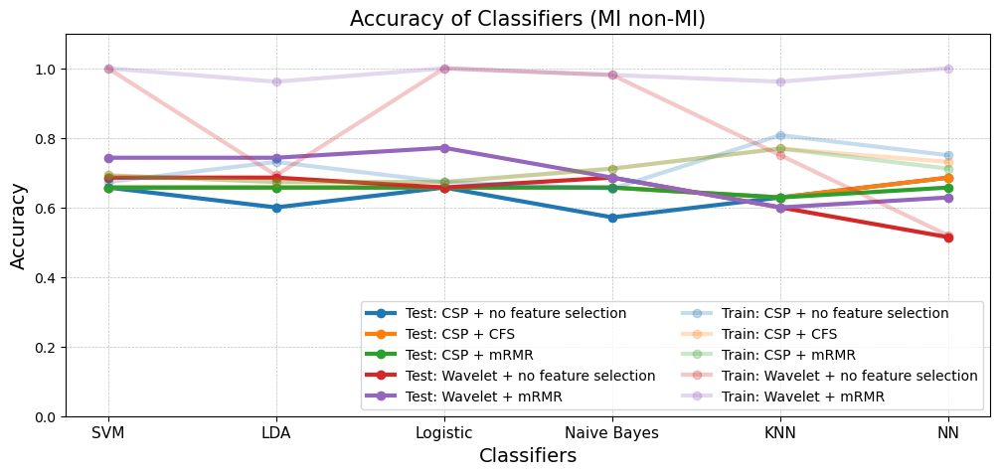

In [284]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi_test[0][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_nonmi_test[0][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_nonmi_test[0][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_nonmi_test[0][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_nonmi_test[0][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_nonmi_train[0][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.25)
plt.plot(np.array(result_nonmi_train[0][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.25)
plt.plot(np.array(result_nonmi_train[0][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.25)
plt.plot(np.array(result_nonmi_train[0][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.25)
plt.plot(np.array(result_nonmi_train[0][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.25)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['Test: CSP + no feature selection', 'Test: CSP + CFS', 'Test: CSP + mRMR', 'Test: Wavelet + no feature selection', 'Test: Wavelet + mRMR','Train: CSP + no feature selection', 'Train: CSP + CFS', 'Train: CSP + mRMR', 'Train: Wavelet + no feature selection', 'Train: Wavelet + mRMR'], loc='lower right', ncol=2, fontsize = 10)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

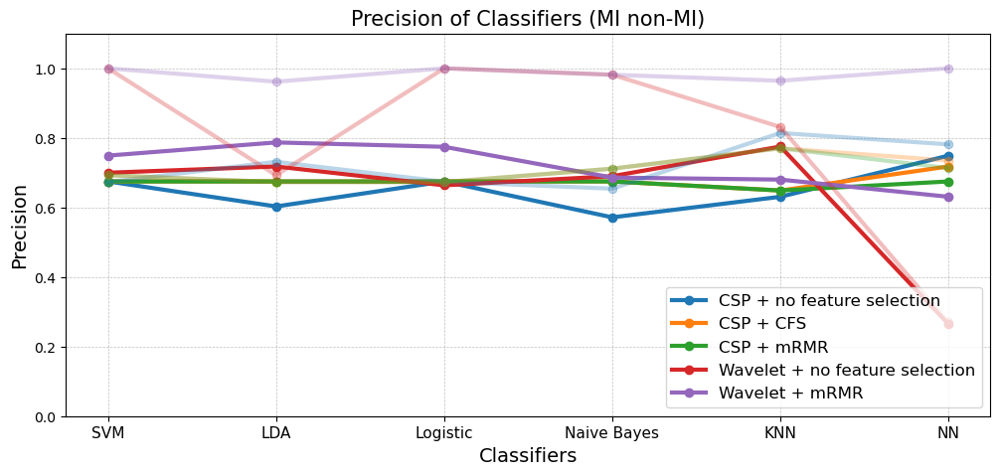

In [270]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi_test[1][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_nonmi_test[1][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_nonmi_test[1][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_nonmi_test[1][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_nonmi_test[1][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_nonmi_train[1][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[1][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[1][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[1][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[1][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

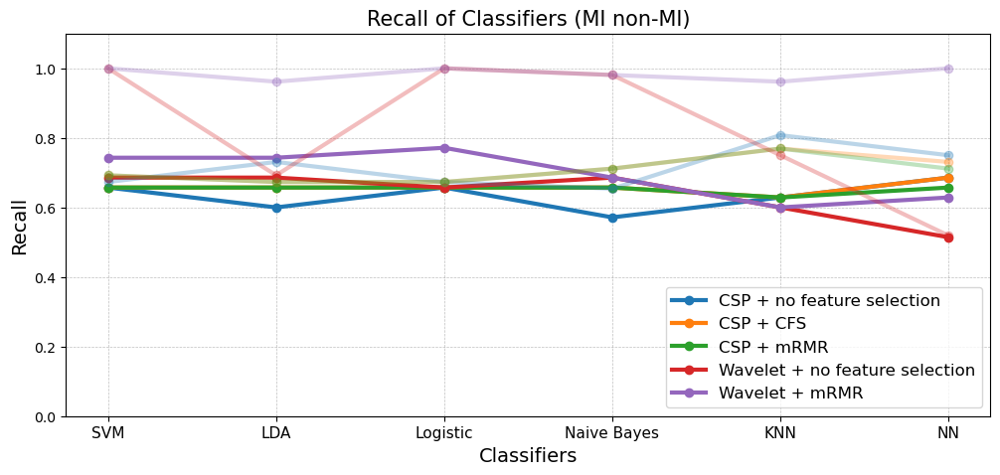

In [271]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi_test[2][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_nonmi_test[2][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_nonmi_test[2][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_nonmi_test[2][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_nonmi_test[2][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_nonmi_train[2][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[2][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[2][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[2][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[2][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

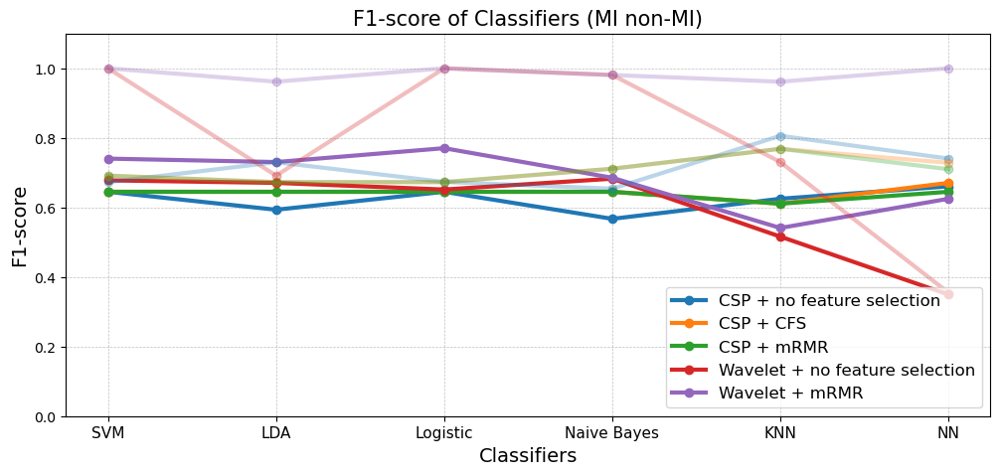

In [272]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_nonmi_test[3][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_nonmi_test[3][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_nonmi_test[3][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_nonmi_test[3][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_nonmi_test[3][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_nonmi_train[3][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[3][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[3][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[3][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_nonmi_train[3][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (MI non-MI)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

------------------------------

### Result of 3 class (rest right-MI left-MI) of 60 participant: 
Accuracy, Precision, Recall, F1-score

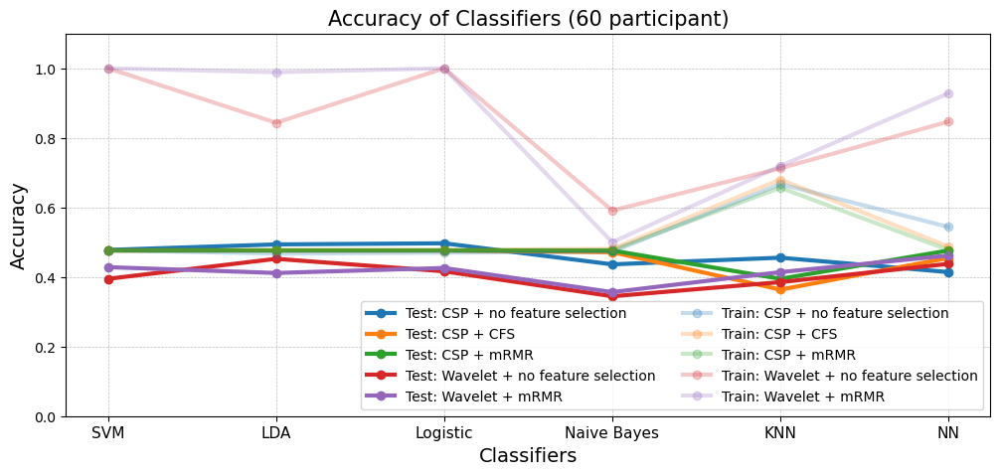

In [283]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_ind_test[0][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_ind_test[0][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_ind_test[0][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_ind_test[0][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_ind_test[0][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_ind_train[0][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.25)
plt.plot(np.array(result_ind_train[0][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.25)
plt.plot(np.array(result_ind_train[0][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.25)
plt.plot(np.array(result_ind_train[0][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.25)
plt.plot(np.array(result_ind_train[0][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.25)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Accuracy', fontsize = 14)
plt.title('Accuracy of Classifiers (60 participant)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['Test: CSP + no feature selection', 'Test: CSP + CFS', 'Test: CSP + mRMR', 'Test: Wavelet + no feature selection', 'Test: Wavelet + mRMR','Train: CSP + no feature selection', 'Train: CSP + CFS', 'Train: CSP + mRMR', 'Train: Wavelet + no feature selection', 'Train: Wavelet + mRMR'], loc='lower right', ncol=2, fontsize = 10)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

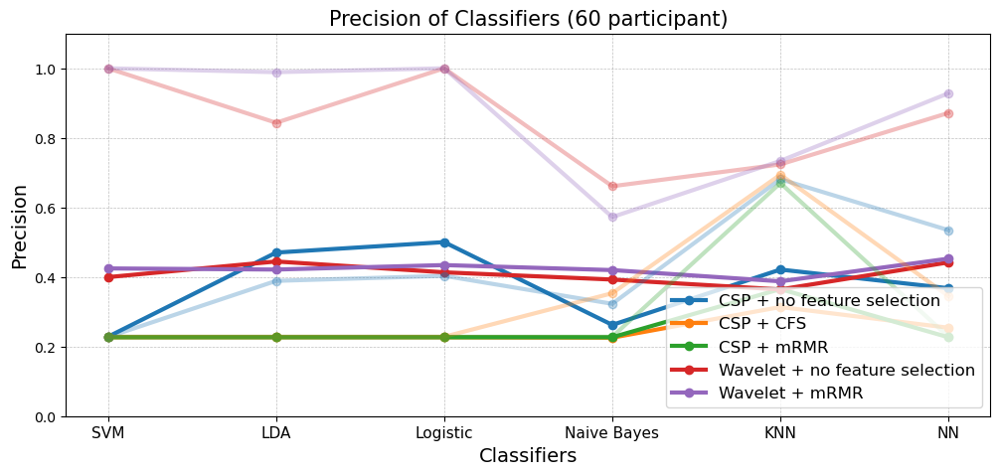

In [274]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_ind_test[1][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_ind_test[1][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_ind_test[1][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_ind_test[1][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_ind_test[1][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_ind_train[1][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_ind_train[1][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_ind_train[1][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_ind_train[1][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_ind_train[1][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Precision', fontsize = 14)
plt.title('Precision of Classifiers (60 participant)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

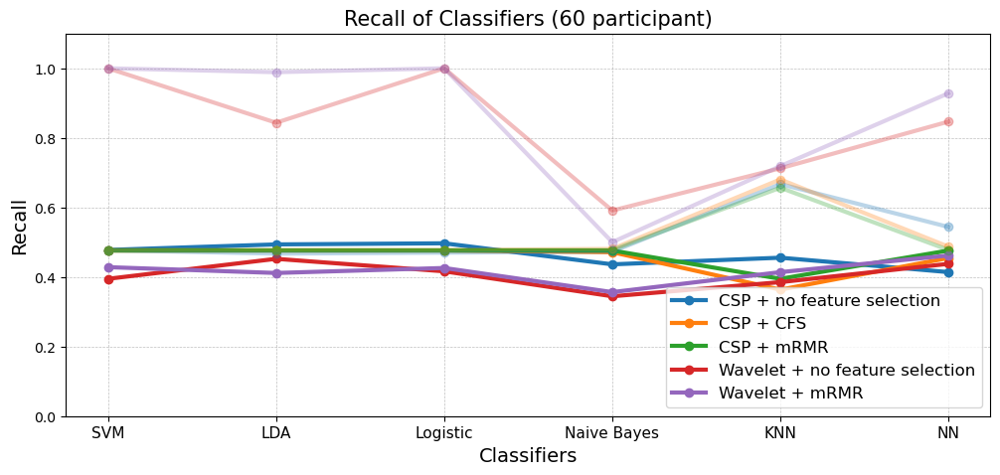

In [275]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_ind_test[2][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_ind_test[2][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_ind_test[2][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_ind_test[2][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_ind_test[2][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_ind_train[2][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_ind_train[2][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_ind_train[2][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_ind_train[2][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_ind_train[2][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('Recall', fontsize = 14)
plt.title('Recall of Classifiers (60 participant)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()

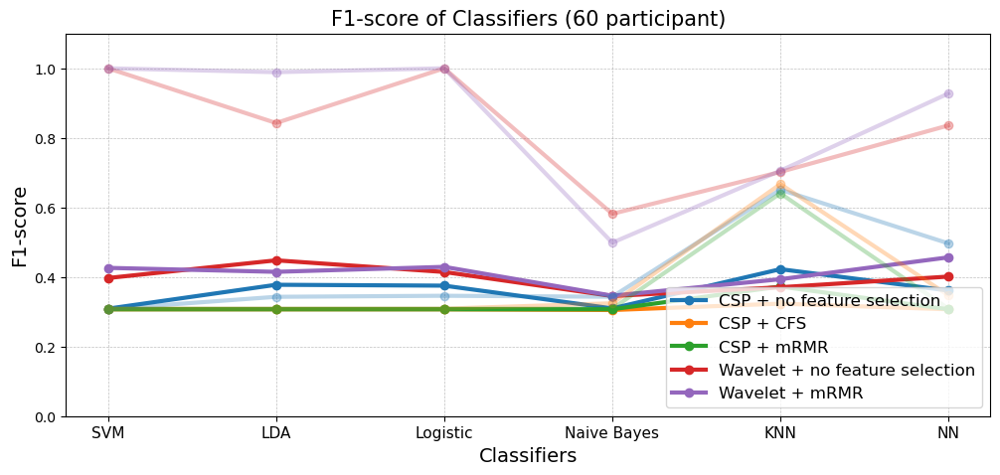

In [276]:
head = ['SVM','LDA','Logistic','Naive Bayes','KNN','NN']

plt.figure(figsize=(12,5))
plt.plot(np.array(result_ind_test[3][0:6]),'o-',linewidth=3, color='tab:blue')
plt.plot(np.array(result_ind_test[3][6:12]),'o-',linewidth=3, color='tab:orange')
plt.plot(np.array(result_ind_test[3][12:18]),'o-',linewidth=3, color='tab:green')
plt.plot(np.array(result_ind_test[3][18:24]),'o-',linewidth=3, color='tab:red')
plt.plot(np.array(result_ind_test[3][24:30]),'o-',linewidth=3, color='tab:purple')
plt.plot(np.array(result_ind_train[3][0:6]),'o-',linewidth=3, color='tab:blue', alpha = 0.3)
plt.plot(np.array(result_ind_train[3][6:12]),'o-',linewidth=3, color='tab:orange', alpha = 0.3)
plt.plot(np.array(result_ind_train[3][12:18]),'o-',linewidth=3, color='tab:green', alpha = 0.3)
plt.plot(np.array(result_ind_train[3][18:24]),'o-',linewidth=3, color='tab:red', alpha = 0.3)
plt.plot(np.array(result_ind_train[3][24:30]),'o-',linewidth=3, color='tab:purple', alpha = 0.3)
plt.xlabel('Classifiers', fontsize = 14)
plt.ylabel('F1-score', fontsize = 14)
plt.title('F1-score of Classifiers (60 participant)', fontsize = 15)
plt.ylim(0,1.1)
plt.xticks(np.arange(6), head, fontsize = 11)
plt.legend(['CSP + no feature selection', 'CSP + CFS', 'CSP + mRMR', 'Wavelet + no feature selection', 'Wavelet + mRMR'], loc='lower right', fontsize = 12)

plt.grid(which='major',linestyle='--', linewidth=0.5, color='gray', alpha=0.5)
plt.show()